## Подготовка

In [ ]:
from IPython.display import Image
import kagglehub
from pathlib import Path
import cv2
import random
from ultralytics import YOLO
from tqdm import tqdm
import numpy as np
import torch
import matplotlib.pyplot as plt
import json
from collections import defaultdict, Counter
import squarify
from google.colab.patches import cv2_imshow
import albumentations as A
from ultralytics.data.augment import Albumentations as UltralyticsAlbumentations
from ultralytics.models.yolo.detect.train import DetectionTrainer
import pandas as pd
from functools import partial
import zipfile
import shutil
import time

# чтобы OpenCV не ломал многопоточность батчей
cv2.setNumThreads(0)

# воспроизводимость ноутбука
MANUAL_SEED = 42
random.seed(MANUAL_SEED)
np.random.seed(MANUAL_SEED)
torch.manual_seed(MANUAL_SEED)
torch.cuda.manual_seed_all(MANUAL_SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

NUM_WORKERS = 2
# PIN_MEMORY = True
PIN_MEMORY = False
BATCH_SIZE = 16
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

!mkdir -p /content/zip_saves

In [ ]:
# KAGGLE_USERNAME=...
# KAGGLE_KEY=...

!curl -L --progress-bar -u $KAGGLE_USERNAME:$KAGGLE_KEY \
   "https://www.kaggle.com/api/v1/datasets/download/aliabdelmenam/rdd-2022" \
   -o "/content/rdd-2022.zip"

######################################################################## 100.0%


In [ ]:
path = "/content/data"
!unzip -q /content/rdd-2022.zip -d "{path}"

In [ ]:
path = "/content/data"
MAIN_DIRECTORY = Path(path) / 'RDD_SPLIT'
TRAIN_DIRECTORY = MAIN_DIRECTORY / 'train'
TEST_DIRECTORY = MAIN_DIRECTORY / 'test'
VAL_DIRECTORY = MAIN_DIRECTORY / 'val'

In [ ]:
# имена классов
names = ['longitudinal crack', 'transverse crack',
         'alligator crack', 'other corruption', 'pothole']

**Структура датасета**


```
RDD_SPLIT/
├── test/
│   ├── images/
│   │   ├── China_Drone_000008.jpg
│   │   ├── ...
│   │   ├── China_MotorBike_001159.jpg
│   │   ├── ...
│   │   ├── Czech_000450.jpg
│   │   └── ...
│   ├── labels/
│   │   ├── China_Drone_000008.txt
│   └── └── ...
├── train/
│   ├── images/
│   └── labels/
├── val/
│   ├── images/
└── └── labels/
```

**Структура файлов label**

Файлы имеют такое же имя, как и у соответствующих им изображений.

Используется YOLO-формат разметки:

`class_number x y w h`

- x, y - координаты центра бокса относительно изображения
- w, h - ширина и высота бокса относительно изображения

## Utils

Раздел содержит различные вспомогательные функции.

In [ ]:
def read_image_size(img_path):
    img = cv2.imread(img_path)
    return img.shape[1], img.shape[0]

def xywh2xyxy(bbox, size, normalized_input=True, normalized_output=True):
    '''
    Parameters:
        bbox -> numpy.array, size (4,), yolo координаты;
        size -> Tuple, size(2), размер изображения (w, h);
        normalized_input -> подается ли рамка в нормализованном виде;
        normalized_output -> выдавать ли рамку в нормализованном виде.
    Returns
        numpy.array, size (4,), pascal_voc / albumentations
            координаты (в зависимости от normalized).
    '''
    if normalized_input:
        x_c, y_c, w, h = bbox * (size * 2)
    x_min, y_min = x_c - w / 2, y_c - h / 2
    x_max, y_max = x_c + w / 2, y_c + h / 2
    new_bbox = np.array([x_min, y_min, x_max, y_max], dtype=np.float32)
    if normalized_output:
        new_bbox /= (size * 2)
    return new_bbox

def xyxy2xywh(bbox, size, normalized_input=True, normalized_output=True):
    """
    Обратное преобразование к xywh2xyxy.

    Parameters:
        bbox -> numpy.array, размер (4,), координаты x1,y1,x2,y2
        size -> Tuple, размер изображения (w, h)
        normalized_input -> координаты подаются в нормализованном виде (0..1)
        normalized_output -> возвращать ли результат в нормализованном виде (0..1)

    Returns:
        numpy.array, size (4,), формат YOLO (x_center, y_center, w, h)
    """
    if normalized_input:
        bbox = bbox * (size * 2)
    x1, y1, x2, y2 = bbox
    w, h = x2 - x1, y2 - y1
    x_c, y_c = x1 + w / 2, y1 + h / 2
    new_bbox = np.array([x_c, y_c, w, h], dtype=np.float32)
    if normalized_output:
        new_bbox /= (size * 2)

    return new_bbox

def parse_txt(txt_path, img_size):
    """
    YOLO txt format: class_id cx cy w h (normalized 0..1)
    Возвращает список bbox в формате (class, x1, y1, x2, y2).
    """
    boxes = []
    with open(txt_path, 'r', encoding='utf-8') as f:
        for line in f:
            parts = line.strip().split()
            if not parts:
                continue
            cls = float(parts[0])
            old_coords = np.array(list(map(float, parts[1:5])))
            new_coords = xywh2xyxy(old_coords, img_size, normalized_output=False)
            new_box = np.hstack([cls, new_coords])
            boxes.append(new_box)
    if len(boxes) > 0:
        return np.vstack(boxes)
    else:
        return np.empty((0, 5), dtype=np.float32)

def load_dataset_from_folders(root_images_dir, root_ann_dir):
    """
    Сканирует папку с изображениями и папку с аннотациями.
    Parameters:
        root_images_dir -> директория с изображениями;
        root_ann_dir -> директория с аннотациями.
    Returns:
        Список записей dict {file_name, width, height, boxes: np.array([(class, x1,y1,x2,y2), ...])}
    """
    images = []
    img_paths = []
    root_images_dir = Path(root_images_dir)
    root_labels_dir = Path(root_ann_dir)
    img_paths = sorted(root_images_dir.iterdir())

    results = []
    for img_path in img_paths:
        fname = img_path.name
        w, h = read_image_size(img_path)
        entry = {'file_name': fname, 'path': str(img_path), 'width': w, 'height': h, 'boxes': []}

        txt_path = root_labels_dir / img_path.with_suffix('.txt').name
        boxes = parse_txt(txt_path, (entry['width'], entry['height']))
        entry['boxes'] = boxes
        results.append(entry)

    return results

In [ ]:
def save_records_to_json(records, out_path):
    serializable = []
    for r in records:
        item = r.copy()
        item["boxes"] = r["boxes"].tolist()
        serializable.append(item)

    with open(out_path, "w", encoding="utf-8") as f:
        json.dump(serializable, f, ensure_ascii=False, indent=4)

In [ ]:
def load_records_from_json(in_path):
    """
    Загружает записи из JSON файла, преобразуя списки обратно в NumPy массивы для "boxes".
    Parameters:
        in_path (str): Путь к JSON файлу.
    Returns:
        list: Список словарей.
    """
    loaded_serializable = []
    with open(in_path, "r", encoding="utf-8") as f:
        loaded_serializable = json.load(f)

    records = []
    for item in loaded_serializable:
        if "boxes" in item and isinstance(item["boxes"], list):
            item["boxes"] = np.array(item["boxes"])
        records.append(item)

    return records

In [ ]:
def plot_size_pies(train_dict, test_dict, val_dict, cmap_name="Pastel1", min_pct_label=3):
    fig, axes = plt.subplots(1, 3, figsize=(20, 6))

    datasets = [
        ("Train", train_dict),
        ("Test",  test_dict),
        ("Val",   val_dict),
    ]

    cmap = plt.get_cmap(cmap_name)

    for ax, (title, data) in zip(axes, datasets):
        labels = list(data.keys())
        sizes  = np.array(list(data.values()), dtype=float)
        total = sizes.sum()
        pct = sizes / total * 100

        colors = [cmap(i % cmap.N) for i in range(len(labels))]

        def autopct_func(p):
            return f"{p:.1f}%" if p >= min_pct_label else ""

        wedges, _, _ = ax.pie(
            sizes,
            labels=[str(l) if p >= min_pct_label else "" for l, p in zip(labels, pct)],
            autopct=autopct_func,
            colors=colors,
            startangle=90
        )

        ax.set_title(title)

    plt.tight_layout()
    plt.show()

In [ ]:
def get_countries_vehicles(records):
    countries = {}
    vehicles = {}
    for record in records:
        name = record['file_name'].split('_')[:-1]
        # ---
        if len(name) == 2 and name[0] == 'United':
            country = " ".join(name[:2])
        else:
            country = name[0]
            if len(name) == 2:
                vehicle = name[1]

                if vehicle not in vehicles:
                    vehicles[vehicle] = 1
                else:
                    vehicles[vehicle] += 1
        # ---
        if country not in countries:
            countries[country] = 1
        else:
            countries[country] += 1

    return countries, vehicles

def plot_pies(data, title):
    '''
    Строит круговые графики распределений по странам и по видам транспорта.
    '''
    d_countries, d_transport = data
    labels1 = list(d_countries.keys())
    sizes1 = list(d_countries.values())

    labels2 = list(d_transport.keys())
    sizes2 = list(d_transport.values())

    colors1 = plt.get_cmap("Accent").colors[:len(labels1)]
    colors2 = plt.get_cmap("Pastel1").colors[:len(labels2)]

    plt.figure(figsize=(8, 4))
    plt.suptitle(title, fontsize=16)

    plt.subplot(1, 2, 1)
    plt.pie(sizes1, labels=labels1, autopct='%1.1f%%', colors=colors1)
    plt.title("Распределение по странам")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.pie(sizes2, labels=labels2, autopct='%1.1f%%', colors=colors2)
    plt.title("Распределение по видам транспорта")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

def sum_dicts(list_of_pairs):
    sum_first = defaultdict(int)
    sum_second = defaultdict(int)

    for d1, d2 in list_of_pairs:
        for k, v in d1.items():
            sum_first[k] += v
        for k, v in d2.items():
            sum_second[k] += v

    return dict(sum_first), dict(sum_second)

In [ ]:
def plot_treemap_classes(dataset_records, class_names, title="Class treemap"):
    counts = Counter()
    for rec in dataset_records:
        for cls, *_ in rec['boxes']:
            counts[class_names[int(cls)]] += 1
    labels = list(counts.keys())
    sizes = np.array(list(counts.values()), dtype=float)

    fig, ax = plt.subplots(1,1, figsize=(7,4))

    norm_sizes = sizes / sizes.sum() * 100
    squarify.plot(sizes=norm_sizes, label=[f"{l}\n{int(s)}" for l,s in zip(labels,sizes)], ax=ax, pad=True)
    ax.axis('off')
    ax.set_title(title)

    plt.tight_layout()

In [ ]:
def plot_bar_classes(dataset_records, class_names, title="Class distribution", cmap_name="Accent"):
    """
    Строит barplot распределения классов в процентах.
    Parameters:
        dataset_records -> список dict из load_dataset_from_folders;
        class_names     -> список строк по индексам классов.
    """
    counts = Counter()
    for rec in dataset_records:
        for cls, *_ in rec['boxes']:
            counts[class_names[int(cls)]] += 1

    labels = list(counts.keys())
    values = np.array(list(counts.values()), dtype=float)
    pct = values / values.sum() * 100

    cmap = plt.get_cmap(cmap_name)
    colors = [cmap(i % cmap.N) for i in range(len(labels))]

    plt.figure(figsize=(9, 5))
    bars = plt.bar(labels, pct, color=colors)

    for b, p in zip(bars, pct):
        plt.text(
            b.get_x() + b.get_width() / 2,
            b.get_height(),
            f"{p:.1f}%",
            ha='center',
            va='bottom',
            fontsize=9
        )

    plt.ylabel("Percentage (%)")
    plt.title(title)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

In [ ]:
def plot_bar_classes(dataset_records, class_names, title="Class distribution", cmap_name="Accent"):
    """
    Barplot распределения классов строго в порядке class_names.

    Parameters:
        dataset_records -> список dict из load_dataset_from_folders;
        class_names     -> список строк по индексам классов.
    """
    counts = Counter()
    for rec in dataset_records:
        for cls, *_ in rec['boxes']:
            counts[int(cls)] += 1

    values = np.array([counts[i] if i in counts else 0 for i in range(len(class_names))], dtype=float)
    pct = values / values.sum() * 100 if values.sum() > 0 else np.zeros_like(values)

    cmap = plt.get_cmap(cmap_name)
    colors = [cmap(i % cmap.N) for i in range(len(class_names))]

    plt.figure(figsize=(9, 5))
    bars = plt.bar(class_names, pct, color=colors)

    for b, p in zip(bars, pct):
        plt.text(
            b.get_x() + b.get_width() / 2,
            b.get_height(),
            f"{p:.1f}%" if p > 0 else "",
            ha='center',
            va='bottom',
            fontsize=9
        )

    plt.ylabel("Percentage (%)")
    plt.title(title)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

In [ ]:
def plot_hist_width_height(records, bins=50):
    stats = collect_bbox_stats(records)
    fig, axes = plt.subplots(1,2, figsize=(8,3))
    axes[0].hist(stats['widths'], bins=bins)
    axes[0].set_title("BBox widths (px)")
    axes[0].set_xlabel("width (px)")
    axes[1].hist(stats['heights'], bins=bins)
    axes[1].set_title("BBox heights (px)")
    axes[1].set_xlabel("height (px)")
    plt.tight_layout()

def plot_hist_area(records, bins=50):
    stats = collect_bbox_stats(records)
    fig, ax = plt.subplots(1,1, figsize=(6,3))
    ax.hist(stats['areas'], bins=bins)
    ax.set_title("BBox areas")
    ax.set_xlabel("area")
    plt.tight_layout()

def plot_hist_ratio(records, bins=50):
    stats = collect_bbox_stats(records)
    fig, ax = plt.subplots(1,1, figsize=(6,3))
    ratios = stats['ratios']
    ratios = ratios[np.isfinite(ratios)]
    ax.hist(ratios, bins=bins)
    ax.set_title("BBox aspect ratio (w/h)")
    ax.set_xlabel("w/h")
    plt.tight_layout()

In [ ]:
def show_image_with_boxes(img_path):
    img_path = Path(img_path)
    labels_path = img_path.parent.parent / 'labels' / f"{img_path.stem}.txt"

    img = cv2.imread(str(img_path))
    h, w = img.shape[:2]

    boxes = parse_txt(labels_path, (w, h))

    for box in boxes:
        cls, x1, y1, x2, y2 = box
        cls = int(cls)
        color = (0, 0, 255)
        cv2.rectangle(img, (int(x1), int(y1)), (int(x2), int(y2)), color, 2)

    cv2_imshow(img)

In [ ]:
def bbox_width_height_area_ratio(box):
    _, x1,y1,x2,y2 = box
    w = max(0.0, x2 - x1)
    h = max(0.0, y2 - y1)
    area = w * h
    ratio = w / h if h > 0 else np.nan
    return w, h, area, ratio

def iou(boxA, boxB):
    _, xA1,yA1,xA2,yA2 = boxA
    _, xB1,yB1,xB2,yB2 = boxB
    x_left = max(xA1, xB1)
    y_top = max(yA1, yB1)
    x_right = min(xA2, xB2)
    y_bottom = min(yA2, yB2)
    if x_right <= x_left or y_bottom <= y_top:
        return 0.0
    inter = (x_right - x_left) * (y_bottom - y_top)
    areaA = max(0.0, xA2-xA1) * max(0.0, yA2-yA1)
    areaB = max(0.0, xB2-xB1) * max(0.0, yB2-yB1)
    union = areaA + areaB - inter
    if union <= 0:
        return 0.0
    return inter / union

def collect_bbox_stats(records):
    widths = []
    heights = []
    areas = []
    ratios = []
    centers_x = []
    centers_y = []
    class_list = []
    objs_per_image = []
    for r in records:
        objs_per_image.append(len(r['boxes']))
        for b in r['boxes']:
            cls, x1,y1,x2,y2 = b
            w,h,area,ratio = bbox_width_height_area_ratio(b)
            widths.append(w); heights.append(h); areas.append(area); ratios.append(ratio)
            centers_x.append((x1+x2)/2.0); centers_y.append((y1+y2)/2.0)
            class_list.append(str(cls))
    return {
        'widths': np.array(widths),
        'heights': np.array(heights),
        'areas': np.array(areas),
        'ratios': np.array(ratios),
        'centers_x': np.array(centers_x),
        'centers_y': np.array(centers_y),
        'classes': np.array(class_list),
        'objs_per_image': np.array(objs_per_image)
    }

In [ ]:
def plot_centers_heatmap(records, draw_scatter=True, grid_size=(128,128)):
    """
    Строит тепловую карту центров bounding boxes на изображениях.
    """
    centers = []

    for r in records:
        if r['boxes'].shape[0] == 0:
            continue
        for box in r['boxes']:
            # box = (class, x1, y1, x2, y2)
            _, x1, y1, x2, y2 = box
            cx, cy, _, _ = xyxy2xywh(np.array([x1, y1, x2, y2]), (r['width'], r['height']),
                                     normalized_input=False, normalized_output=True)
            centers.append([cx, cy])

    arr = np.array(centers)
    H, W = grid_size
    heat = np.zeros((H, W), dtype=int)

    # Преобразуем нормализованные координаты в индексы сетки
    xs = (arr[:,0] * (W-1)).astype(int)
    ys = (arr[:,1] * (H-1)).astype(int)

    for xx, yy in zip(xs, ys):
        heat[1- yy, xx] += 1  # row=y, col=x

    fig, ax = plt.subplots(figsize=(6,6))
    im = ax.imshow(heat, origin='lower', interpolation='nearest', aspect='equal',
                   extent=[0.0, 1.0, 1.0, 0.0])
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_title('Heatmap of bbox centers')

    if draw_scatter and len(arr) > 0:
        ax.scatter(arr[:,0], arr[:,1], s=6, c='white', alpha=0.7, edgecolors='k', linewidths=0.2)

    plt.colorbar(im, ax=ax, label='counts')
    plt.tight_layout()

    return arr

In [ ]:
def find_small_boxes(records, min_px=5):
    small_examples = []
    for r in records:
        for cls,x1,y1,x2,y2 in r['boxes']:
            w = x2-x1; h = y2-y1
            if w < min_px or h < min_px:
                small_examples.append({'file': r['path'], 'class': cls, 'bbox': (x1,y1,x2,y2), 'w':w, 'h':h})
    return small_examples

In [ ]:
def find_out_of_bounds_boxes(records):
    bad = []
    for r in records:
        w = r['width']; h = r['height']
        for cls,x1,y1,x2,y2 in r['boxes']:
            # тут в связи с переносом центральных координат могли возникнуть погрещности
            eps = 0.01
            if x1 <= -eps or y1 <= -eps or x2 >= (w + eps) or y2 >= (h + eps):
                bad.append({'file': r['path'], 'class': cls, 'bbox': (x1,y1,x2,y2), 'img_w': w, 'img_h': h})
    return bad

In [ ]:
def compute_iou_distributions(records, sample_pairs=20000):
    all_ious = []
    for r in records:
        boxes = r['boxes']
        for i in range(len(boxes)):
            for j in range(i+1, len(boxes)):
                ii = iou(boxes[i], boxes[j])
                all_ious.append(ii)
                if len(all_ious) >= sample_pairs:
                    return np.array(all_ious)
    return np.array(all_ious)

def plot_iou_hist(records, bins=50, non_zero=False):
    arr = compute_iou_distributions(records)
    if non_zero:
        arr = arr[arr > 0]
    fig, ax = plt.subplots(1,1, figsize=(6,4))
    ax.hist(arr, bins=bins)
    ax.set_title("Распределение IoU между различными объектами на одном изображении")
    ax.set_xlabel("IoU")
    plt.tight_layout()

In [ ]:
def plot_rgb_channel_histograms_cv2(records, directory, sample_images=200):
    sampled = np.random.choice(len(records), size=min(sample_images, len(records)), replace=False)

    means_r, means_g, means_b = [], [], []
    variances = []

    for idx in sampled:
        path = directory / 'images' / records[idx]['file_name']
        img = cv2.imread(path)

        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        R = img_rgb[:, :, 0]
        G = img_rgb[:, :, 1]
        B = img_rgb[:, :, 2]

        means_r.append(R.mean())
        means_g.append(G.mean())
        means_b.append(B.mean())
        variances.append(img_rgb.var())

    # Гистограммы средних значений по каналам
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))

    axes[0].hist(means_r, bins=50)
    axes[0].set_title("Среднее по каналу R для каждого изображения")

    axes[1].hist(means_g, bins=50)
    axes[1].set_title("Среднее по каналу G для каждого изображения")

    axes[2].hist(means_b, bins=50)
    axes[2].set_title("Среднее по каналу B для каждого изображения")

    plt.tight_layout()

    # Boxplot яркости
    fig2, ax2 = plt.subplots(1, 1, figsize=(6, 4))
    ax2.boxplot([means_r, means_g, means_b], tick_labels=['R', 'G', 'B'])
    ax2.set_title("Среднее по каналам для каждого изображения")
    plt.tight_layout()

    # Гистограмма дисперсии (псевдошум)
    fig3, ax3 = plt.subplots(1, 1, figsize=(6, 4))
    ax3.hist(variances, bins=50)
    ax3.set_title("Дисперсия пикселей для каждого изображения (показатель шума)")
    plt.tight_layout()

In [ ]:
def print_objs_per_image_info(records):
    stats = collect_bbox_stats(records)
    objs_per_image = stats['objs_per_image']
    n = objs_per_image.size
    n_0 = objs_per_image[objs_per_image == 0].size
    n_1 = objs_per_image[objs_per_image == 1].size
    n_2 = objs_per_image[objs_per_image == 2].size
    n_3 = objs_per_image[objs_per_image == 3].size
    n_more = objs_per_image[objs_per_image >= 4].size
    print(f"Общее количество изображений:\t\t\t{n}")
    print(f"Количество изображений без рамок:\t\t{n_0}\t({n_0 * 100 / n:.1f}%)")
    print(f"Количество изображений с 1 рамкой:\t\t{n_1}\t({n_1 * 100 / n:.1f}%)")
    print(f"Количество изображений с 2 рамками:\t\t{n_2}\t({n_2 * 100 / n:.1f}%)")
    print(f"Количество изображений с 3 рамками:\t\t{n_3}\t({n_3 * 100 / n:.1f}%)")
    print(f"Количество изображений с 4 или более рамками:\t{n_more}\t({n_more * 100 / n:.1f}%)")

In [ ]:
def get_countries_sizes(records):
    countries_list = ['China', 'Czech', 'India', 'Japan', 'Norway', 'United States']
    stats = {name: {} for name in countries_list}
    for rec in records:
        country = rec['file_name'].split('_')[0]
        if country == "United":
            country += " States"
        size = (rec['width'], rec['height'])
        stats[country][size] = stats[country].get(size, 0) + 1
    return stats

In [ ]:
def delete_images_and_labels(files_to_delete):
    deleted_images = 0
    deleted_labels = 0

    for img_path in files_to_delete:
        try:
            img_path = Path(img_path)
            img_path.unlink()
            deleted_images += 1
        except:
            pass

        try:
            label_path = img_path.parent.parent / 'labels' / img_path.with_suffix(".txt").name
            label_path.unlink()
            deleted_labels += 1
        except:
            pass

    print(f"Удалено изображений: {deleted_images}")
    print(f"Удалено txt-аннотаций: {deleted_labels}")

In [ ]:
def plot_model_metrics(models, columns, figsize=(10,5)):
    """
    Рисует метрики нескольких моделей по CSV-файлам YOLO results.csv.

    Parameters:
        models -> list of (model_name, dataframe);
            Пример: [("Baseline", df1), ("Augmented", df2)]
        columns -> list of str, столбцы для отображения;
        figsize -> размер графика.
    """
    for col in columns:
        plt.figure(figsize=figsize)
        plt.title(col)
        plt.xlabel("Epoch")

        for model_name, df in models:
            plt.plot(df[col], label=model_name)

        plt.legend()
        plt.grid(True)
        plt.show()

In [ ]:
def show_aug_with_boxes(img_path, transform):
    img_path = Path(img_path)
    labels_path = img_path.parent.parent / 'labels' / f"{img_path.stem}.txt"

    img = cv2.imread(str(img_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    w, h = read_image_size(str(img_path))
    boxes_abs = parse_txt(labels_path, (w, h))

    bboxes_yolo = []
    class_labels = []
    for row in boxes_abs:
        cls = int(row[0])
        x1, y1, x2, y2 = row[1:]

        bbox_xyxy = np.array([x1, y1, x2, y2], dtype=np.float32)
        bbox_yolo = xyxy2xywh(bbox_xyxy, (w, h), normalized_input=False, normalized_output=True)

        bboxes_yolo.append(bbox_yolo.tolist())
        class_labels.append(cls)

    sample = {
        "image": img.copy(),
        "bboxes": bboxes_yolo,
        "class_labels": class_labels
    }

    out = transform(**sample)
    img_aug = out["image"]
    bboxes_aug_yolo = out["bboxes"]
    class_labels_aug = out["class_labels"]
    h2, w2 = img_aug.shape[:2]

    bboxes_aug_abs = []
    for cls, bbox_yolo in zip(class_labels_aug, bboxes_aug_yolo):
        bbox_yolo_np = np.array(bbox_yolo, dtype=np.float32)
        bbox_xyxy = xywh2xyxy(
            bbox_yolo_np,
            (w2, h2),
            normalized_input=True,
            normalized_output=False
        )
        bboxes_aug_abs.append([cls, *bbox_xyxy])

    img_orig_draw = img.copy()
    for row in boxes_abs:
        _, x1, y1, x2, y2 = row
        cv2.rectangle(img_orig_draw, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)

    img_aug_draw = img_aug.copy()
    for cls, x1, y1, x2, y2 in bboxes_aug_abs:
        cv2.rectangle(img_aug_draw, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)

    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(img_orig_draw)
    plt.title("Оригинал")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(img_aug_draw)
    plt.title("Аугментация")
    plt.axis("off")

    plt.show()

In [ ]:
def zip_folder(name):
    src_dir = f"/content/saves/{name}"
    dst_zip = f"/content/zip_saves/{name}"

    shutil.make_archive(dst_zip, 'zip', src_dir)

In [ ]:
def show_yolo_predictions(model, img_path, class_names, conf=0.25, show_gt=True):
    """
    Рисует предсказания YOLO и опционально ground truth.
    """

    img_path = Path(img_path)
    img = cv2.imread(str(img_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    h, w = img.shape[:2]

    # ---------- GT ----------
    if show_gt:
        label_path = img_path.parent.parent / "labels" / f"{img_path.stem}.txt"
        if label_path.exists():
            gt_boxes = parse_txt(label_path, (w, h))
            for cls, x1, y1, x2, y2 in gt_boxes:
                cls = int(cls)
                cv2.rectangle(img, (int(x1), int(y1)), (int(x2), int(y2)),
                              (0, 255, 0), 2)
                cv2.putText(img, class_names[cls], (int(x1), int(y1) - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

    # ---------- YOLO PRED ----------
    result = model(str(img_path), conf=conf, verbose=False)[0]

    boxes = result.boxes.xyxy.cpu().numpy()
    scores = result.boxes.conf.cpu().numpy()
    classes = result.boxes.cls.cpu().numpy().astype(int)

    for (x1, y1, x2, y2), score, cls in zip(boxes, scores, classes):
        cv2.rectangle(img, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 2)
        label = f"{class_names[cls]} {score:.2f}"
        cv2.putText(img, label, (int(x1), int(y1) - 5), cv2.FONT_HERSHEY_SIMPLEX,
                    0.5, (255, 0, 0), 1)

    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis("off")
    plt.show()

## EDA

### Data parsing

In [ ]:
# records_train = load_dataset_from_folders(TRAIN_DIRECTORY / 'images', TRAIN_DIRECTORY / 'labels')
# save_records_to_json(records_train, '/content/records_train.json')

In [ ]:
# records_test = load_dataset_from_folders(TEST_DIRECTORY / 'images', TEST_DIRECTORY / 'labels')
# save_records_to_json(records_test, '/content/records_test.json')

In [ ]:
# records_val = load_dataset_from_folders(VAL_DIRECTORY / 'images', VAL_DIRECTORY / 'labels')
# save_records_to_json(records_val, '/content/records_val.json')

In [ ]:
records_test = load_records_from_json("/content/records_test.json")
records_val = load_records_from_json("/content/records_val.json")
records_train = load_records_from_json("/content/records_train.json")

### General info

In [ ]:
# посмотрим размеры изображений в датасете
unique_train_sizes = {}
for record in records_train:
    size = (record['width'], record['height'])
    unique_train_sizes[size] = unique_train_sizes.get(size, 0) + 1

unique_test_sizes = {}
for record in records_test:
    size = (record['width'], record['height'])
    unique_test_sizes[size] = unique_test_sizes.get(size, 0) + 1

unique_val_sizes = {}
for record in records_val:
    size = (record['width'], record['height'])
    unique_val_sizes[size] = unique_val_sizes.get(size, 0) + 1

print(f'Уникальные размеры в трейновой части: {unique_train_sizes}')
print(f'Уникальные размеры в тестовой части: {unique_test_sizes}')
print(f'Уникальные размеры в валидационной части: {unique_val_sizes}')

Уникальные размеры в трейновой части: {(512, 512): 3051, (600, 600): 9161, (720, 720): 5368, (1024, 1024): 111, (1080, 1080): 36, (540, 540): 86, (3650, 2044): 656, (3643, 2041): 2032, (4040, 2035): 3020, (640, 640): 3348}
Уникальные размеры в тестовой части: {(512, 512): 682, (600, 600): 1921, (720, 720): 1166, (1080, 1080): 6, (540, 540): 15, (1024, 1024): 18, (3643, 2041): 435, (3650, 2044): 131, (4040, 2035): 631, (640, 640): 753}
Уникальные размеры в валидационной части: {(512, 512): 645, (600, 600): 1934, (720, 720): 1172, (1024, 1024): 18, (1080, 1080): 6, (540, 540): 23, (4040, 2035): 691, (3650, 2044): 136, (3643, 2041): 429, (640, 640): 704}


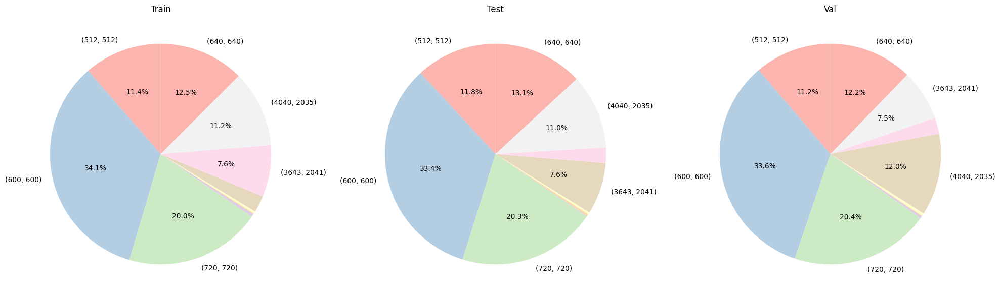

In [ ]:
plot_size_pies(unique_train_sizes, unique_test_sizes, unique_val_sizes)

In [ ]:
print(f"Макисмальная ширина изображений в трейновой части: {max([w for w, h in unique_train_sizes.keys()])}")
print(f"Макисмальная высота изображений в трейновой части: {max([h for w, h in unique_train_sizes.keys()])}")
print(f"Минимальная ширина изображений в трейновой части: {min([w for w, h in unique_train_sizes.keys()])}")
print(f"Минимальная высота изображений в трейновой части: {min([h for w, h in unique_train_sizes.keys()])}")
print("~~~~~~~~~~~~~~")
print(f"Макисмальная ширина изображений в валидационной части: {max([w for w, h in unique_val_sizes.keys()])}")
print(f"Макисмальная высота изображений в валидационной части: {max([h for w, h in unique_val_sizes.keys()])}")
print(f"Минимальная ширина изображений в валидационной части: {min([w for w, h in unique_val_sizes.keys()])}")
print(f"Минимальная высота изображений в валидационной части: {min([h for w, h in unique_val_sizes.keys()])}")
print("~~~~~~~~~~~~~~")
print(f"Макисмальная ширина изображений в тестовой части: {max([w for w, h in unique_test_sizes.keys()])}")
print(f"Макисмальная высота изображений в тестовой части: {max([h for w, h in unique_test_sizes.keys()])}")
print(f"Минимальная ширина изображений в тестовой части: {min([w for w, h in unique_test_sizes.keys()])}")
print(f"Минимальная высота изображений в тестовой части: {min([h for w, h in unique_test_sizes.keys()])}")

Макисмальная ширина изображений в трейновой части: 4040
Макисмальная высота изображений в трейновой части: 2044
Минимальная ширина изображений в трейновой части: 512
Минимальная высота изображений в трейновой части: 512
~~~~~~~~~~~~~~
Макисмальная ширина изображений в валидационной части: 4040
Макисмальная высота изображений в валидационной части: 2044
Минимальная ширина изображений в валидационной части: 512
Минимальная высота изображений в валидационной части: 512
~~~~~~~~~~~~~~
Макисмальная ширина изображений в тестовой части: 4040
Макисмальная высота изображений в тестовой части: 2044
Минимальная ширина изображений в тестовой части: 512
Минимальная высота изображений в тестовой части: 512


Датасет сильно неоднороден по разрешению и соотношению сторон. Простая жесткая ресайз-стратегия (растягивание до фиксированного размера, например, 640x640) приведет к искажениям объектов разного масштаба. Поэтому мы будем использовать стратегию (применяемую в YOLO в том числе), основанную на сохранении масштаба и последующем добавлении паддингов - letterbox, размер выберем 640x640 (на котором обучалась YOLO).

In [19]:
# ширина - 4040 px
show_image_with_boxes(TRAIN_DIRECTORY / 'images/Norway_000007.jpg')

In [20]:
# ширина - 3643 px
show_image_with_boxes(TRAIN_DIRECTORY / 'images/Norway_000002.jpg')

Здесь можно заметить, что в основном нестандартные размеры имеют изображения из Норвегии. Мы это учтем и чуть позже рассмотрим связь между размерами и странами.

In [ ]:
# Описание данных

n_train = sum(unique_train_sizes.values())
n_test = sum(unique_test_sizes.values())
n_val = sum(unique_val_sizes.values())
print(f"Всего изображений: {n_train + n_val + n_test}\n")
print(f"Изображений в train части: {n_train}")
print(f"Изображений в validation части: {n_val}")
print(f"Изображений в test части: {n_test}\n")
n = n_train + n_val
print(f"Соотношение train / val частей: {n_train / n * 100:.2f}% / {n_val / n * 100:.2f}%")
n = n_train + n_val + n_test
print(f"Соотношение train / val / test частей: {n_train / n * 100:.2f}% / {n_val / n * 100:.2f}% / {n_test / n * 100:.2f}%")

Всего изображений: 38385

Изображений в train части: 26869
Изображений в validation части: 5758
Изображений в test части: 5758

Соотношение train / val частей: 82.35% / 17.65%
Соотношение train / val / test частей: 70.00% / 15.00% / 15.00%


Сбалансированное разделение выборки.

In [ ]:
train_d = get_countries_vehicles(records_train)
val_d = get_countries_vehicles(records_test)
test_d = get_countries_vehicles(records_val)
sum_d = sum_dicts([train_d, val_d, test_d])

print("Train:", train_d, '\n')
print("Validation:", val_d, '\n')
print("Test:", test_d, '\n')
print("Sum:", sum_d)

Train: ({'China': 3051, 'Czech': 1962, 'India': 5368, 'Japan': 7432, 'Norway': 5708, 'United States': 3348}, {'Drone': 1675, 'MotorBike': 1376}) 

Validation: ({'China': 682, 'Czech': 436, 'India': 1166, 'Japan': 1524, 'Norway': 1197, 'United States': 753}, {'Drone': 377, 'MotorBike': 305}) 

Test: ({'China': 645, 'Czech': 431, 'India': 1172, 'Japan': 1550, 'Norway': 1256, 'United States': 704}, {'Drone': 349, 'MotorBike': 296}) 

Sum: ({'China': 4378, 'Czech': 2829, 'India': 7706, 'Japan': 10506, 'Norway': 8161, 'United States': 4805}, {'Drone': 2401, 'MotorBike': 1977})


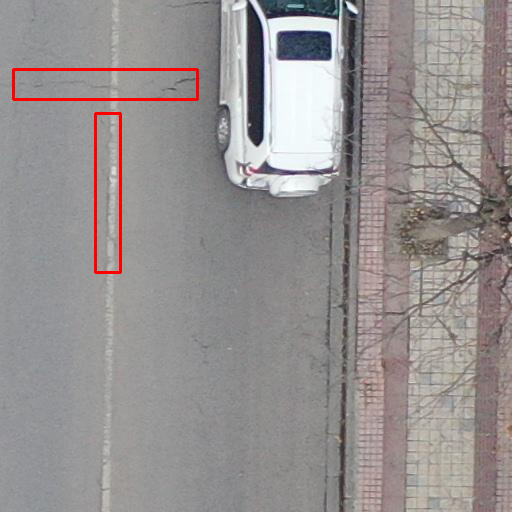

In [ ]:
# Пример изображения для Китая с дроном
show_image_with_boxes(TRAIN_DIRECTORY / 'images/China_Drone_000001.jpg')

In [26]:
# Пример изображения для Китая с мотоциклом
show_image_with_boxes(TRAIN_DIRECTORY / 'images/China_MotorBike_000000.jpg')

In [21]:
# Пример изображения для Чехии
show_image_with_boxes(TRAIN_DIRECTORY / 'images/Czech_000000.jpg')

In [22]:
# Пример изображения для Индии
show_image_with_boxes(TRAIN_DIRECTORY / 'images/India_000000.jpg')

In [23]:
# Пример изображения для Японии
show_image_with_boxes(TRAIN_DIRECTORY / 'images/Japan_000000.jpg')

In [24]:
# Пример изображения для Норвегии
show_image_with_boxes(TRAIN_DIRECTORY / 'images/Norway_000000.jpg')

In [25]:
# Пример изображения для США
show_image_with_boxes(TRAIN_DIRECTORY / 'images/United_States_000000.jpg')

Распределение изображений по странам неравномерно, например, для Китая характерные кадры в основном - только полотно, для Норвегии захвачена большая часть окружающей среду. Есть риск domain shift между странами (модель может переобучаться на стиль съемки стран).

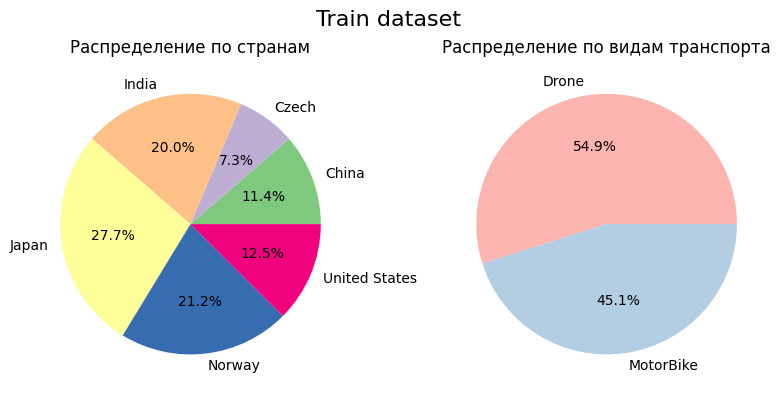

In [ ]:
plot_pies(train_d, title="Train dataset")

In [27]:
plot_pies(test_d, title="Test dataset")

In [28]:
plot_pies(val_d, title="Validation dataset")

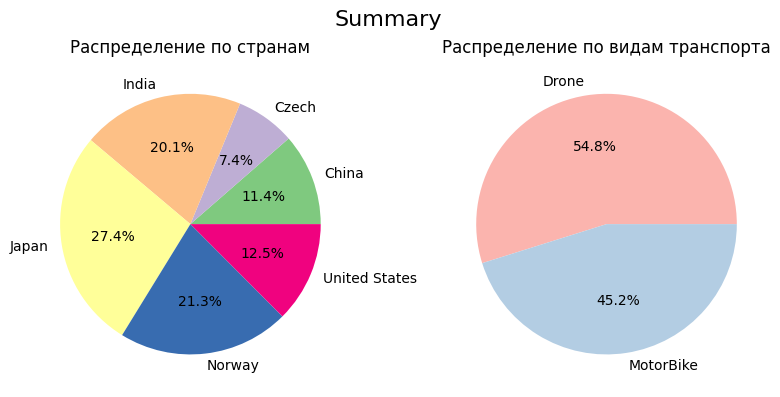

In [ ]:
plot_pies(sum_d, title="Summary")

In [ ]:
get_countries_sizes(records_train)

{'China': {(512, 512): 3051},
 'Czech': {(600, 600): 1962},
 'India': {(720, 720): 5368},
 'Japan': {(600, 600): 7199,
  (1024, 1024): 111,
  (1080, 1080): 36,
  (540, 540): 86},
 'Norway': {(3650, 2044): 656, (3643, 2041): 2032, (4040, 2035): 3020},
 'United States': {(640, 640): 3348}}

In [ ]:
get_countries_sizes(records_val)

{'China': {(512, 512): 645},
 'Czech': {(600, 600): 431},
 'India': {(720, 720): 1172},
 'Japan': {(600, 600): 1503,
  (1024, 1024): 18,
  (1080, 1080): 6,
  (540, 540): 23},
 'Norway': {(4040, 2035): 691, (3650, 2044): 136, (3643, 2041): 429},
 'United States': {(640, 640): 704}}

In [ ]:
get_countries_sizes(records_test)

{'China': {(512, 512): 682},
 'Czech': {(600, 600): 436},
 'India': {(720, 720): 1166},
 'Japan': {(600, 600): 1485,
  (1080, 1080): 6,
  (540, 540): 15,
  (1024, 1024): 18},
 'Norway': {(3643, 2041): 435, (3650, 2044): 131, (4040, 2035): 631},
 'United States': {(640, 640): 753}}

Видно, что есть прямая зависимость между разрешением изображением и странами, где они были сделаны.

In [29]:
show_image_with_boxes(TRAIN_DIRECTORY / 'images/Japan_000396.jpg')

In [30]:
show_image_with_boxes(TRAIN_DIRECTORY / 'images/Japan_000616.jpg')

### Classes

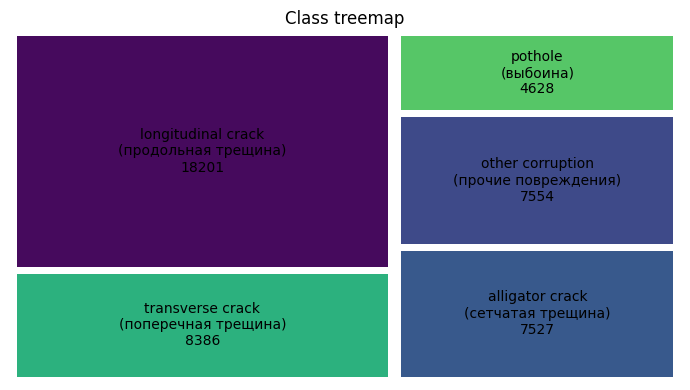

In [ ]:
russian_names = [
    'продольная трещина',
    'поперечная трещина',
    'сетчатая трещина',
    'прочие повреждения',
    'выбоина'
]
both_lang_names = [f"{el1}\n({el2})" for el1, el2 in zip(names, russian_names)]

plot_treemap_classes(records_train, both_lang_names)

In [15]:
plot_treemap_classes(records_test, both_lang_names)

In [16]:
plot_treemap_classes(records_val, both_lang_names)

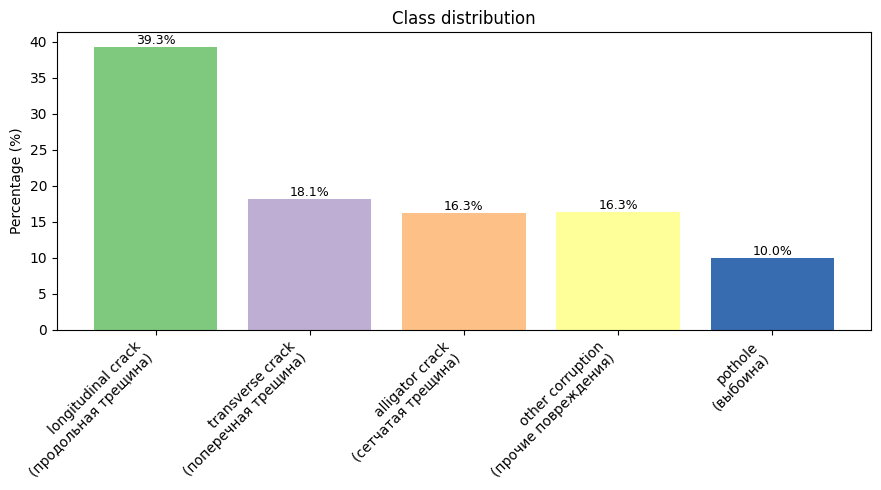

In [ ]:
plot_bar_classes(records_train, both_lang_names)

In [17]:
plot_bar_classes(records_test, both_lang_names)

In [18]:
plot_bar_classes(records_val, both_lang_names)

В целом, классыд остаточно сбалансированны, но может присутствовать смещение в пользу longitudinal crack.

### Анализ bounding boxes

**Распределения ширины и высоты изображений**:

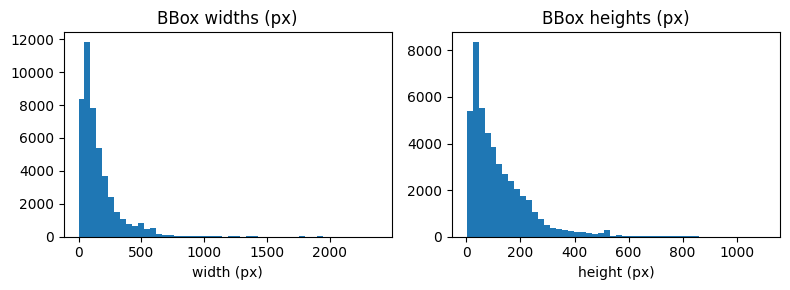

In [ ]:
plot_hist_width_height(records_train)

In [1]:
plot_hist_width_height(records_val)

In [2]:
plot_hist_width_height(records_test)

**Распределение площади изображений (ширина x высота)**:

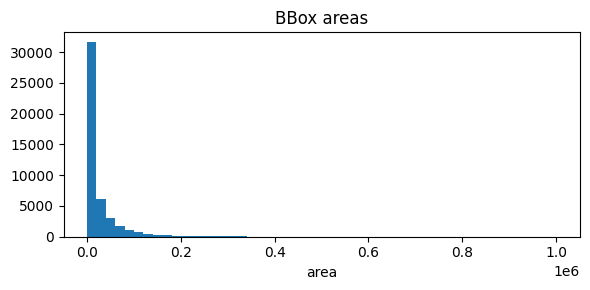

In [ ]:
plot_hist_area(records_train)

In [3]:
plot_hist_area(records_val)

In [4]:
plot_hist_area(records_test)

**Распределение соотношений сторон изображений (ширина / высота)**:

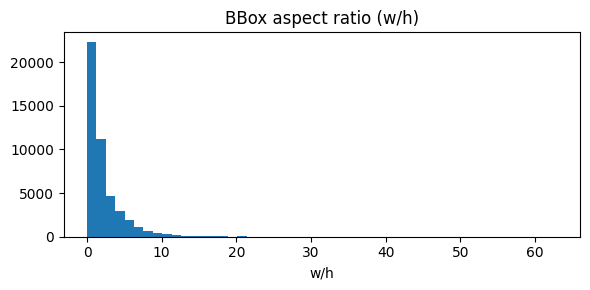

In [ ]:
plot_hist_ratio(records_train)

In [5]:
plot_hist_ratio(records_val)

In [6]:
plot_hist_ratio(records_test)

**Распределение центров рамок**:

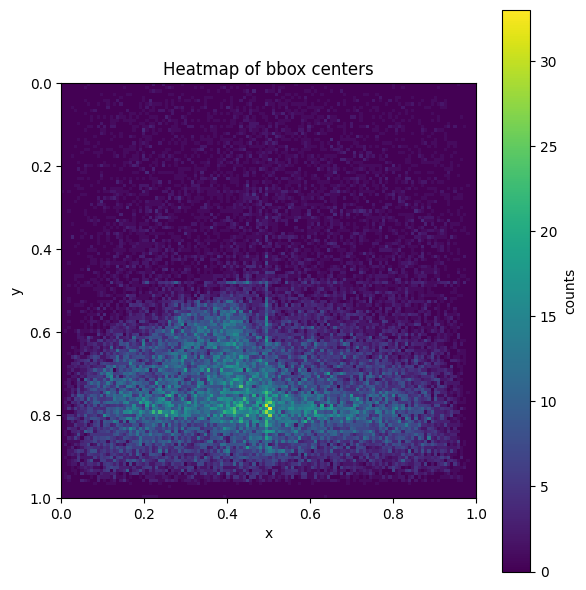

In [ ]:
arr = plot_centers_heatmap(records_train, draw_scatter=False)

Исходя из тепловой карты, объекты расположены в основном ближе к нижней части исходных картинок. Это показывает смещение bounding boxes.

In [ ]:
yc = arr[:,1]
print("count:", len(yc))
print("y < 0.5:", np.sum(yc < 0.5), np.sum(yc < 0.5)/len(yc))
print("y percentiles:", np.percentile(yc, [0,1,5,25,50,75,95,99,100]))

count: 46296
y < 0.5: 4784 0.1033350613443926
y percentiles: [   0.008789     0.10936     0.31836        0.64     0.75498     0.83417     0.92813       0.965      0.9925]


Из распределения видно, что это свойство датасета. Это объясняется природой изображений -> если это дороги, то вероятно в верхней часть по большей части будет неходиться небо или другие части съемки. Однако для обобщающей способности модели это плохо (риск переобучиться на *положение дефектов*), поэтому в дальнейшем мы попытаемся сломать этот паттерн аугментациями.

In [7]:
plot_centers_heatmap(records_test, draw_scatter=False);

In [8]:
plot_centers_heatmap(records_val, draw_scatter=False);

#### Количество рамок на изображениях

In [ ]:
print_objs_per_image_info(records_train)

Общее количество изображений:			26869
Количество изображений без рамок:		8097	(30.1%)
Количество изображений с 1 рамкой:		7165	(26.7%)
Количество изображений с 2 рамками:		5006	(18.6%)
Количество изображений с 3 рамками:		2931	(10.9%)
Количество изображений с 4 или более рамками:	3670	(13.7%)


In [ ]:
print_objs_per_image_info(records_val)

Общее количество изображений:			5758
Количество изображений без рамок:		1837	(31.9%)
Количество изображений с 1 рамкой:		1517	(26.3%)
Количество изображений с 2 рамками:		991	(17.2%)
Количество изображений с 3 рамками:		633	(11.0%)
Количество изображений с 4 или более рамками:	780	(13.5%)


In [ ]:
print_objs_per_image_info(records_test)

Общее количество изображений:			5758
Количество изображений без рамок:		1790	(31.1%)
Количество изображений с 1 рамкой:		1536	(26.7%)
Количество изображений с 2 рамками:		1093	(19.0%)
Количество изображений с 3 рамками:		587	(10.2%)
Количество изображений с 4 или более рамками:	752	(13.1%)


Большое число пустых изображений полезно как negative samples.

### Анализ качества разметки

#### Мелкие рамки

In [ ]:
result_train = find_small_boxes(records_train, min_px=6)
print(f'Мелких рамок в трейновой части: {len(result_train)}\n~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~')
result_train[:2]

Мелких рамок в трейновой части: 15
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


[{'file': '/content/data/RDD_SPLIT/train/images/China_MotorBike_000856.jpg',
  'class': np.float64(0.0),
  'bbox': (np.float64(201.9998779296875),
   np.float64(35.000064849853516),
   np.float64(207.00006103515625),
   np.float64(76.99993896484375)),
  'w': np.float64(5.00018310546875),
  'h': np.float64(41.999874114990234)},
 {'file': '/content/data/RDD_SPLIT/train/images/China_MotorBike_001043.jpg',
  'class': np.float64(0.0),
  'bbox': (np.float64(321.9998779296875),
   np.float64(14.000127792358398),
   np.float64(327.00006103515625),
   np.float64(60.0002555847168)),
  'w': np.float64(5.00018310546875),
  'h': np.float64(46.0001277923584)}]

array([[[151, 150, 148],
        [139, 138, 136],
        [154, 153, 151],
        ...,
        [119, 118, 116],
        [120, 119, 117],
        [121, 120, 118]],

       [[154, 153, 151],
        [133, 132, 130],
        [157, 156, 154],
        ...,
        [122, 121, 119],
        [125, 124, 122],
        [127, 126, 124]],

       [[148, 147, 145],
        [129, 128, 126],
        [134, 133, 131],
        ...,
        [124, 123, 121],
        [121, 120, 118],
        [117, 116, 114]],

       ...,

       [[148, 146, 147],
        [143, 141, 142],
        [133, 131, 132],
        ...,
        [144, 143, 141],
        [153, 152, 150],
        [142, 141, 139]],

       [[141, 139, 140],
        [172, 170, 171],
        [125, 123, 124],
        ...,
        [137, 136, 134],
        [138, 137, 135],
        [132, 131, 129]],

       [[151, 149, 150],
        [163, 161, 162],
        [125, 123, 124],
        ...,
        [131, 130, 128],
        [125, 124, 122],
        [125, 124, 122]]], dtype=uint8)
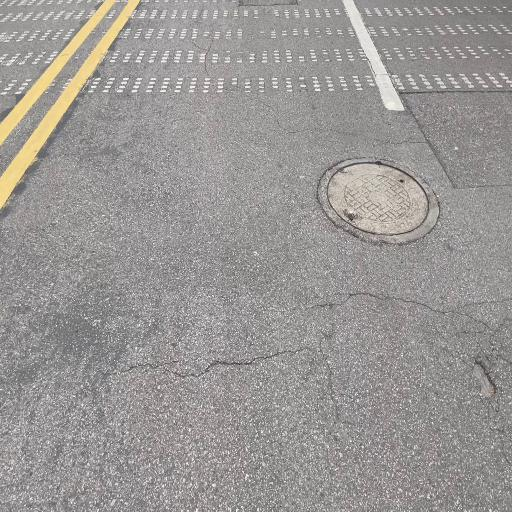

In [ ]:
img = cv2.imread(TRAIN_DIRECTORY / 'images/China_MotorBike_000856.jpg')
cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

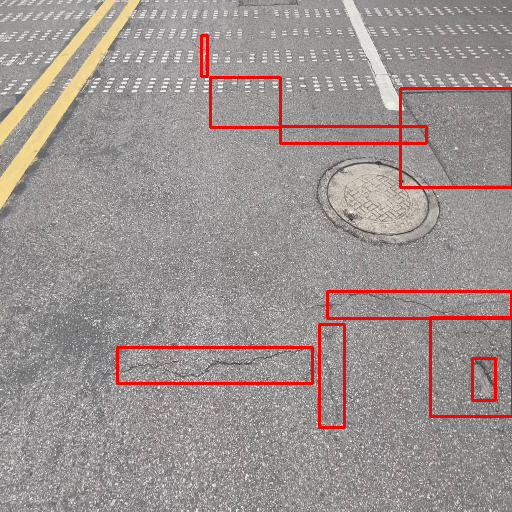

In [ ]:
show_image_with_boxes(TRAIN_DIRECTORY / 'images/China_MotorBike_000856.jpg')

In [9]:
img = cv2.imread(TRAIN_DIRECTORY / 'images/Japan_001044.jpg')
cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [10]:
show_image_with_boxes(TRAIN_DIRECTORY / 'images/Japan_001044.jpg')

In [ ]:
result_val = find_small_boxes(records_val, min_px=6)
print(f'Мелких рамок в валидационной части: {len(result_val)}')

Мелких рамок в валидационной части: 4


In [ ]:
result_test = find_small_boxes(records_test, min_px=6)
print(f'Мелких рамок в валидационной части: {len(result_test)}')

Мелких рамок в валидационной части: 2


In [ ]:
files_to_delete = [rec['file'] for rec in result_train] + \
                  [rec['file'] for rec in result_val]
# файлы из теста мы удалять не можем
files_to_delete

['/content/data/RDD_SPLIT/train/images/China_MotorBike_000856.jpg',
 '/content/data/RDD_SPLIT/train/images/China_MotorBike_001043.jpg',
 '/content/data/RDD_SPLIT/train/images/China_MotorBike_001070.jpg',
 '/content/data/RDD_SPLIT/train/images/China_MotorBike_001287.jpg',
 '/content/data/RDD_SPLIT/train/images/China_MotorBike_001573.jpg',
 '/content/data/RDD_SPLIT/train/images/Japan_001044.jpg',
 '/content/data/RDD_SPLIT/train/images/Japan_001265.jpg',
 '/content/data/RDD_SPLIT/train/images/Japan_001396.jpg',
 '/content/data/RDD_SPLIT/train/images/Japan_002782.jpg',
 '/content/data/RDD_SPLIT/train/images/Japan_003991.jpg',
 '/content/data/RDD_SPLIT/train/images/Japan_005095.jpg',
 '/content/data/RDD_SPLIT/train/images/Japan_006156.jpg',
 '/content/data/RDD_SPLIT/train/images/Japan_008920.jpg',
 '/content/data/RDD_SPLIT/train/images/Japan_010782.jpg',
 '/content/data/RDD_SPLIT/train/images/Norway_005967.jpg',
 '/content/data/RDD_SPLIT/val/images/Japan_002311.jpg',
 '/content/data/RDD_SPL

Мелкие рамки потенциально могут повлиять негативно на обучение модели:
1. YOLO-модели плохо учатся на очень маленьких объектах, потому что:
    - регрессия координат становится нестабильной,
    - смещение центра на 1–2 пикселя уже даёт огромный относительный IoU-потерю,
    - такие боксы часто дают высокий шум в feature maps.
2. Если мелкие дефекты размечены даже слегка ошибочно, то модель получает неверный сигнал. Т.е. разметка должна быть идеальной (а суля по фото это не совсем так).
3. Далее при использовании аугментаций мелкие боксы утонут при преобразованиях (например, тот же RandomResizedCrop, если будет использоваться), что сломает такие рамки и только внесет шум в таргет.

Так как в целом, это небольшая часть датасета, то мы легко можем не включать эти изображения в обучение.

#### Рамки, выходящие за границы

In [ ]:
result_train = find_out_of_bounds_boxes(records_train)
print(f'Рамок, выходящих за границы, в трейновой части: {len(result_train)}')

Рамок, выходящих за границы, в трейновой части: 0


#### Распределение перекрытий рамок

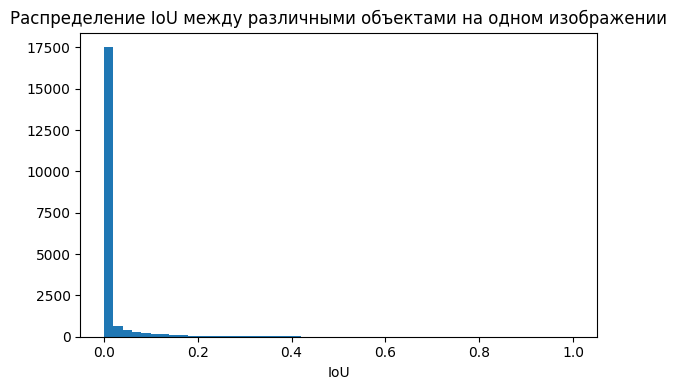

In [ ]:
plot_iou_hist(records_train)

In [11]:
plot_iou_hist(records_train, non_zero=True, bins=70)

In [12]:
plot_iou_hist(records_val)

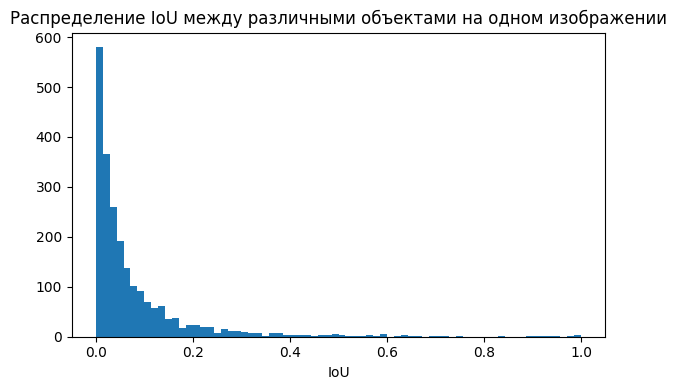

In [ ]:
plot_iou_hist(records_val, non_zero=True, bins=70)

In [13]:
plot_iou_hist(records_test)

In [14]:
plot_iou_hist(records_test, non_zero=True, bins=70)

В целом, большая часть рамок не перекрывает друг друга, поэтому обычный NMS с threshold=0.5 нам подойдет (отсекает большую часть перекрытий).

### Анализ каналов изображения (RGB)

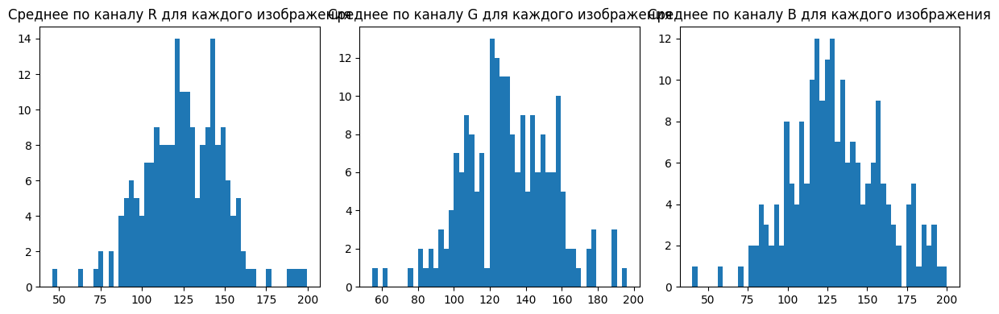

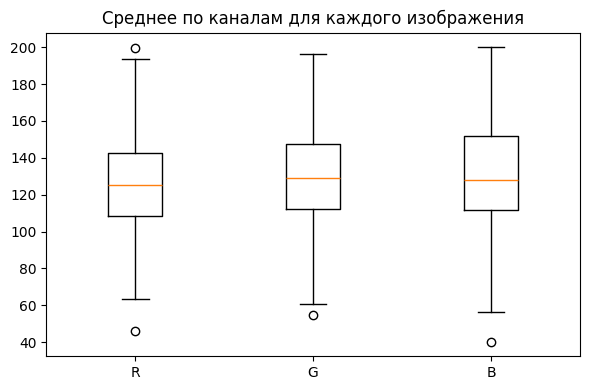

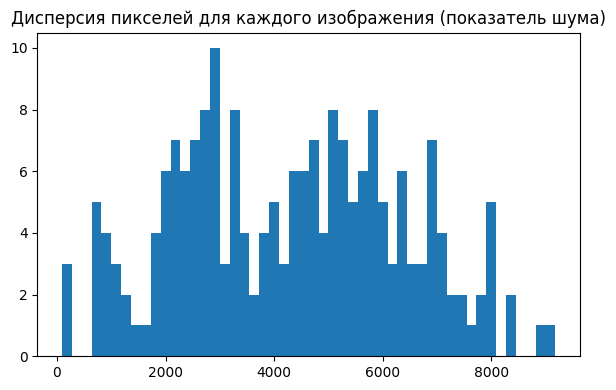

In [ ]:
plot_rgb_channel_histograms_cv2(records_train, TRAIN_DIRECTORY)

Будем применять color augmentations для повышения робастности.

### Preprocessing

Удалим мелкие рамки, которые обнаружили ранее:

In [ ]:
delete_images_and_labels(files_to_delete)

## Augmentations

In [ ]:
!mkdir -p /content/saves
DIR = Path("/content/zip_saves")
DIR_NEW = Path("/content/saves")
for p in DIR.glob("*.zip"):
    try:
        dest = p.with_suffix("")  # убирает .zip
        dest = DIR_NEW / dest.name
        dest.mkdir(exist_ok=True)
        with zipfile.ZipFile(p, 'r') as z:
            z.extractall(dest)
    except:
        print(f"File {p} failed")

### **Baseline**

Наша задача провести тесты и понять, какой пайплайн для аугментаций будет работать лучше всего --> нам выгоднее взять модель побыстрее. Также в данном разделе будем обучаться на подвыборке в 10%

In [ ]:
yaml_baseline = """
path: /content/data/RDD_SPLIT
train: train
val: val
test: test
names:
    0: longitudinal crack
    1: transverse crack
    2: alligator crack
    3: other corruption
    4: pothole
"""

with open(f'{MAIN_DIRECTORY}/rdd2022.yaml', 'w') as file:
    file.write(yaml_baseline)

In [ ]:
custom_transforms = []

model = YOLO('yolov8s.pt')
model.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=10,
    # устанавливает размер изображения, к которому приводятся все фото
    imgsz=640,
    # задает размер батча, для теста ставим очень маленькое значение
    batch=4,
    # устанавливает GPU
    device=0,
    # позволяет модели сохраняться
    save=True,
    # использование кэша -> увеличивает потребление памяти, но ускоряет обучение
    cache=True,
    # устанавливает папку для сохранений
    project='/content/saves',
    # создает подпапку внутри проекта
    name='Baseline',
    # перезаписывает проект, если уже существует
    exist_ok=True,
    # используем предобученную модель для лучших результатов
    pretrained=True,
    # сохраняет графики обучения
    plots=True,
    # самое важное здесь -> по умолчанию YOLO уже применяет аугментации
    # но так как нам нужен кастомный пайплайн, то для Baseline мы ничего
    # не будем применять
    augmentations=custom_transforms,
    # указываем, что обучаемся на подвыборке в 10%
    fraction=0.1
)

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, augmentations=[], auto_augment=randaugment, batch=4, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=Baseline, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7830f74291c0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
!zip -q -r /content/zip_saves/Baseline.zip /content/saves/Baseline

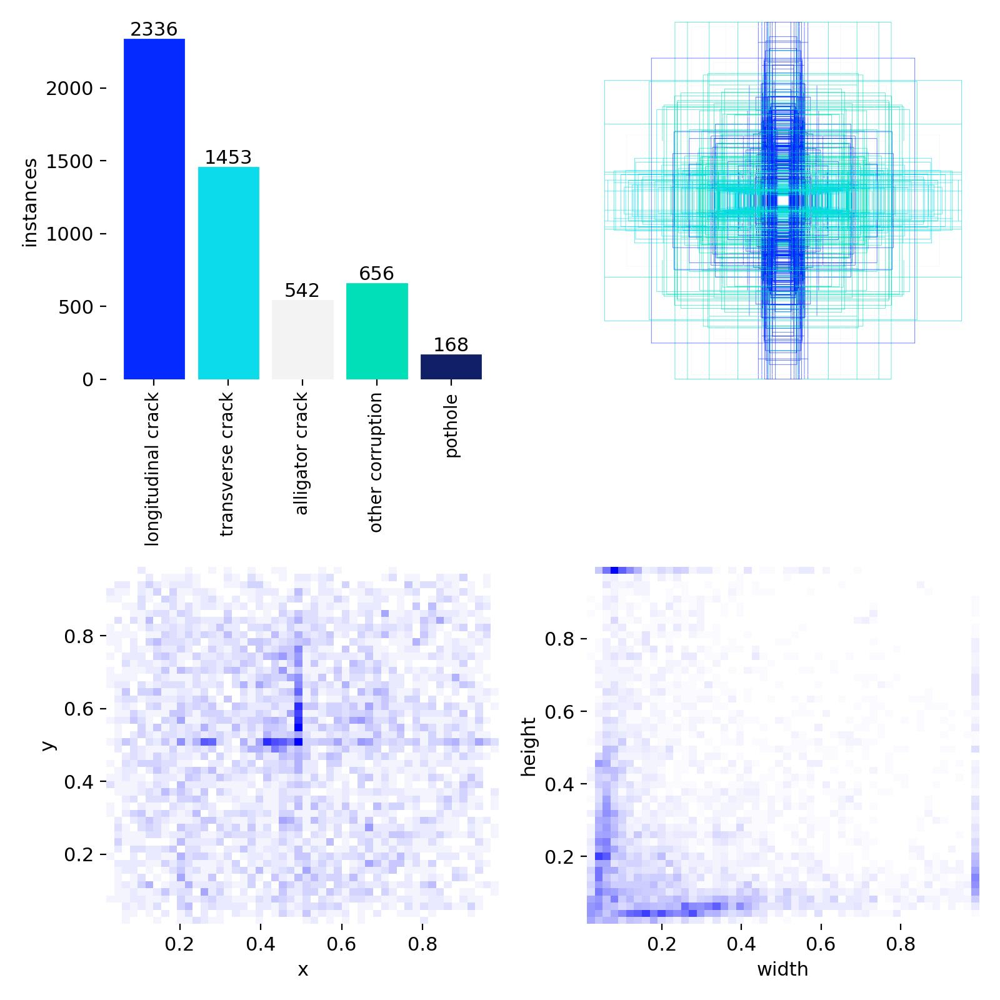

In [ ]:
Image("/content/saves/Baseline/labels.jpg")

In [ ]:
results_baseline = pd.read_csv("/content/saves/Baseline/results.csv")
results_baseline

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,219.023,2.29628,3.81462,2.05640,0.06939,0.04075,0.01713,0.00644,2.55721,4.59174,2.27600,0.000370,0.000370,0.000370
1,2,410.952,2.21909,2.90439,2.04970,0.06378,0.05948,0.01755,0.00553,2.67714,5.13844,2.40690,0.000667,0.000667,0.000667
2,3,584.060,2.15570,2.82184,2.02181,0.11697,0.09183,0.03707,0.01491,2.59788,5.10644,2.39291,0.000891,0.000891,0.000891
3,4,755.944,2.05762,2.63027,1.93754,0.27239,0.08981,0.02960,0.01139,2.53029,5.27030,2.27431,0.000781,0.000781,0.000781
4,5,927.773,1.93888,2.41975,1.83943,0.15121,0.11843,0.05083,0.01864,2.56041,5.12930,2.27841,0.000671,0.000671,0.000671
5,6,1099.810,1.83328,2.27253,1.76183,0.15211,0.13134,0.06892,0.02779,2.39680,4.31922,2.19254,0.000561,0.000561,0.000561
6,7,1271.110,1.74883,2.11289,1.70093,0.19787,0.13421,0.08759,0.03762,2.44449,4.32774,2.18767,0.000451,0.000451,0.000451
7,8,1444.320,1.67823,1.99349,1.64273,0.24338,0.14504,0.09867,0.04432,2.42243,4.17978,2.17116,0.000341,0.000341,0.000341
8,9,1617.630,1.60365,1.85619,1.58923,0.30227,0.15958,0.11167,0.05246,2.36717,4.09966,2.14361,0.000231,0.000231,0.000231
9,10,1790.550,1.53073,1.75422,1.54262,0.31518,0.16296,0.12861,0.05958,2.38903,3.99605,2.10542,0.000121,0.000121,0.000121


### **Стадия 1**

1. Нам необходимо переопределить процесс обучения yolo, чтобы использовать кастомные варианты из Albumentations;
2. На первой стадии необходимо отобрать пространственные аугментации и на выходе получить изображения нужного размера.

In [ ]:
class CustomAlbumentations(UltralyticsAlbumentations):
    def __init__(self, transform, contains_spatial: bool, p=1.0):
        super().__init__(p)
        # заменяет предустановленные transforms кастомным вариантом
        self.transform = transform
        self.transform.set_random_seed(MANUAL_SEED)
        self.contains_spatial = contains_spatial

    def __call__(self, labels):
        labels = super().__call__(labels)
        if "cls" in labels:
            labels["cls"] = labels["cls"].reshape(-1, 1)
        return labels

    def __repr__(self):
        return str(self.transform)

In [ ]:
class CustomTrainer(DetectionTrainer):
    """
    Custom trainer, который заменяет стандартные аугментации Ultralytics на
    кастомные преобразования Albumentations.

    Этот trainer перехватывает процесс создания набора данных и заменяет стандартные
    аугментации Ultralytics на наши пользовательские преобразования Albumentations.
    """

    def __init__(self, custom_albumentations_transforms, *args, **kwargs):
        super(CustomTrainer, self).__init__(*args, **kwargs)
        self.custom_albumentations_transforms = custom_albumentations_transforms
        self.replacement_logged = False

    def _close_dataloader_mosaic(self):
        """
        Вызывается при закрытии мозаичной аугментации (обычно на более поздних этапах).
        Нам также необходимо заменить аугментации, поскольку набор данных пересоздается.
        """
        super()._close_dataloader_mosaic()
        self.__customize_albumentations_transforms(self.train_loader.dataset)

    def __customize_albumentations_transforms(self, dataset):
        """
        Заменяет стандартные аугментации Ultralytics на наши.

        Этот метод перебирает преобразования набора данных и заменяет все
        экземпляры Ultralytics Albumentations на кастомные.
        """
        transforms = dataset.transforms.tolist()
        for i, t in enumerate(transforms):
            if isinstance(t, UltralyticsAlbumentations):
                if not self.replacement_logged:
                    print("\n" + "="*80)
                    print("🔄 REPLACING DEFAULT ULTRALYTICS AUGMENTATIONS")
                    print("="*80)
                    print(f"❌ REMOVING Default Ultralytics augmentations:")
                    print(f"   {t}")
                    print(f"\n✅ APPLYING Custom Albumentations:")
                    print(f"   {self.custom_albumentations_transforms}")
                    print("="*80 + "\n")
                    self.replacement_logged = True

                transforms[i] = self.custom_albumentations_transforms

    def build_dataset(self, img_path, mode="train", batch=None):
        """
        Создает набор данных и немедленно заменяет аугментации.

        Этот метод вызывается во время инициализации обучения, поэтому мы заменяем
        аугментации сразу после создания набора данных.
        """
        dataset = super().build_dataset(img_path, mode=mode, batch=batch)
        self.__customize_albumentations_transforms(dataset)
        return dataset

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    # делаем рандомную обрезку изображения, сохраняя при этом все рамки
    A.BBoxSafeRandomCrop(p=0.3),
    # применяем стратегию letterbox для приведения изображений к нужному размеру
    # padding заливаем серым цветом
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    # так как наши данные чувствительны к геометрическим инвариантам
    # (небо не может быть снизу, например), можно применить только
    # горизонтальный поворот
    A.HorizontalFlip(p=0.5)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

print("Аугментации, которые мы хотим применить:")
for aug in transform.transforms:
    print(f"   • {aug}")

model_stage_1 = YOLO('yolov8n.pt')
model_stage_1.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    batch=4,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='AugStage1',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms)
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
Аугментации, которые мы хотим применить:
   • BBoxSafeRandomCrop(p=0.3, erosion_rate=0.0)
   • LongestMaxSize(p=1.0, area_for_downscale=None, interpolation=1, mask_interpolation=0, max_size=640, max_size_hw=None)
   • PadIfNeeded(p=1.0, border_mode=0, fill=(114.0, 114.0, 114.0), fill_mask=0.0, min_height=640, min_width=640, pad_height_divisor=None, pad_width_divisor=None, padding=0, position='center')
   • HorizontalFlip(p=0.5)
Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=4, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78323eff29c0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
!zip -q -r /content/zip_saves/AugStage1.zip /content/saves/AugStage1

In [ ]:
results_augstage1 = pd.read_csv("/content/saves/AugStage1/results.csv")
results_augstage1

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,182.836,2.05242,3.64022,1.86086,0.09019,0.07404,0.02768,0.01051,2.55526,4.82997,2.26767,0.000370,0.000370,0.000370
1,2,361.045,1.93238,3.02302,1.78491,0.29310,0.09866,0.04199,0.01559,2.43081,4.51370,2.16017,0.000635,0.000635,0.000635
2,3,536.717,1.86080,2.74632,1.73676,0.18074,0.10845,0.05209,0.02040,2.40347,4.62887,2.15147,0.000796,0.000796,0.000796
3,4,712.866,1.78726,2.56742,1.69204,0.16651,0.12900,0.06999,0.02936,2.36121,4.18286,2.13936,0.000640,0.000640,0.000640
4,5,888.030,1.72029,2.41825,1.64688,0.18558,0.13845,0.07824,0.03362,2.29595,4.47786,2.07547,0.000482,0.000482,0.000482
5,6,1062.180,1.64296,2.26360,1.58600,0.22909,0.15888,0.10716,0.04809,2.27774,3.81075,2.03226,0.000325,0.000325,0.000325
6,7,1236.400,1.58058,2.11697,1.53065,0.25862,0.16124,0.11585,0.05172,2.27052,3.80606,2.01367,0.000168,0.000168,0.000168


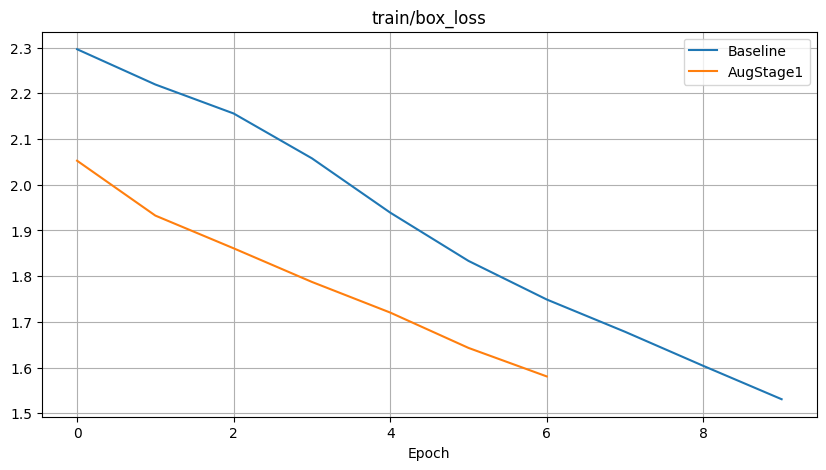

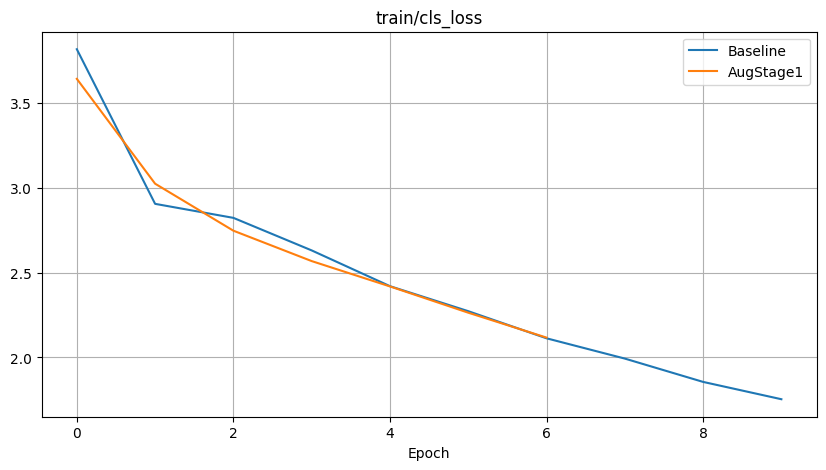

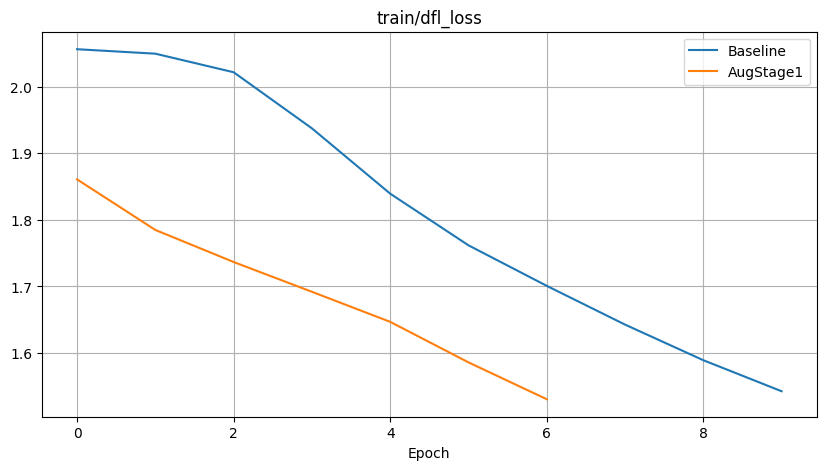

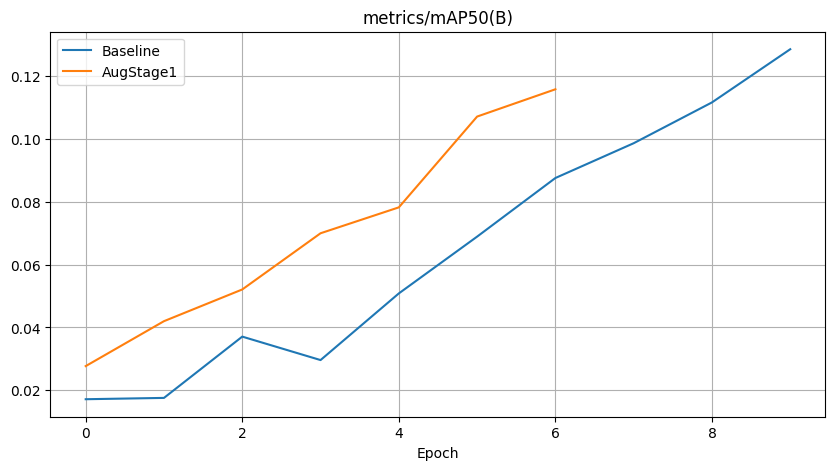

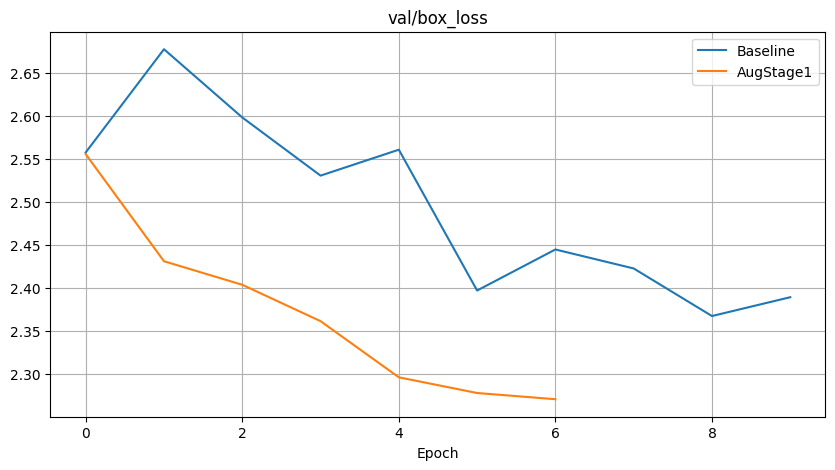

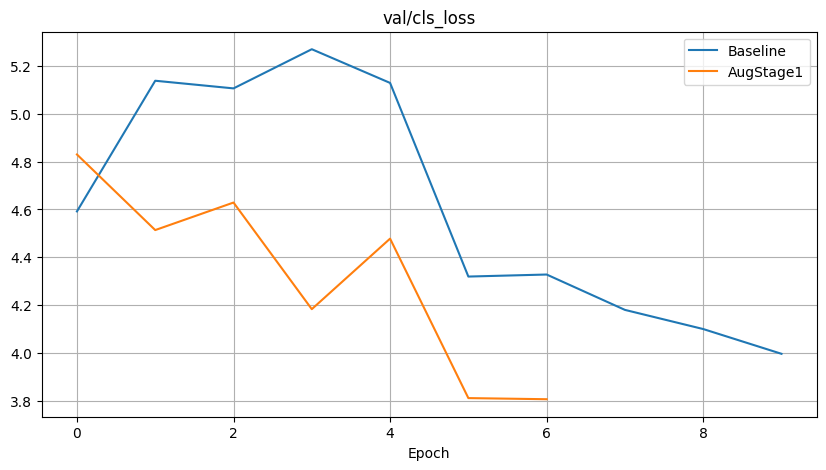

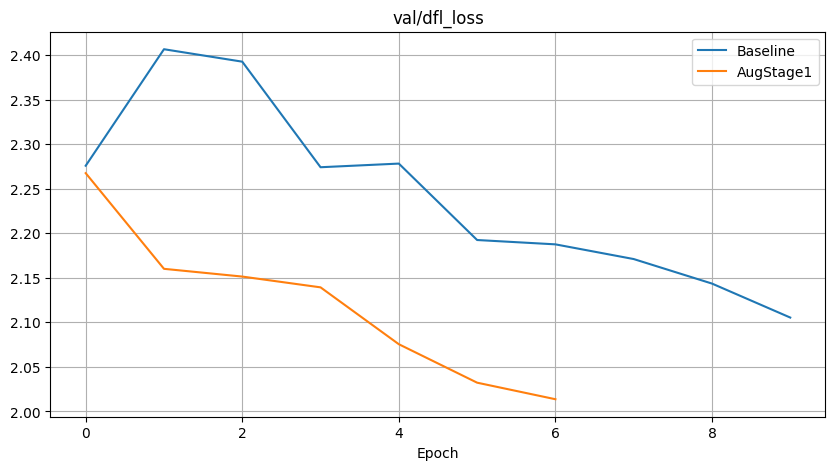

In [ ]:
plot_model_metrics([("Baseline", results_baseline),
                    ("AugStage1", results_augstage1)],
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

Даже не смотря на то, что аугментации должны являться своеобразной регуляризацией для модели, мы видим все равно значительное улучшение как метрик, так и снижения лосса. Однозначно оставляем наши преобразования.

### **Стадия 2**

На второй стадии добавим аугментации с dropout.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        # случайным образом обнуляет прямоугольные области на изображении
        A.CoarseDropout(num_holes_range=(1, 4), fill=0, p=1.0),
        # то же самое, только заливает шумом
        A.CoarseDropout(num_holes_range=(1, 4), fill="random", p=1.0),
        # обнуляет пиксели по сетке
        A.GridDropout(ratio=0.3, p=1.0),
        # применяет dropout к области изображения внутри рамок
        A.ConstrainedCoarseDropout(p=1.0),
        # то же самое, но заливает шумом
        A.ConstrainedCoarseDropout(fill="random", p=1.0)
    ], p=0.5)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

print("Аугментации, которые мы хотим применить:")
for aug in transform.transforms:
    print(f"   • {aug}")

model_stage_2 = YOLO('yolov8n.pt')
model_stage_2.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    batch=4,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='AugStage2',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms)
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
Аугментации, которые мы хотим применить:
   • BBoxSafeRandomCrop(p=0.3, erosion_rate=0.0)
   • LongestMaxSize(p=1.0, area_for_downscale=None, interpolation=1, mask_interpolation=0, max_size=640, max_size_hw=None)
   • PadIfNeeded(p=1.0, border_mode=0, fill=(114.0, 114.0, 114.0), fill_mask=0.0, min_height=640, min_width=640, pad_height_divisor=None, pad_width_divisor=None, padding=0, position='center')
   • HorizontalFlip(p=0.5)
   • OneOf([
  CoarseDropout(p=1.0, fill=0.0, fill_mask=None, hole_height_range=(0.1, 0.2), hole_width_range=(0.1, 0.2), num_holes_range=(1, 4)),
  CoarseDropout(p=1.0, fill='random', fill_mask=None, hole_height_range=(0.1, 0.2), hole_width_range=(0.1, 0.2), num_holes_range=(1, 4)),
  GridDropout(p=1.0, fill=0.0, fill_mask=None, holes_number_xy=None, r

/usr/local/lib/python3.12/dist-packages/albumentations/core/transforms_interface.py:265: UserWarning: Neither valid mask nor bboxes provided, do not apply Constrained Coarse Dropout
  params_dependent_on_data = self.get_params_dependent_on_data(params=params, data=kwargs)
/usr/local/lib/python3.12/dist-packages/albumentations/core/transforms_interface.py:265: UserWarning: Neither valid mask nor bboxes provided, do not apply Constrained Coarse Dropout
  params_dependent_on_data = self.get_params_dependent_on_data(params=params, data=kwargs)


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 74.5±39.4 MB/s, size: 825.9 KB)
val: Scanning /content/data/RDD_SPLIT/val/labels.cache... 5754 images, 1837 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 5754/5754 2.8Mit/s 0.0s
val: /content/data/RDD_SPLIT/val/images/Japan_006536.jpg: 1 duplicate labels removed
WARNING ⚠️ val: 8.5GB RAM required to cache images with 50% safety margin but only 5.3/12.7GB available, not caching images
Plotting labels to /content/saves/AugStage2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/saves/AugStage2
Starting training for 7 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
        1/7 

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ed812e3cd40>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
!zip -q -r /content/zip_saves/AugStage2.zip /content/saves/AugStage2

In [ ]:
results_augstage2 = pd.read_csv("/content/saves/AugStage2/results.csv")
results_augstage2

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,172.053,2.07586,3.63619,1.89946,0.11379,0.07866,0.03238,0.01164,2.48681,4.69022,2.21890,0.000370,0.000370,0.000370
1,2,333.941,1.95933,3.04437,1.80854,0.13438,0.11379,0.04734,0.01794,2.41792,4.41963,2.16583,0.000635,0.000635,0.000635
2,3,494.198,1.88271,2.76927,1.74303,0.15759,0.09636,0.04798,0.01746,2.43708,4.36067,2.20567,0.000796,0.000796,0.000796
3,4,653.566,1.81915,2.54342,1.70163,0.18173,0.12651,0.07202,0.02852,2.34558,4.30971,2.13711,0.000640,0.000640,0.000640
4,5,811.888,1.73822,2.36940,1.63790,0.22161,0.14180,0.08677,0.03486,2.35496,4.69467,2.15251,0.000482,0.000482,0.000482
5,6,968.549,1.66292,2.25615,1.60079,0.20735,0.15872,0.09911,0.04218,2.25384,4.18401,2.02612,0.000325,0.000325,0.000325
6,7,1124.550,1.59022,2.13187,1.55463,0.23611,0.16470,0.11146,0.05037,2.26747,4.30503,2.03497,0.000168,0.000168,0.000168


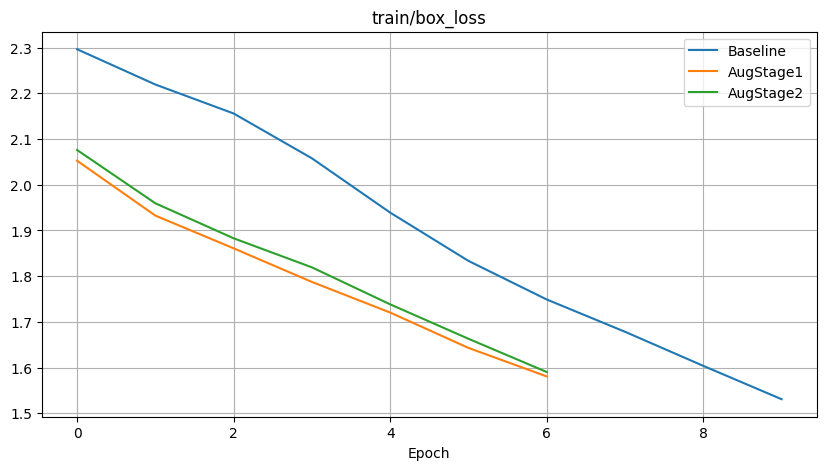

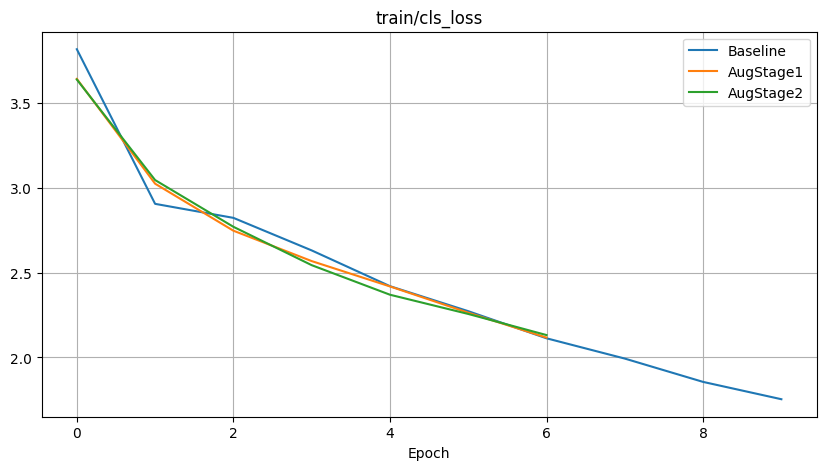

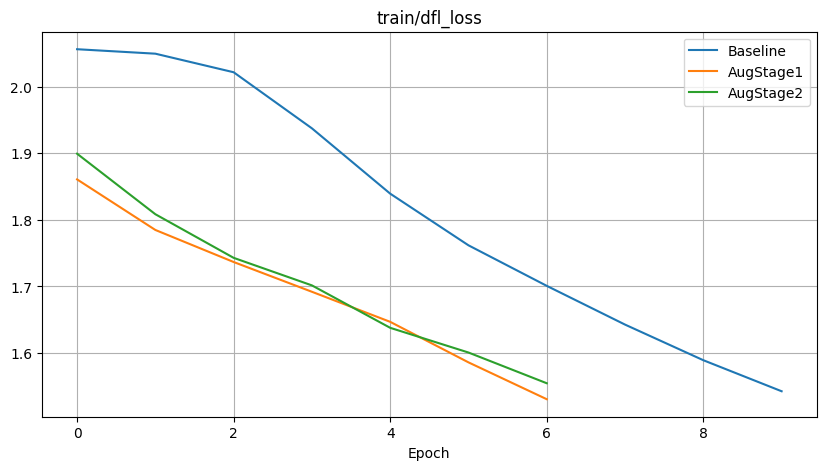

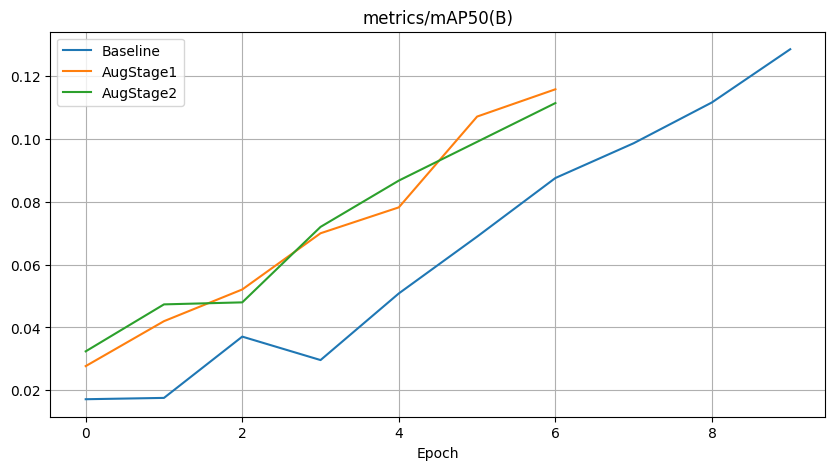

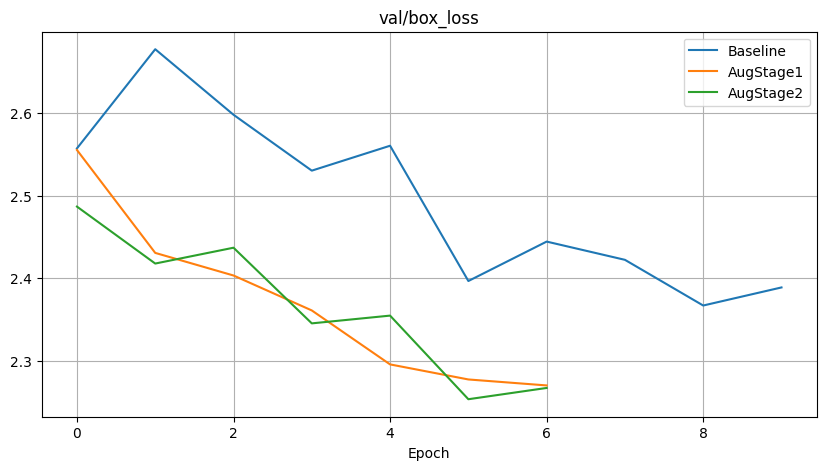

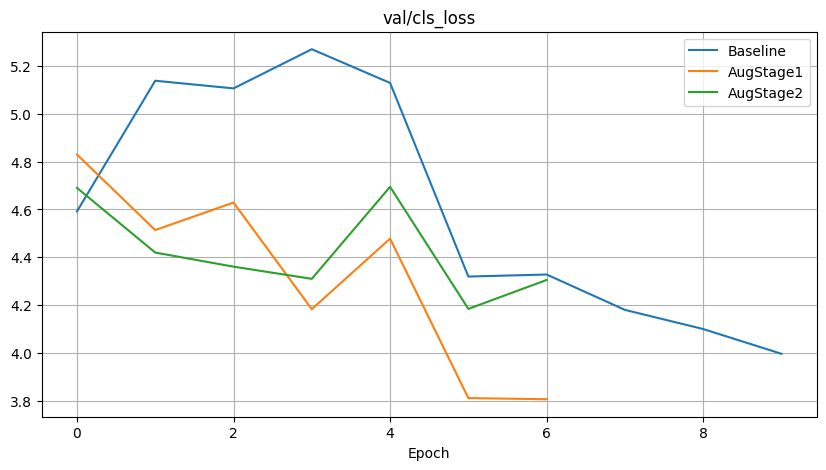

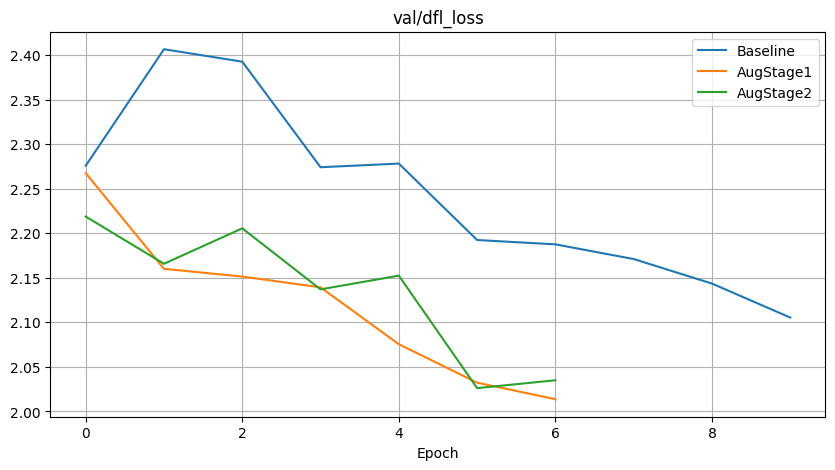

In [ ]:
results_baseline = pd.read_csv("/content/saves/Baseline/results.csv")
results_augstage1 = pd.read_csv("/content/saves/AugStage1/results.csv")
plot_model_metrics([("Baseline", results_baseline),
                    ("AugStage1", results_augstage1),
                    ("AugStage2", results_augstage2)],
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

Ожидаемо получаем меньший лосс на трейновой части, однако исходя из метрик и лосса на валидационной части, мы применяем слишком жесктие аугментации. Попробуем поправить это и сделать аугментации второй стадии помягче.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 4), fill=114, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
        A.ConstrainedCoarseDropout(num_holes_range=(1, 4),
                                   hole_height_range=(0.1, 0.3),
                                   hole_width_range=(0.1, 0.3),
                                   fill=114, p=1.0),
    # уменьшаем вероятность появления этой аугментации
    ], p=0.3)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

print("Аугментации, которые мы хотим применить:")
for aug in transform.transforms:
    print(f"   • {aug}")

model_stage_2_2 = YOLO('yolov8n.pt')
model_stage_2_2.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    batch=4,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='AugStage2_Try2',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms)
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
Аугментации, которые мы хотим применить:
   • BBoxSafeRandomCrop(p=0.3, erosion_rate=0.0)
   • LongestMaxSize(p=1.0, area_for_downscale=None, interpolation=1, mask_interpolation=0, max_size=640, max_size_hw=None)
   • PadIfNeeded(p=1.0, border_mode=0, fill=(114.0, 114.0, 114.0), fill_mask=0.0, min_height=640, min_width=640, pad_height_divisor=None, pad_width_divisor=None, padding=0, position='center')
   • HorizontalFlip(p=0.5)
   • OneOf([
  CoarseDropout(p=1.0, fill=114.0, fill_mask=None, hole_height_range=(0.1, 0.2), hole_width_range=(0.1, 0.2), num_holes_range=(1, 4)),
  GridDropout(p=1.0, fill=0.0, fill_mask=None, holes_number_xy=None, random_offset=True, ratio=0.3, shift_xy=(0, 0), unit_size_range=None),
  ConstrainedCoarseDropout(p=1.0, bbox_labels=None, fill=114.0, fi

/usr/local/lib/python3.12/dist-packages/albumentations/core/transforms_interface.py:265: UserWarning: Neither valid mask nor bboxes provided, do not apply Constrained Coarse Dropout
  params_dependent_on_data = self.get_params_dependent_on_data(params=params, data=kwargs)
/usr/local/lib/python3.12/dist-packages/albumentations/core/transforms_interface.py:265: UserWarning: Neither valid mask nor bboxes provided, do not apply Constrained Coarse Dropout
  params_dependent_on_data = self.get_params_dependent_on_data(params=params, data=kwargs)


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 477.3±324.4 MB/s, size: 825.9 KB)
val: Scanning /content/data/RDD_SPLIT/val/labels.cache... 5754 images, 1837 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 5754/5754 1.9Mit/s 0.0s
val: /content/data/RDD_SPLIT/val/images/Japan_006536.jpg: 1 duplicate labels removed
WARNING ⚠️ val: 8.5GB RAM required to cache images with 50% safety margin but only 2.6/12.7GB available, not caching images
Plotting labels to /content/saves/AugStage2_Try2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/saves/AugStage2_Try2
Starting training for 7 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ed81ccfc2c0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
!zip -q -r /content/zip_saves/AugStage2_Try2.zip /content/saves/AugStage2_Try2

In [ ]:
results_augstage2_2 = pd.read_csv("/content/saves/AugStage2_Try2/results.csv")
results_augstage2_2

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,210.734,2.08135,3.66713,1.88243,0.08231,0.06894,0.02336,0.00846,2.51181,4.76734,2.18812,0.000370,0.000370,0.000370
1,2,381.847,1.94732,3.05405,1.79380,0.15313,0.09227,0.03374,0.01283,2.47097,4.36274,2.15016,0.000635,0.000635,0.000635
2,3,550.435,1.90669,2.80614,1.77458,0.15102,0.10591,0.05135,0.01977,2.42163,4.38124,2.19321,0.000796,0.000796,0.000796
3,4,718.903,1.83040,2.63126,1.72730,0.17038,0.11490,0.05663,0.02286,2.38173,4.49445,2.13197,0.000640,0.000640,0.000640
4,5,886.533,1.75154,2.47838,1.66621,0.17405,0.13113,0.07777,0.03280,2.35802,4.06237,2.11711,0.000482,0.000482,0.000482
5,6,1054.330,1.66311,2.31793,1.61011,0.19026,0.14625,0.09374,0.04173,2.29914,4.29985,2.08625,0.000325,0.000325,0.000325
6,7,1224.650,1.60914,2.19692,1.56189,0.22315,0.16317,0.11279,0.04904,2.26941,3.94736,2.03899,0.000168,0.000168,0.000168


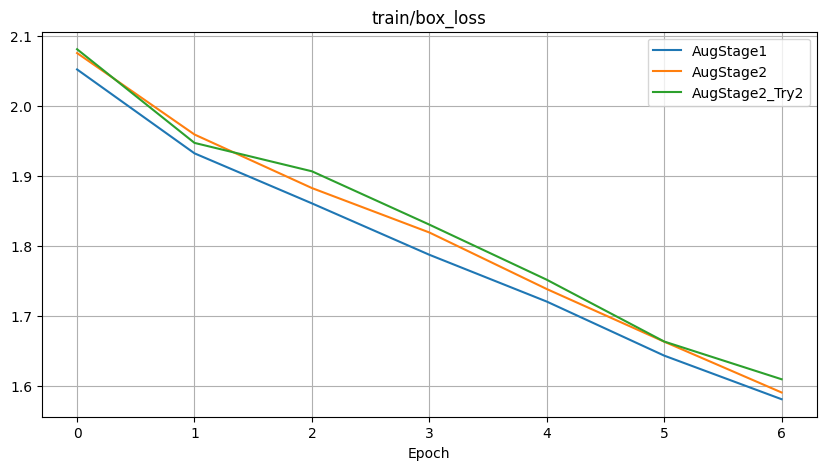

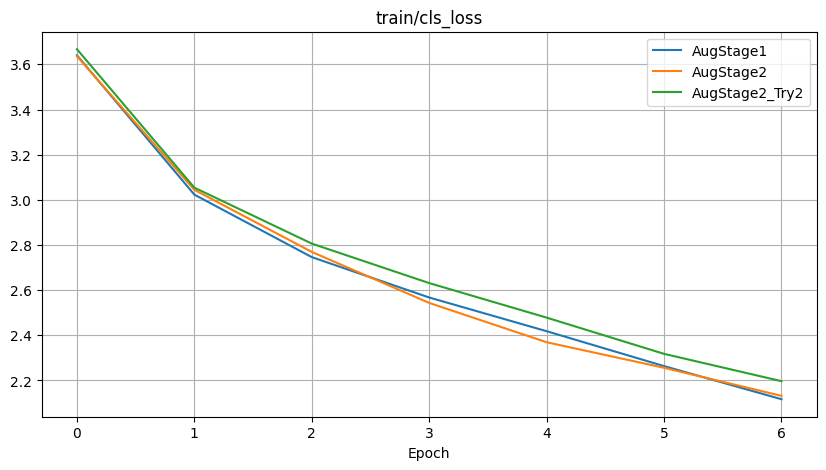

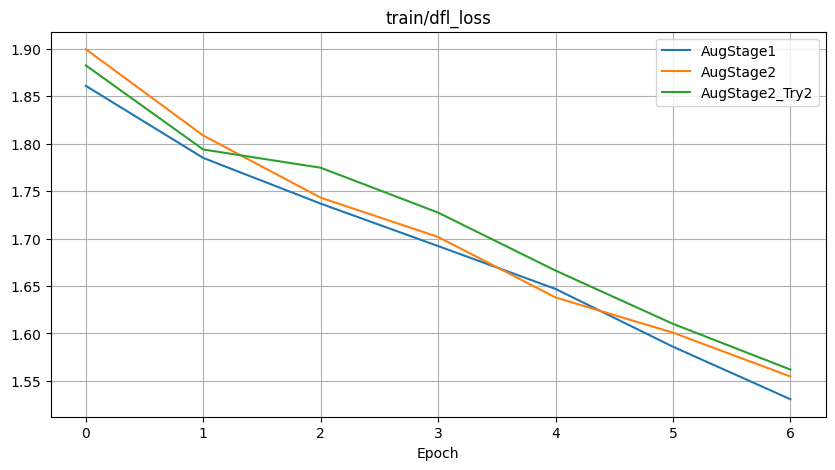

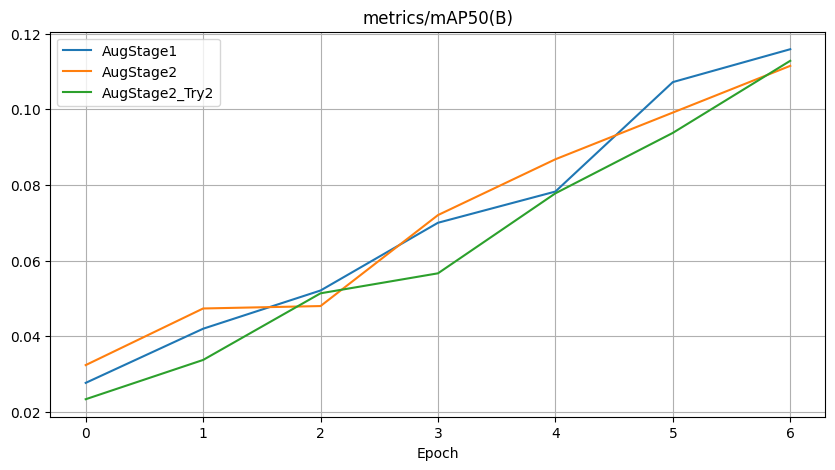

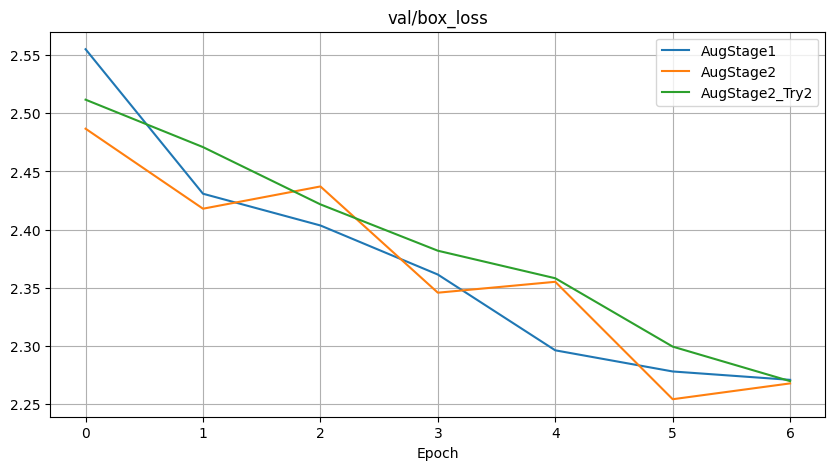

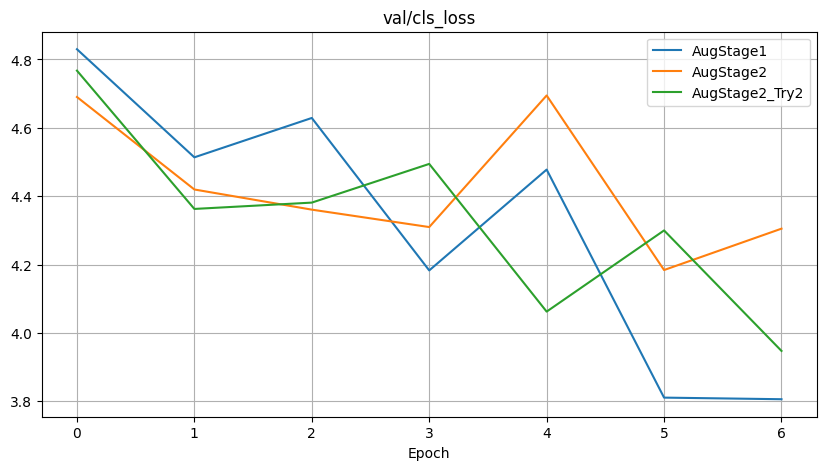

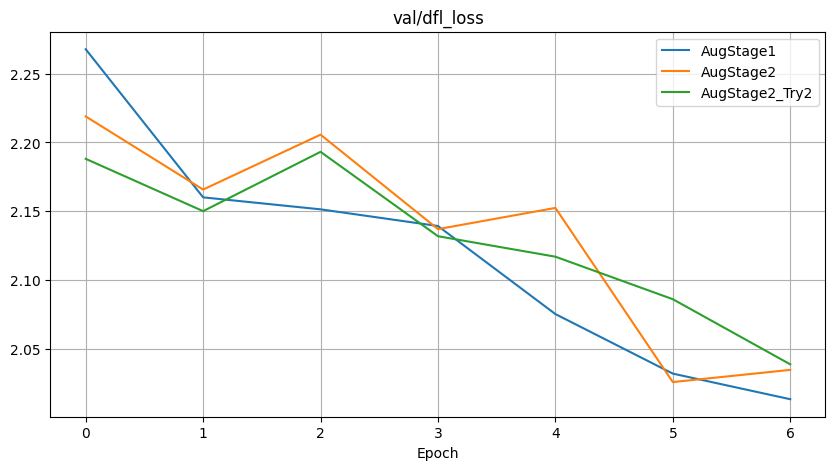

In [ ]:
results_augstage1 = pd.read_csv("/content/saves/AugStage1/results.csv")
results_augstage2 = pd.read_csv("/content/saves/AugStage2/results.csv")
plot_model_metrics([("AugStage1", results_augstage1),
                    ("AugStage2", results_augstage2),
                    ("AugStage2_Try2", results_augstage2_2)],
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

Стало еще хуже. Попробуем еще одну стратегию.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
        A.ConstrainedCoarseDropout(num_holes_range=(1, 2),
                                   hole_height_range=(0.1, 0.3),
                                   hole_width_range=(0.1, 0.3),
                                   fill=0, p=1.0),
    ], p=0.3)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

print("Аугментации, которые мы хотим применить:")
for aug in transform.transforms:
    print(f"   • {aug}")

model_stage_2_3 = YOLO('yolov8n.pt')
model_stage_2_3.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    batch=4,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='AugStage2_Try3',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms)
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
Аугментации, которые мы хотим применить:
   • BBoxSafeRandomCrop(p=0.3, erosion_rate=0.0)
   • LongestMaxSize(p=1.0, area_for_downscale=None, interpolation=1, mask_interpolation=0, max_size=640, max_size_hw=None)
   • PadIfNeeded(p=1.0, border_mode=0, fill=(114.0, 114.0, 114.0), fill_mask=0.0, min_height=640, min_width=640, pad_height_divisor=None, pad_width_divisor=None, padding=0, position='center')
   • HorizontalFlip(p=0.5)
   • OneOf([
  CoarseDropout(p=1.0, fill=0.0, fill_mask=None, hole_height_range=(0.1, 0.2), hole_width_range=(0.1, 0.2), num_holes_range=(1, 2)),
  GridDropout(p=1.0, fill=0.0, fill_mask=None, holes_number_xy=None, random_offset=True, ratio=0.3, shift_xy=(0, 0), unit_size_range=None),
  ConstrainedCoarseDropout(p=1.0, bbox_labels=None, fill=0.0, fill_m

/usr/local/lib/python3.12/dist-packages/albumentations/core/transforms_interface.py:265: UserWarning: Neither valid mask nor bboxes provided, do not apply Constrained Coarse Dropout
  params_dependent_on_data = self.get_params_dependent_on_data(params=params, data=kwargs)
/usr/local/lib/python3.12/dist-packages/albumentations/core/transforms_interface.py:265: UserWarning: Neither valid mask nor bboxes provided, do not apply Constrained Coarse Dropout
  params_dependent_on_data = self.get_params_dependent_on_data(params=params, data=kwargs)


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 147.1±113.1 MB/s, size: 825.9 KB)
val: Scanning /content/data/RDD_SPLIT/val/labels.cache... 5754 images, 1837 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 5754/5754 3.9Mit/s 0.0s
val: /content/data/RDD_SPLIT/val/images/Japan_006536.jpg: 1 duplicate labels removed
WARNING ⚠️ val: 8.5GB RAM required to cache images with 50% safety margin but only 2.0/12.7GB available, not caching images
Plotting labels to /content/saves/AugStage2_Try3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/saves/AugStage2_Try3
Starting training for 7 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ed82cc2aae0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
!zip -q -r /content/zip_saves/AugStage2_Try3.zip /content/saves/AugStage2_Try3

In [ ]:
results_augstage2_3 = pd.read_csv("/content/saves/AugStage2_Try3/results.csv")
results_augstage2_3

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,193.630,2.08961,3.69587,1.89513,0.09194,0.07395,0.02900,0.01030,2.44028,6.06571,2.20711,0.000370,0.000370,0.000370
1,2,366.825,1.95925,3.04500,1.81263,0.12779,0.10667,0.03824,0.01457,2.50333,5.14701,2.25189,0.000635,0.000635,0.000635
2,3,538.214,1.90829,2.80912,1.77205,0.12069,0.10836,0.04389,0.01593,2.48049,4.25878,2.14051,0.000796,0.000796,0.000796
3,4,711.598,1.81297,2.62863,1.73434,0.15886,0.12297,0.05790,0.02366,2.33980,4.92399,2.12090,0.000640,0.000640,0.000640
4,5,881.580,1.73717,2.46896,1.65459,0.17683,0.13280,0.07579,0.03395,2.32717,4.10842,2.09836,0.000482,0.000482,0.000482
5,6,1050.650,1.65428,2.31570,1.60415,0.23227,0.14675,0.09389,0.04218,2.30906,4.07157,2.07486,0.000325,0.000325,0.000325
6,7,1221.140,1.59310,2.18817,1.54928,0.25635,0.15122,0.10777,0.04847,2.30526,3.99058,2.09239,0.000168,0.000168,0.000168


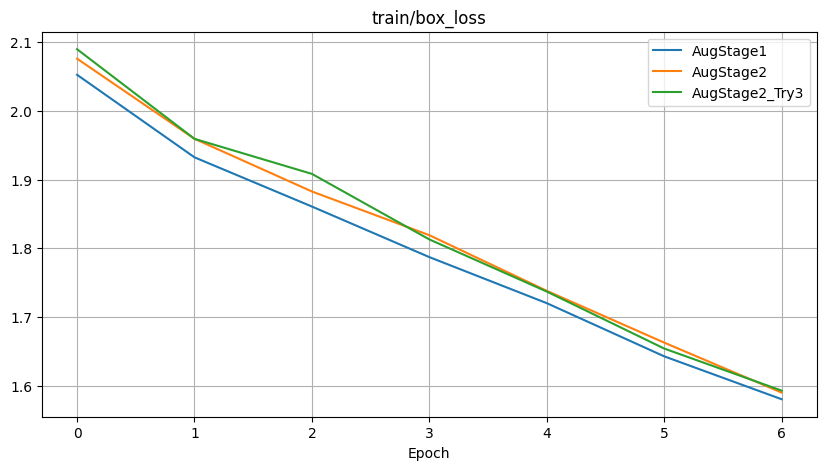

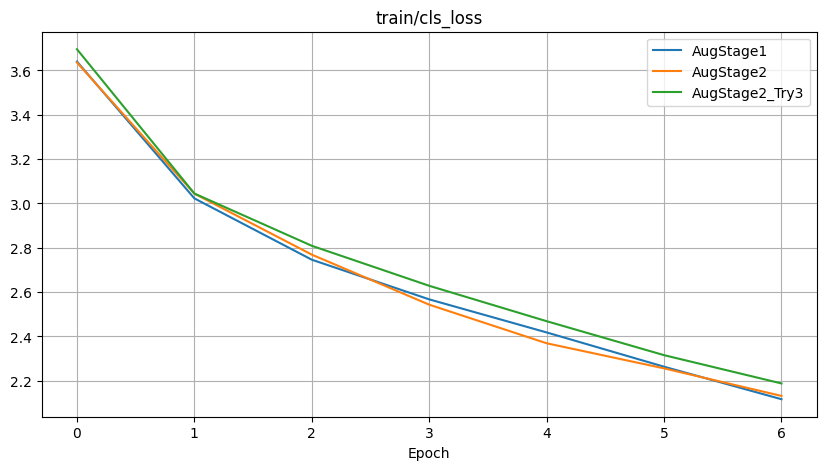

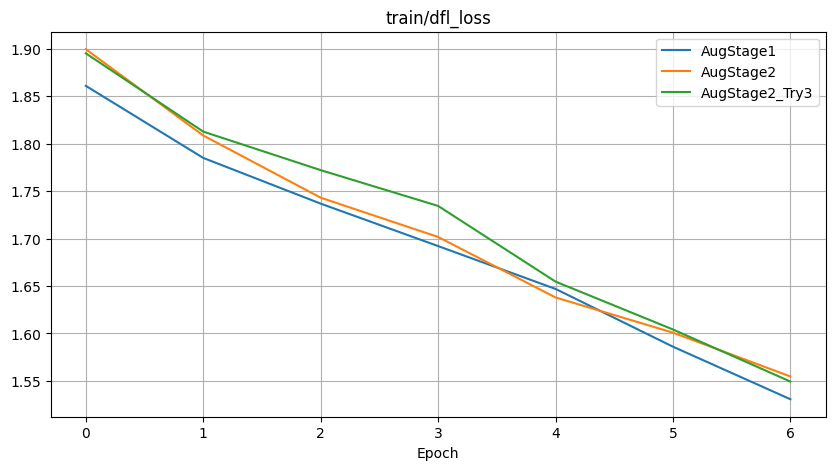

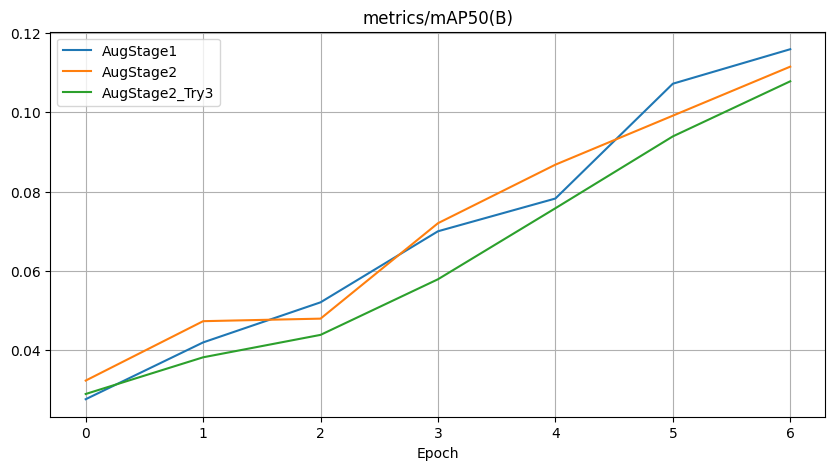

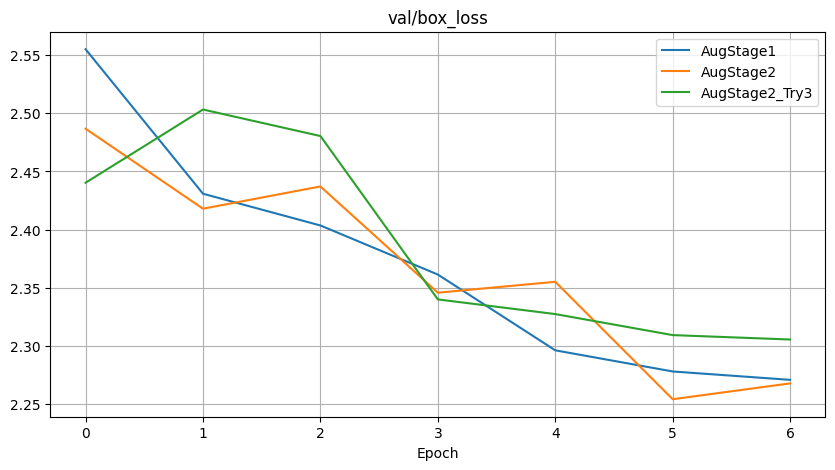

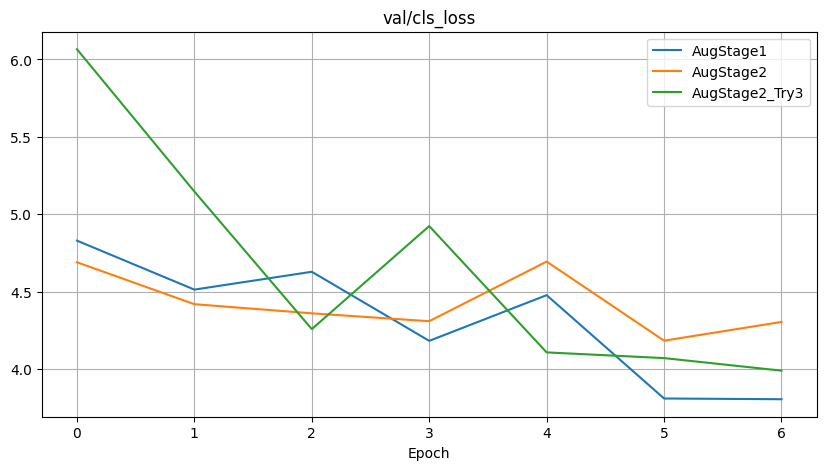

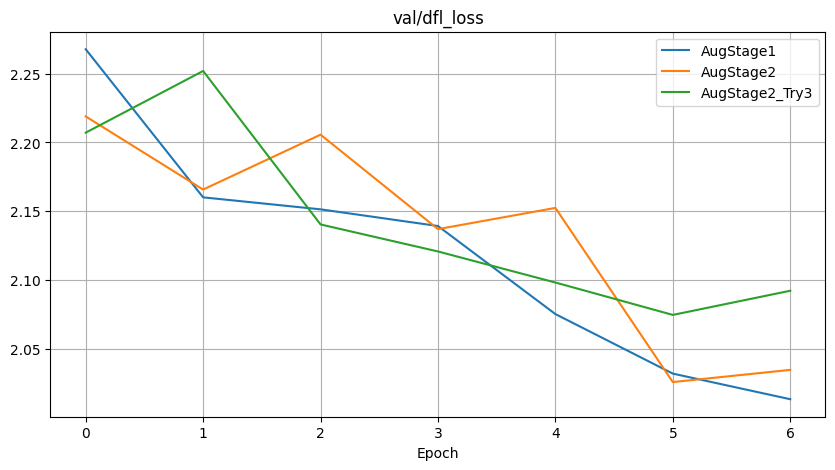

In [ ]:
results_augstage1 = pd.read_csv("/content/saves/AugStage1/results.csv")
results_augstage2 = pd.read_csv("/content/saves/AugStage2/results.csv")
plot_model_metrics([("AugStage1", results_augstage1),
                    ("AugStage2", results_augstage2),
                    ("AugStage2_Try3", results_augstage2_3)],
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

Последняя попытка:

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

print("Аугментации, которые мы хотим применить:")
for aug in transform.transforms:
    print(f"   • {aug}")

model_stage_2_4 = YOLO('yolov8n.pt')
model_stage_2_4.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    batch=4,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='AugStage2_Try4',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms)
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
Аугментации, которые мы хотим применить:
   • BBoxSafeRandomCrop(p=0.3, erosion_rate=0.0)
   • LongestMaxSize(p=1.0, area_for_downscale=None, interpolation=1, mask_interpolation=0, max_size=640, max_size_hw=None)
   • PadIfNeeded(p=1.0, border_mode=0, fill=(114.0, 114.0, 114.0), fill_mask=0.0, min_height=640, min_width=640, pad_height_divisor=None, pad_width_divisor=None, padding=0, position='center')
   • HorizontalFlip(p=0.5)
   • OneOf([
  CoarseDropout(p=1.0, fill=0.0, fill_mask=None, hole_height_range=(0.1, 0.2), hole_width_range=(0.1, 0.2), num_holes_range=(1, 2)),
  GridDropout(p=1.0, fill=0.0, fill_mask=None, holes_number_xy=None, random_offset=True, ratio=0.3, shift_xy=(0, 0), unit_size_range=None),
], p=0.2)
Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUD

In [ ]:
!zip -q -r /content/zip_saves/AugStage2_Try4.zip /content/saves/AugStage2_Try4

In [ ]:
results_augstage2_4 = pd.read_csv("/content/saves/AugStage2_Try4/results.csv")
results_augstage2_4

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,190.346,2.07327,3.68948,1.89024,0.09850,0.07131,0.02667,0.01008,2.46766,5.63829,2.20283,0.000370,0.000370,0.000370
1,2,380.505,1.95486,3.06141,1.80017,0.17419,0.10088,0.04648,0.01689,2.42405,5.30369,2.18553,0.000635,0.000635,0.000635
2,3,572.393,1.89270,2.81486,1.77534,0.14310,0.11116,0.05308,0.02000,2.38694,4.36057,2.10057,0.000796,0.000796,0.000796
3,4,752.838,1.82049,2.63721,1.72430,0.16165,0.12000,0.05987,0.02491,2.38274,4.18711,2.12141,0.000640,0.000640,0.000640
4,5,934.183,1.74202,2.48219,1.66255,0.19182,0.13823,0.07881,0.03460,2.32720,3.99300,2.09423,0.000482,0.000482,0.000482
5,6,1118.120,1.65159,2.32026,1.59679,0.23009,0.14860,0.09840,0.04423,2.24711,3.88847,2.01139,0.000325,0.000325,0.000325
6,7,1303.870,1.60626,2.18647,1.56077,0.25592,0.15063,0.11181,0.05051,2.25854,3.85434,2.06222,0.000168,0.000168,0.000168


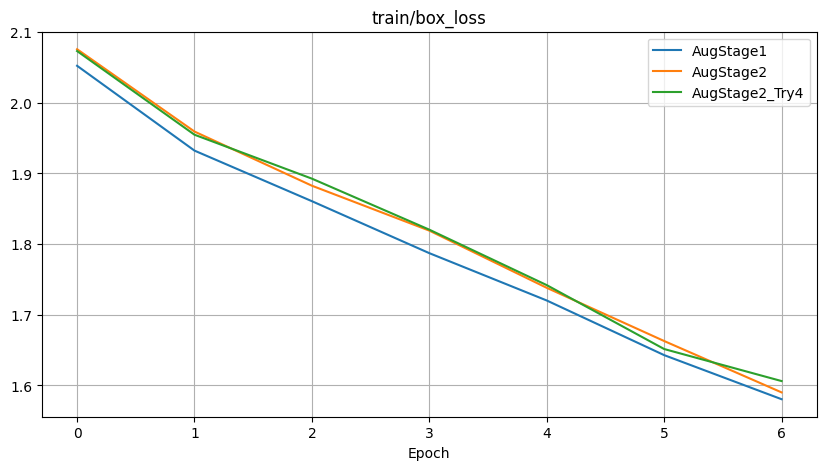

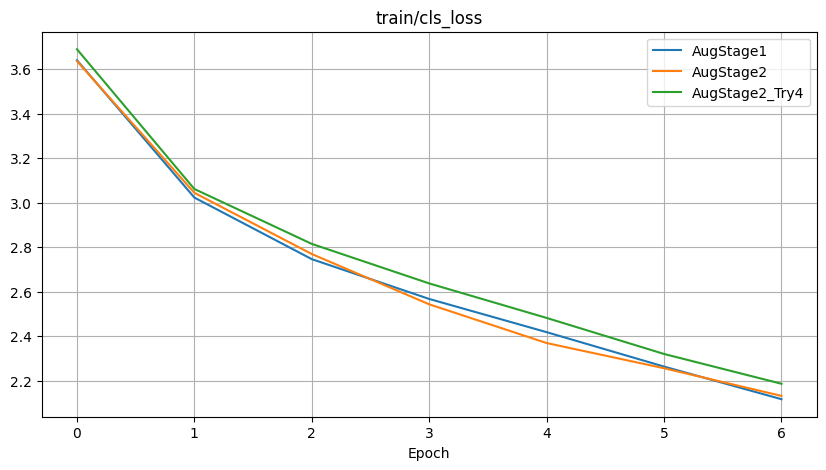

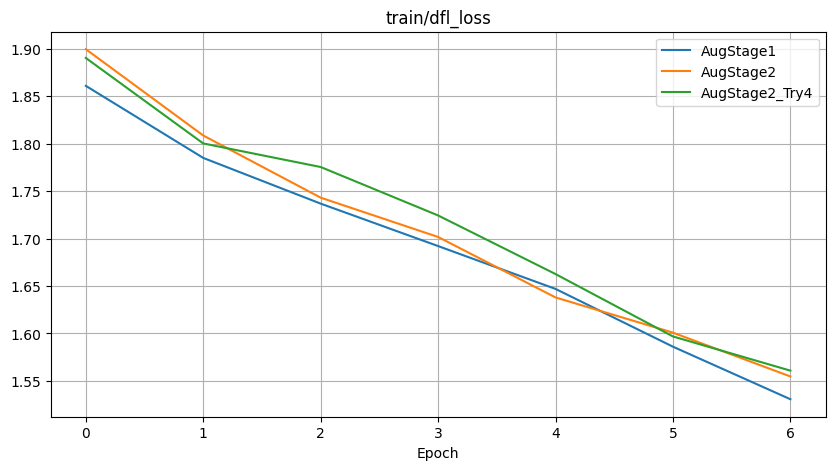

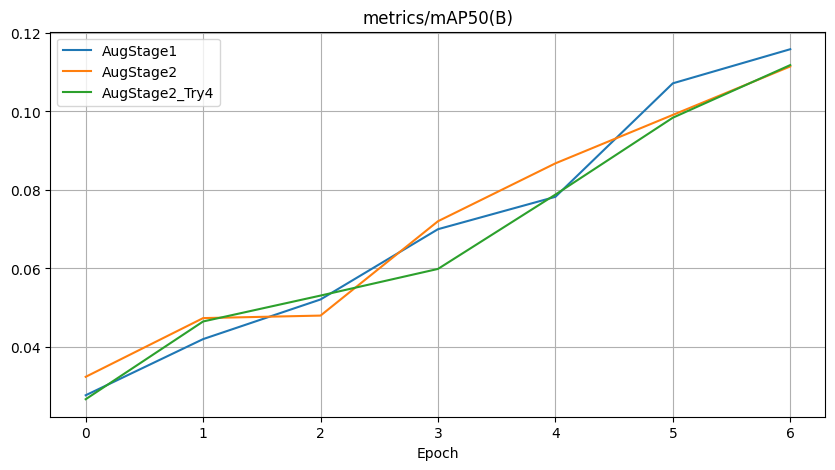

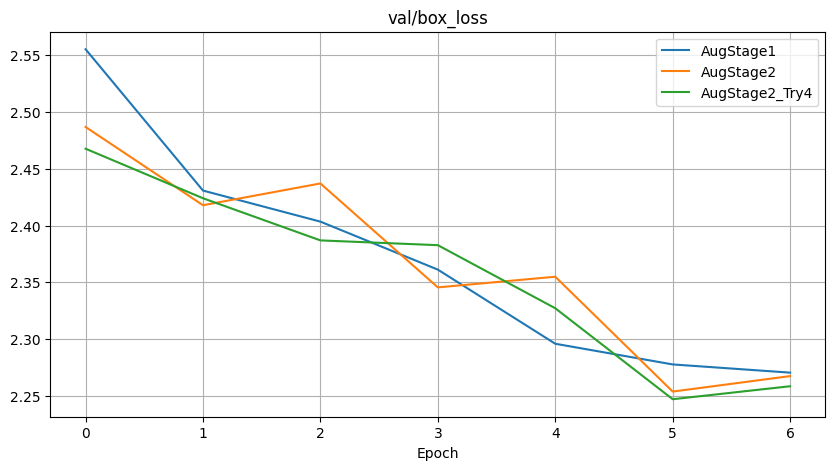

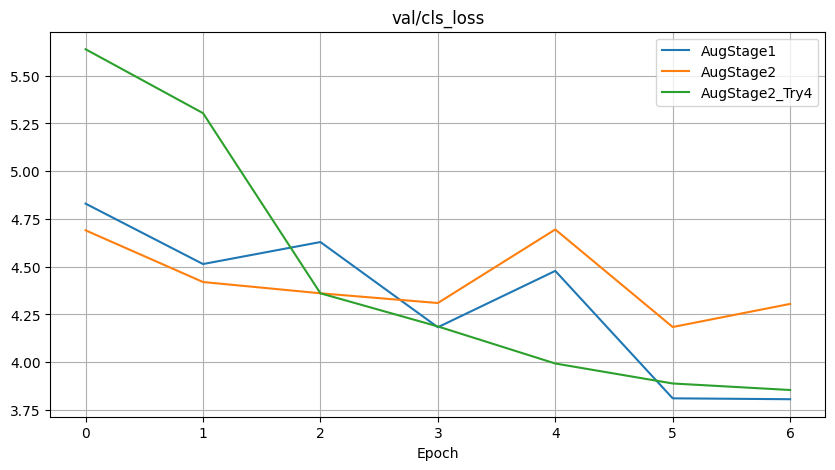

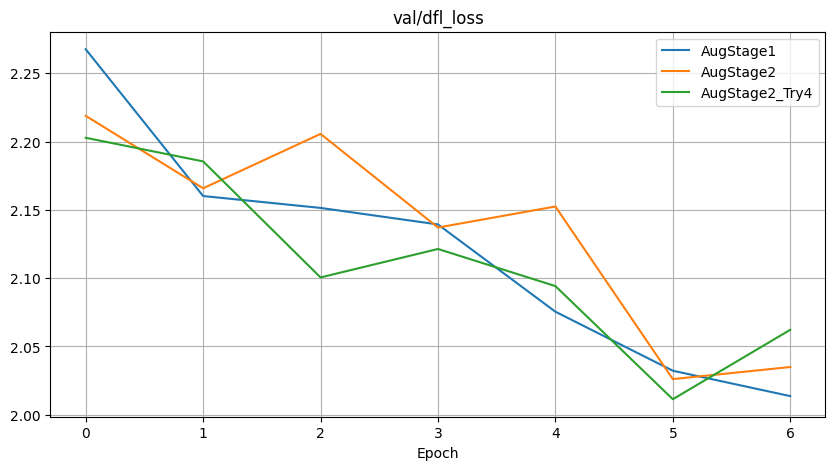

In [ ]:
results_augstage1 = pd.read_csv("/content/saves/AugStage1/results.csv")
results_augstage2 = pd.read_csv("/content/saves/AugStage2/results.csv")
plot_model_metrics([("AugStage1", results_augstage1),
                    ("AugStage2", results_augstage2),
                    ("AugStage2_Try4", results_augstage2_4)],
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

Такое поведения нас устраивает. На трейновой части мы видим, что применение аугментаций дает регуляризации, при этом на валидационной части - лучшие результаты. Оставляем это вариант.

### **Стадия 3**

Уменьшение зависимости от характеристик цвета + Изменения цвета и освещения.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        # делает изображение ч/б
        A.ToGray(p=1.0),
        # удаляет 1 или 2 цветовых канала
        A.ChannelDropout(p=1.0)
    ], p=0.1),
    A.OneOf([
        # делает изображение ч/б
        A.ToGray(p=1.0),
        # удаляет 1 или 2 цветовых канала
        A.ChannelDropout(p=1.0)
    ], p=0.1),
    # выше случайно задвоилась операция, далее это исправлено
    # различные преобразования для цвета, яркости и т.п.
    A.OneOf([
        A.RandomBrightnessContrast(brightness_limit=0.25, contrast_limit=0.25, p=1.0),
        A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1, p=1.0),
        A.RandomGamma(gamma_limit=(70, 130), p=1.0),
        A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=20, val_shift_limit=20, p=1.0),
        A.PlanckianJitter(temperature_min=3000, temperature_max=12000, p=1.0),
    ], p=0.4)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

print("Аугментации, которые мы хотим применить:")
for aug in transform.transforms:
    print(f"   • {aug}")

model_stage_3 = YOLO('yolov8n.pt')
model_stage_3.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    batch=4,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='AugStage3',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms)
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
Аугментации, которые мы хотим применить:
   • BBoxSafeRandomCrop(p=0.3, erosion_rate=0.0)
   • LongestMaxSize(p=1.0, area_for_downscale=None, interpolation=1, mask_interpolation=0, max_size=640, max_size_hw=None)
   • PadIfNeeded(p=1.0, border_mode=0, fill=(114.0, 114.0, 114.0), fill_mask=0.0, min_height=640, min_width=640, pad_height_divisor=None, pad_width_divisor=None, padding=0, position='center')
   • HorizontalFlip(p=0.5)
   • OneOf([
  CoarseDropout(p=1.0, fill=0.0, fill_mask=None, hole_height_range=(0.1, 0.2), hole_width_range=(0.1, 0.2), num_holes_range=(1, 2)),
  GridDropout(p=1.0, fill=0.0, fill_mask=None, holes_number_xy=None, random_offset=True, ratio=0.3, shift_xy=(0, 0), unit_size_range=None),
], p=0.2)
   • OneOf([
  ToGray(p=1.0, method='weighted_average', nu

/tmp/ipython-input-1468895719.py:38: UserWarning: Argument(s) 'temperature_min, temperature_max' are not valid for transform PlanckianJitter
  A.PlanckianJitter(temperature_min=3000, temperature_max=12000, p=1.0),


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7fb3496817c0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
!zip -q -r /content/zip_saves/AugStage3.zip /content/saves/AugStage3

In [ ]:
results_augstage3 = pd.read_csv("/content/saves/AugStage3/results.csv")
results_augstage3

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,193.720,2.06348,3.64997,1.90653,0.07991,0.07405,0.02139,0.00747,2.41307,5.07888,2.18727,0.000370,0.000370,0.000370
1,2,353.163,1.95228,3.07155,1.80687,0.15049,0.10903,0.03712,0.01480,2.35849,5.19135,2.14748,0.000635,0.000635,0.000635
2,3,509.592,1.87926,2.79173,1.73258,0.18523,0.11490,0.05291,0.02012,2.42951,4.03679,2.17784,0.000796,0.000796,0.000796
3,4,667.785,1.80972,2.58232,1.71553,0.15257,0.13328,0.06021,0.02491,2.37327,4.13570,2.11862,0.000640,0.000640,0.000640
4,5,825.550,1.73139,2.41462,1.65183,0.19880,0.15540,0.08692,0.03671,2.34827,4.63714,2.08069,0.000482,0.000482,0.000482
5,6,982.613,1.67199,2.29151,1.60647,0.16169,0.15908,0.08591,0.03729,2.28805,4.53794,2.07258,0.000325,0.000325,0.000325
6,7,1138.550,1.58723,2.16724,1.55586,0.22599,0.16523,0.11319,0.05195,2.26665,4.17283,2.04839,0.000168,0.000168,0.000168


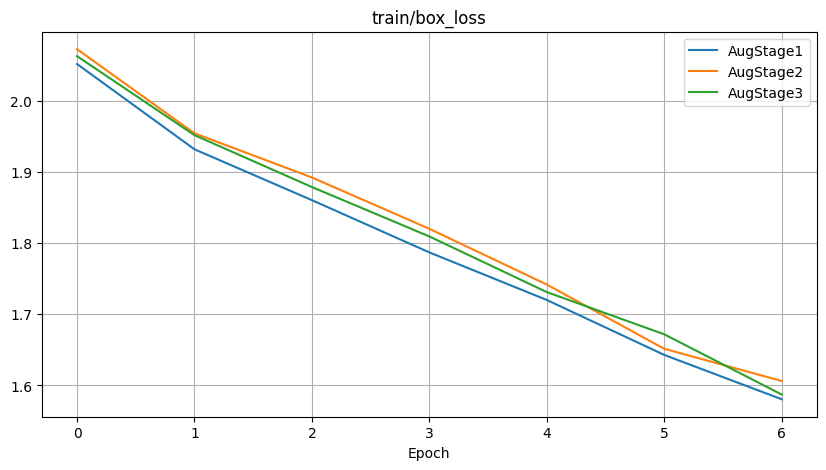

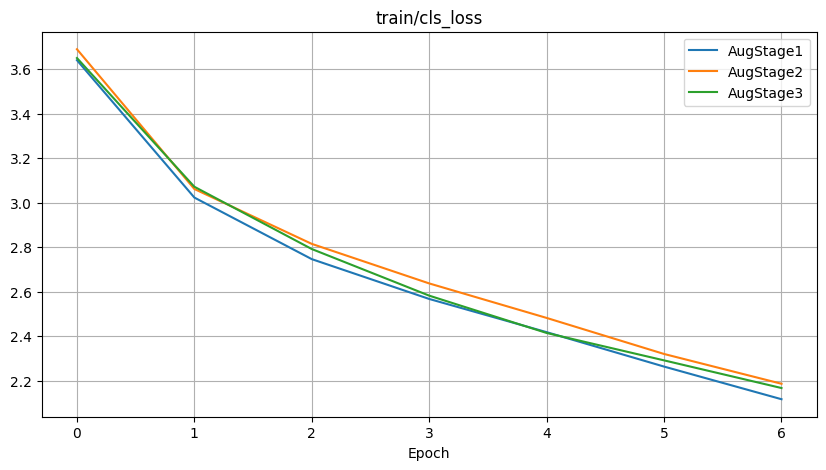

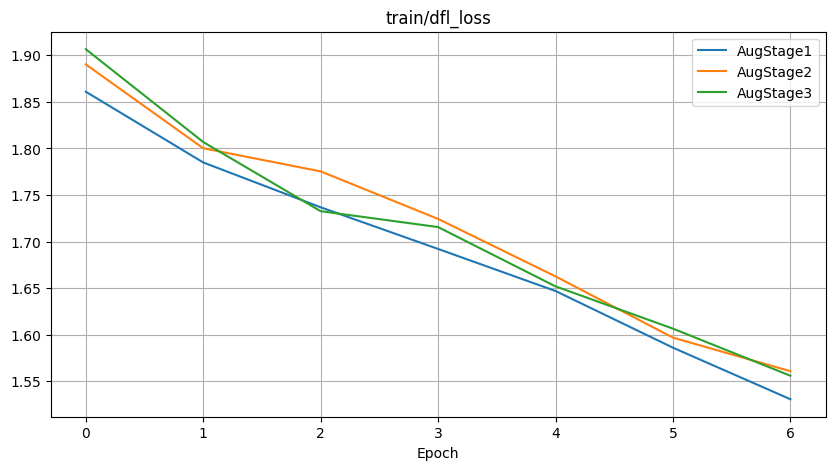

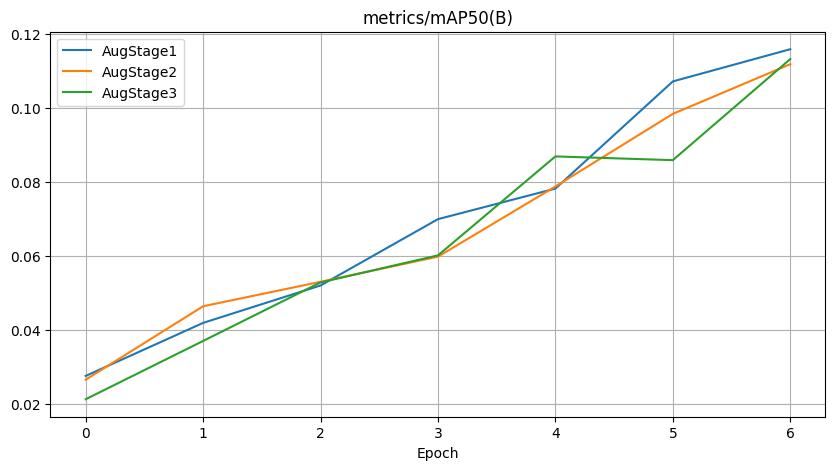

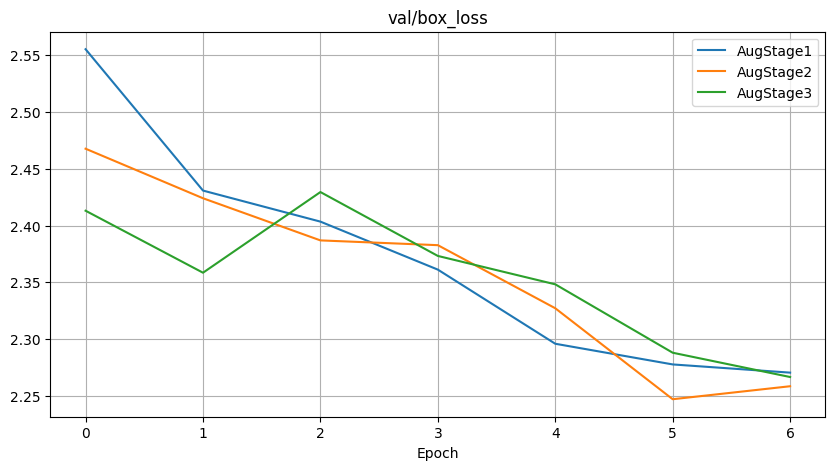

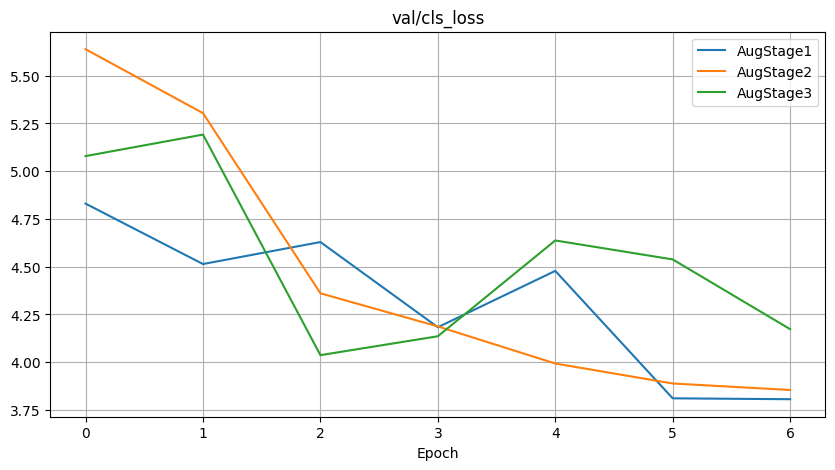

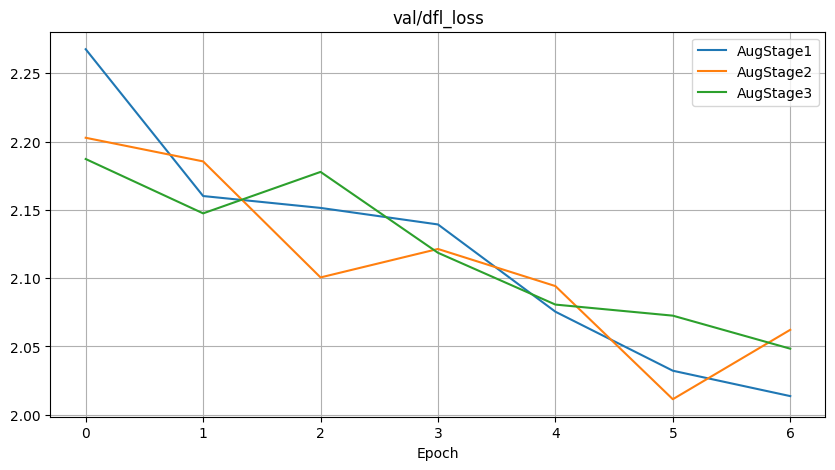

In [ ]:
results_augstage1 = pd.read_csv("/content/saves/AugStage1/results.csv")
results_augstage2 = pd.read_csv("/content/saves/AugStage2_Try4/results.csv")
plot_model_metrics([("AugStage1", results_augstage1),
                    ("AugStage2", results_augstage2),
                    ("AugStage3", results_augstage3)],
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

Попробуем другую стратегию:

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        # делает изображение ч/б
        A.ToGray(p=1.0),
        # удаляет 1 или 2 цветовых канала
        A.ChannelDropout(p=1.0)
    ], p=0.1),
    # различные преобразования для цвета, яркости и т.п.
    A.OneOf([
        A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=1.0),
        A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05, p=1.0),
        A.RandomGamma(gamma_limit=(85, 115), p=1.0),
        A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=10, p=1.0),
        A.PlanckianJitter(temperature_min=4000, temperature_max=9000, p=1.0),
    ], p=0.3)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

print("Аугментации, которые мы хотим применить:")
for aug in transform.transforms:
    print(f"   • {aug}")

model_stage_3_2 = YOLO('yolov8n.pt')
model_stage_3_2.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    batch=4,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='AugStage3_Try2',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms)
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/tmp/ipython-input-210980411.py:32: UserWarning: Argument(s) 'temperature_min, temperature_max' are not valid for transform PlanckianJitter
  A.PlanckianJitter(temperature_min=4000, temperature_max=9000, p=1.0),


Аугментации, которые мы хотим применить:
   • BBoxSafeRandomCrop(p=0.3, erosion_rate=0.0)
   • LongestMaxSize(p=1.0, area_for_downscale=None, interpolation=1, mask_interpolation=0, max_size=640, max_size_hw=None)
   • PadIfNeeded(p=1.0, border_mode=0, fill=(114.0, 114.0, 114.0), fill_mask=0.0, min_height=640, min_width=640, pad_height_divisor=None, pad_width_divisor=None, padding=0, position='center')
   • HorizontalFlip(p=0.5)
   • OneOf([
  CoarseDropout(p=1.0, fill=0.0, fill_mask=None, hole_height_range=(0.1, 0.2), hole_width_range=(0.1, 0.2), num_holes_range=(1, 2)),
  GridDropout(p=1.0, fill=0.0, fill_mask=None, holes_number_xy=None, random_offset=True, ratio=0.3, shift_xy=(0, 0), unit_size_range=None),
], p=0.2)
   • OneOf([
  ToGray(p=1.0, method='weighted_average', num_output_channels=3),
  ChannelDropout(p=1.0, channel_drop_range=(1, 1), fill=0.0),
], p=0.1)
   • OneOf([
  RandomBrightnessContrast(p=1.0, brightness_by_max=True, brightness_limit=(-0.15, 0.15), contrast_limit=(-

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d15d2c9cf50>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
src_dir = "/content/saves/AugStage3_Try2"
dst_zip = "/content/zip_saves/AugStage3_Try2"

shutil.make_archive(dst_zip, 'zip', src_dir)

In [ ]:
results_augstage3_2 = pd.read_csv("/content/saves/AugStage3_Try2/results.csv")
results_augstage3_2

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,180.370,2.05234,3.67591,1.90550,0.11869,0.09022,0.03153,0.01196,2.52540,5.25376,2.13876,0.000370,0.000370,0.000370
1,2,342.910,1.93639,3.07678,1.80770,0.10041,0.11247,0.04308,0.01613,2.40701,4.14065,2.11835,0.000635,0.000635,0.000635
2,3,503.169,1.85860,2.76637,1.74268,0.17714,0.10974,0.05068,0.01922,2.44313,5.16034,2.21002,0.000796,0.000796,0.000796
3,4,658.789,1.80707,2.56612,1.71120,0.16874,0.13308,0.06138,0.02645,2.32475,4.50266,2.11029,0.000640,0.000640,0.000640
4,5,813.253,1.72012,2.40877,1.64604,0.20868,0.13358,0.07544,0.03353,2.37763,4.25343,2.07706,0.000482,0.000482,0.000482
5,6,968.486,1.66087,2.25577,1.59236,0.19931,0.15828,0.09468,0.04198,2.32194,4.75001,2.05180,0.000325,0.000325,0.000325
6,7,1122.800,1.58018,2.12048,1.54596,0.22541,0.15803,0.11055,0.04854,2.32248,4.71102,2.05382,0.000168,0.000168,0.000168


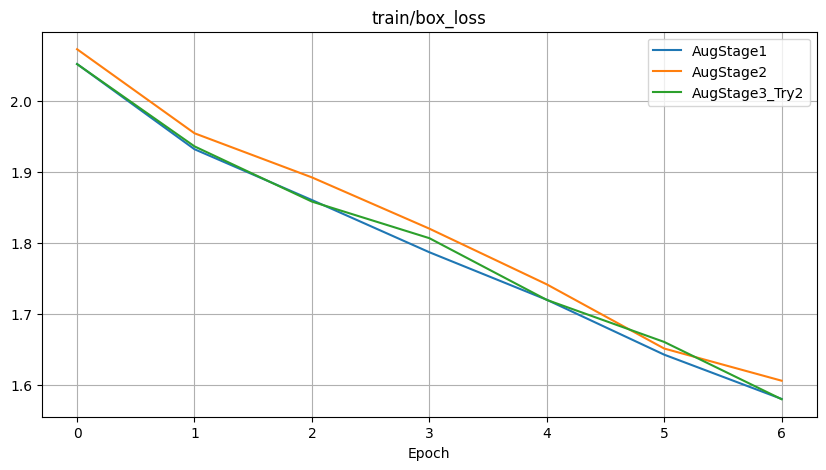

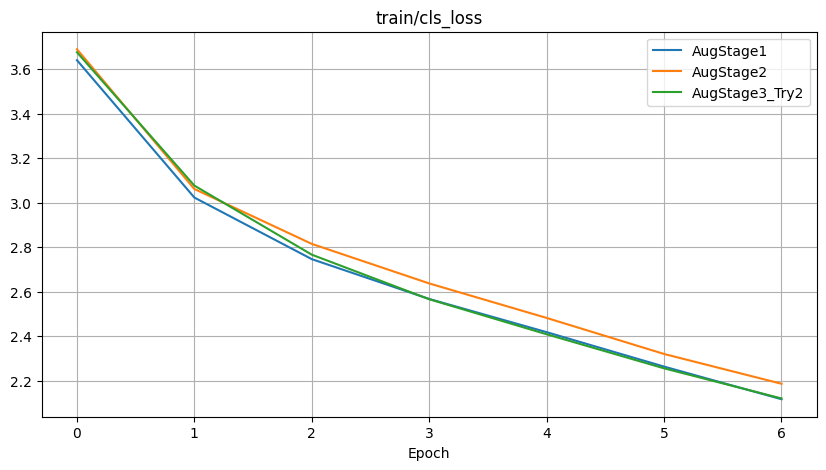

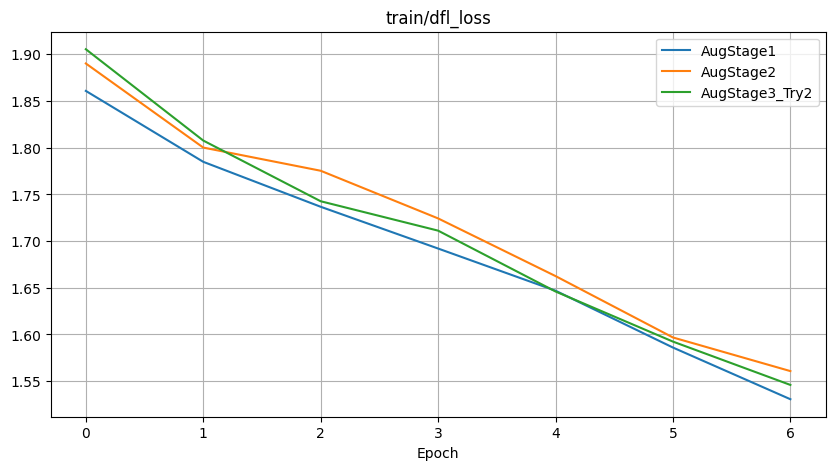

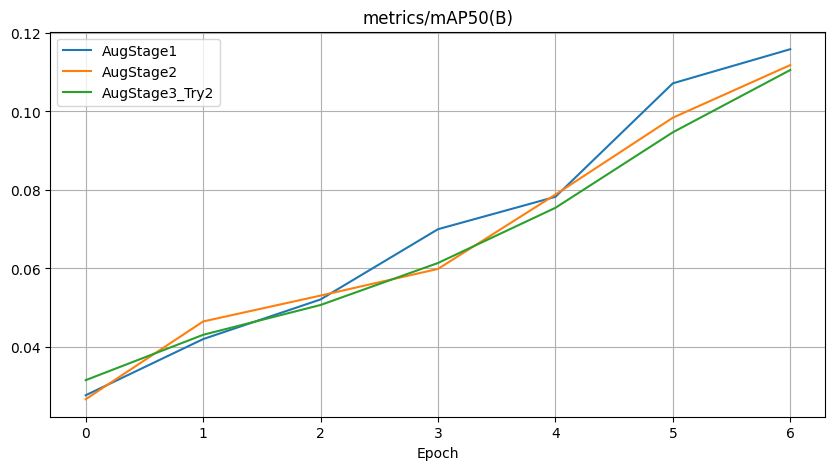

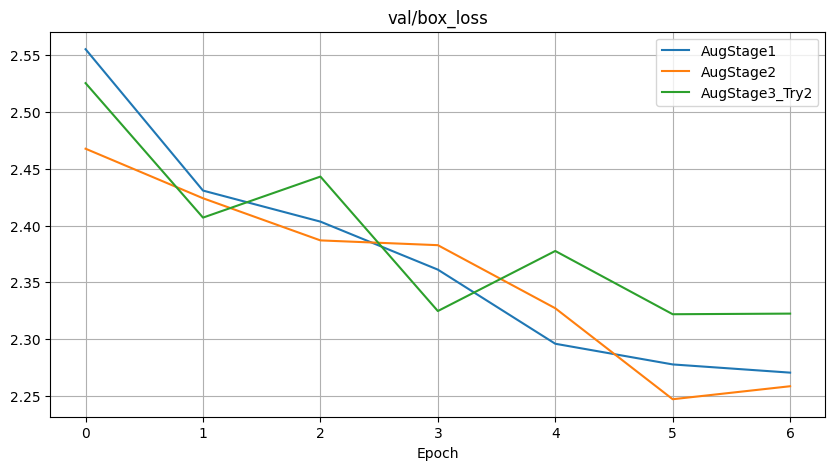

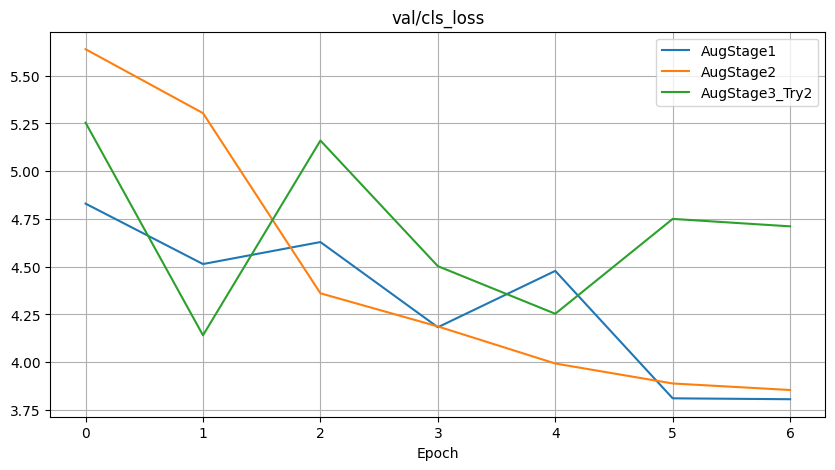

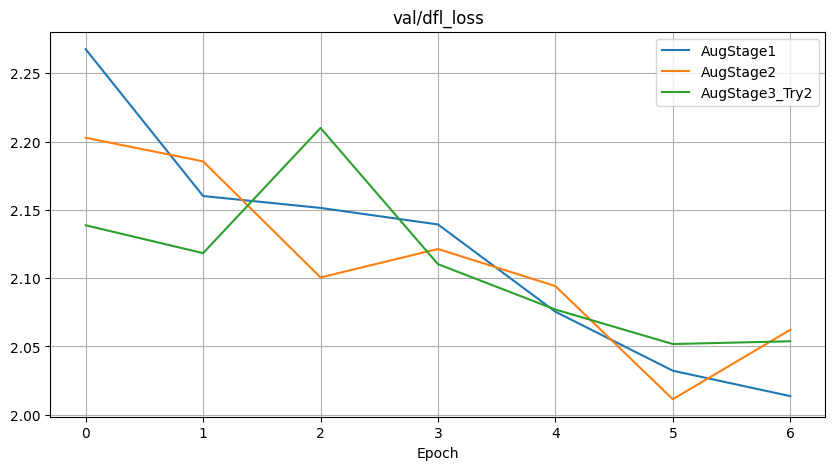

In [ ]:
results_augstage1 = pd.read_csv("/content/saves/AugStage1/content/saves/AugStage1/results.csv")
results_augstage2 = pd.read_csv("/content/saves/AugStage2_Try4/content/saves/AugStage2_Try4/results.csv")
plot_model_metrics([("AugStage1", results_augstage1),
                    ("AugStage2", results_augstage2),
                    ("AugStage3_Try2", results_augstage3_2)],
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

В целом, на трейновой части этот вариант аугментаций убывает даже быстрее чем после второго этапа. Попробуем еще немного усовершенствовать параметры.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        A.OneOf([
            # делает изображение ч/б
            A.ToGray(p=1.0),
            # удаляет 1 или 2 цветовых канала
            A.ChannelDropout(p=1.0)
        ], p=1.0),
        # различные преобразования для цвета, яркости и т.п.
        A.OneOf([
            A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=1.0),
            A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05, p=1.0),
            A.RandomGamma(gamma_limit=(85, 115), p=1.0),
            A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=10, p=1.0),
            A.PlanckianJitter(temperature_min=4000, temperature_max=9000, p=1.0),
        ], p=1.0)
    ], p=0.15)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']), seed=MANUAL_SEED)

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

print("Аугментации, которые мы хотим применить:")
for aug in transform.transforms:
    print(f"   • {aug}")

model_stage_3_3 = YOLO('yolov8n.pt')
model_stage_3_3.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    batch=4,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='AugStage3_Try3',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms)
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
Аугментации, которые мы хотим применить:
   • BBoxSafeRandomCrop(p=0.3, erosion_rate=0.0)
   • LongestMaxSize(p=1.0, area_for_downscale=None, interpolation=1, mask_interpolation=0, max_size=640, max_size_hw=None)
   • PadIfNeeded(p=1.0, border_mode=0, fill=(114.0, 114.0, 114.0), fill_mask=0.0, min_height=640, min_width=640, pad_height_divisor=None, pad_width_divisor=None, padding=0, position='center')
   • HorizontalFlip(p=0.5)
   • OneOf([
  CoarseDropout(p=1.0, fill=0.0, fill_mask=None, hole_height_range=(0.1, 0.2), hole_width_range=(0.1, 0.2), num_holes_range=(1, 2)),
  GridDropout(p=1.0, fill=0.0, fill_mask=None, holes_number_xy=None, random_offset=True, ratio=0.3, shift_xy=(0, 0), unit_size_range=None),
], p=0.2)
   • OneOf([
  OneOf([
    ToGray(p=1.0, method='weighted_

/tmp/ipython-input-217530676.py:33: UserWarning: Argument(s) 'temperature_min, temperature_max' are not valid for transform PlanckianJitter
  A.PlanckianJitter(temperature_min=4000, temperature_max=9000, p=1.0),


  9                  -1  1    164608  ultralytics.nn.modules.block.SPPF            [256, 256, 5]                 
 10                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 11             [-1, 6]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 12                  -1  1    148224  ultralytics.nn.modules.block.C2f             [384, 128, 1]                 
 13                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 14             [-1, 4]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 15                  -1  1     37248  ultralytics.nn.modules.block.C2f             [192, 64, 1]                  
 16                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
 17            [-1, 12]  1         0  ultralytics.nn.modules.conv.Concat           [1]  

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d15d38041a0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
src_dir = "/content/saves/AugStage3_Try3"
dst_zip = "/content/zip_saves/AugStage3_Try3"

shutil.make_archive(dst_zip, 'zip', src_dir)

'/content/zip_saves/AugStage3_Try3.zip'

In [ ]:
results_augstage3_3 = pd.read_csv("/content/saves/AugStage3_Try3/results.csv")
results_augstage3_3

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,170.853,2.02421,3.67109,1.88560,0.09589,0.07862,0.03283,0.01113,2.57236,5.31080,2.22080,0.000370,0.000370,0.000370
1,2,340.699,1.92744,3.06098,1.78465,0.12296,0.11483,0.04879,0.01891,2.45633,4.39157,2.19376,0.000635,0.000635,0.000635
2,3,512.754,1.86835,2.76726,1.75912,0.19004,0.10868,0.04628,0.01822,2.41559,4.49100,2.20001,0.000796,0.000796,0.000796
3,4,681.193,1.81059,2.54718,1.71735,0.17239,0.13952,0.07293,0.02992,2.35199,4.94251,2.11751,0.000640,0.000640,0.000640
4,5,854.395,1.71242,2.35735,1.63030,0.19124,0.15086,0.08692,0.03578,2.35050,4.03538,2.06568,0.000482,0.000482,0.000482
5,6,1029.760,1.65474,2.22437,1.58584,0.19095,0.14867,0.09596,0.04178,2.32321,4.26852,2.00287,0.000325,0.000325,0.000325
6,7,1198.160,1.58091,2.11875,1.54658,0.21409,0.15935,0.10561,0.04733,2.28545,4.08084,1.96257,0.000168,0.000168,0.000168


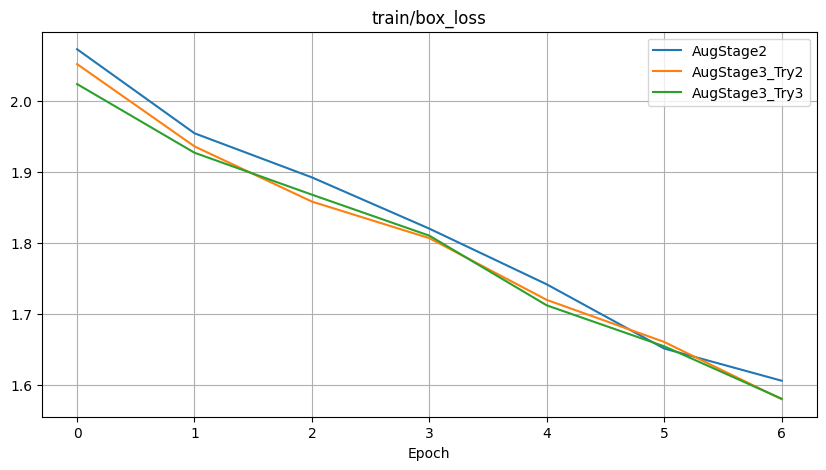

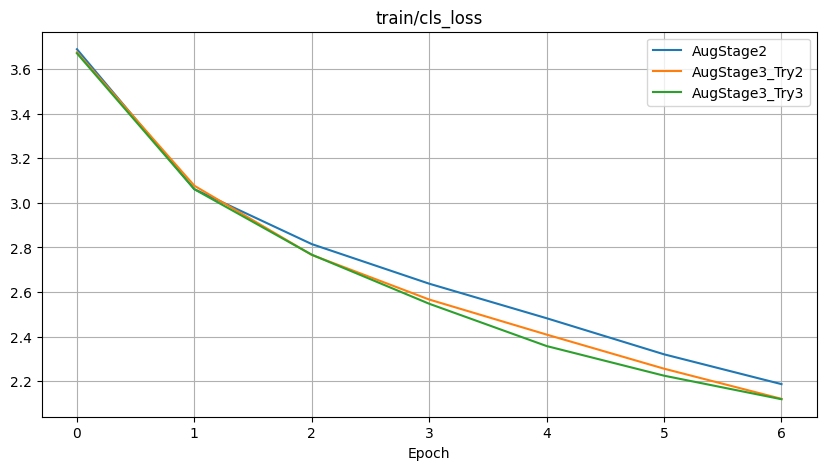

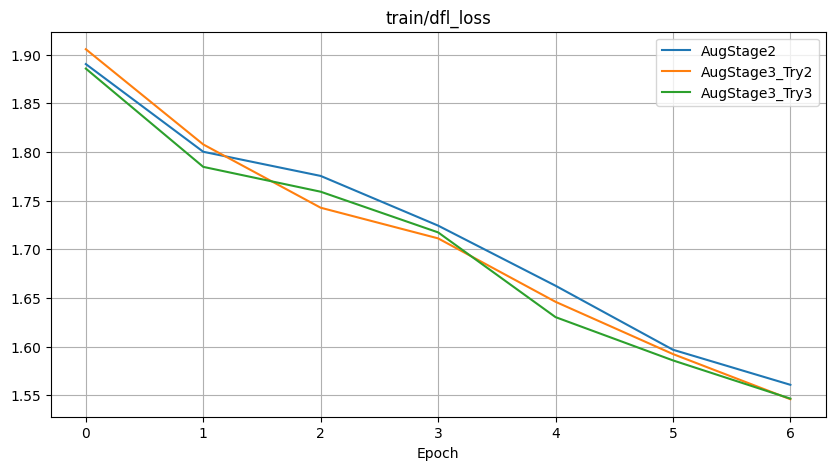

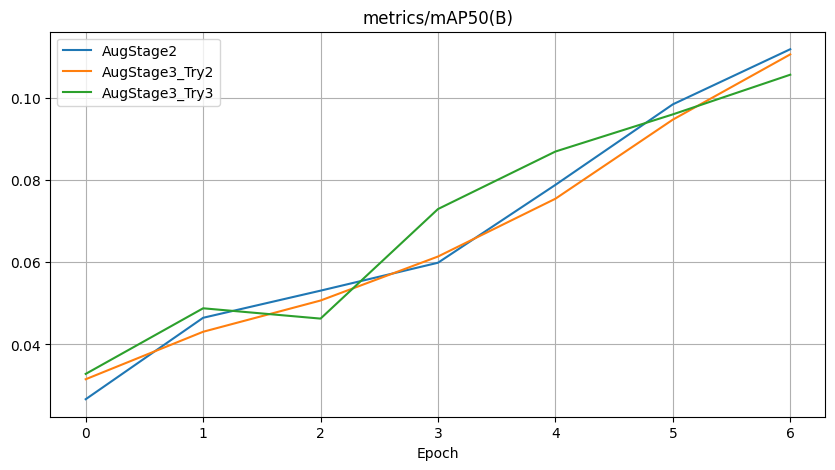

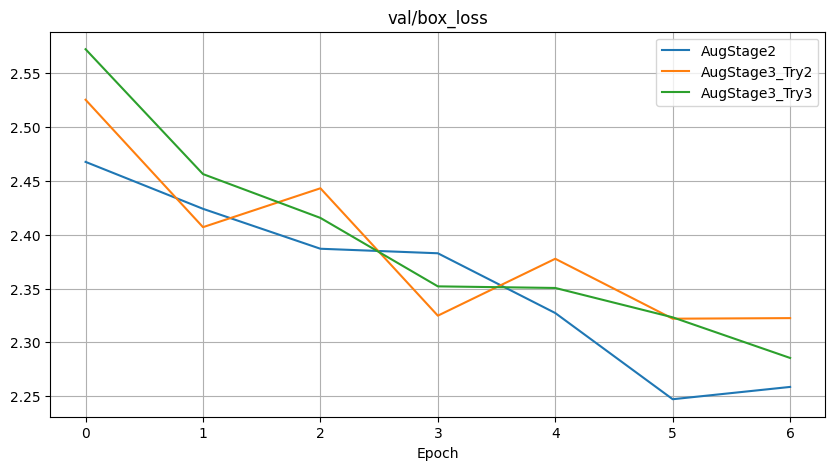

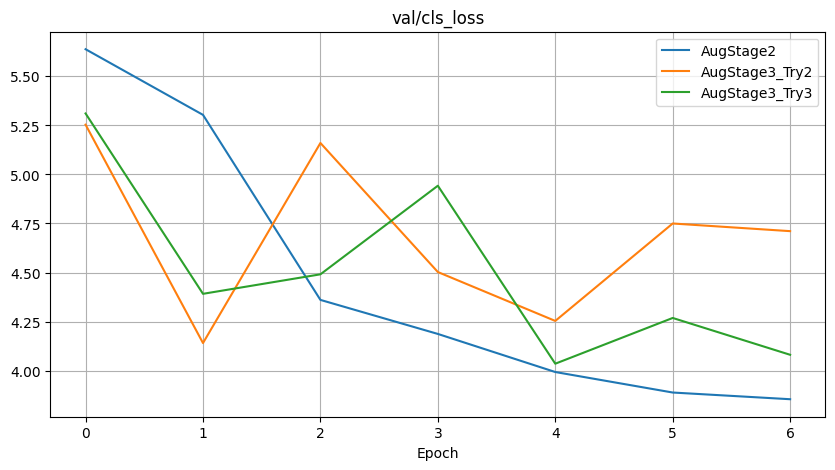

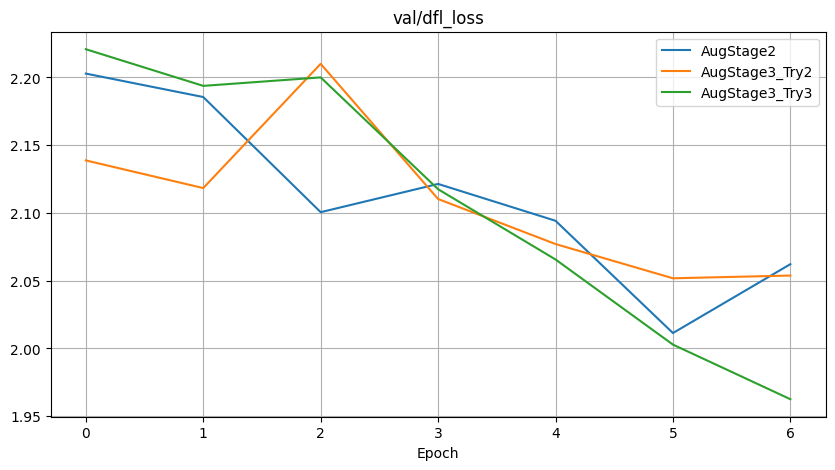

In [ ]:
results_augstage2 = pd.read_csv("/content/saves/AugStage2_Try4/content/saves/AugStage2_Try4/results.csv")
plot_model_metrics([("AugStage2", results_augstage2),
                    ("AugStage3_Try2", results_augstage3_2),
                    ("AugStage3_Try3", results_augstage3_3)],
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

Определенно, стало лучше. Оставляем этот вариант.

Прежде чем продолжать, оценим наши аугментации на адекватность:

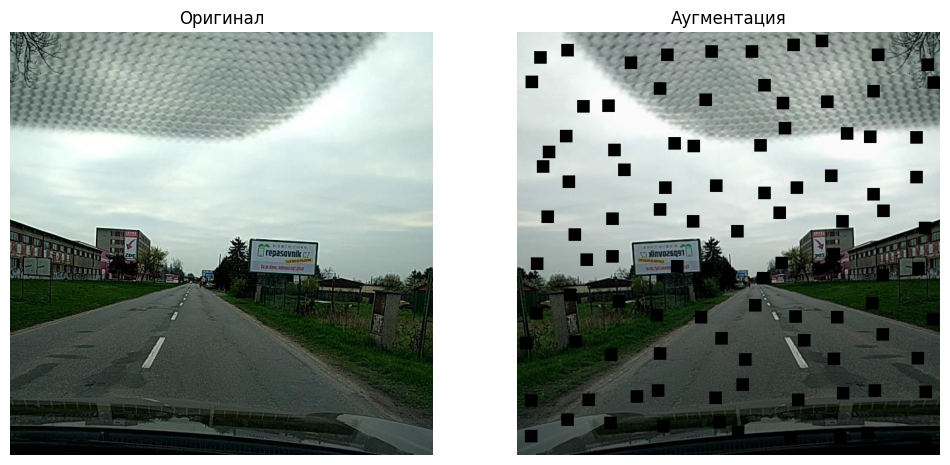

In [ ]:
show_aug_with_boxes("/content/data/RDD_SPLIT/val/images/Czech_002059.jpg", transform)

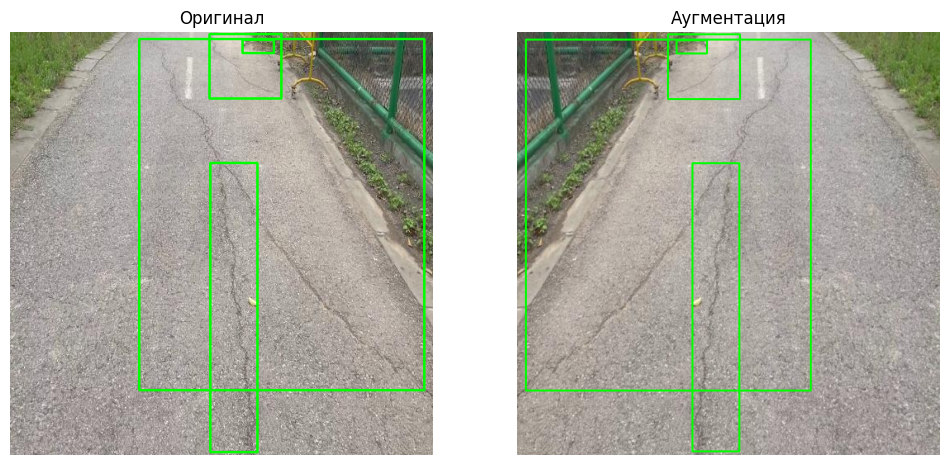

In [ ]:
show_aug_with_boxes("/content/data/RDD_SPLIT/val/images/China_MotorBike_000690.jpg", transform)

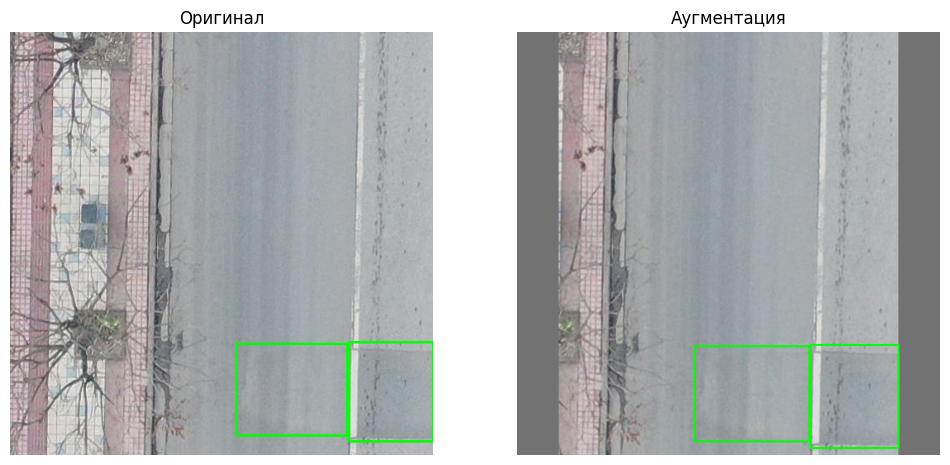

In [ ]:
show_aug_with_boxes("/content/data/RDD_SPLIT/val/images/China_Drone_000912.jpg", transform)

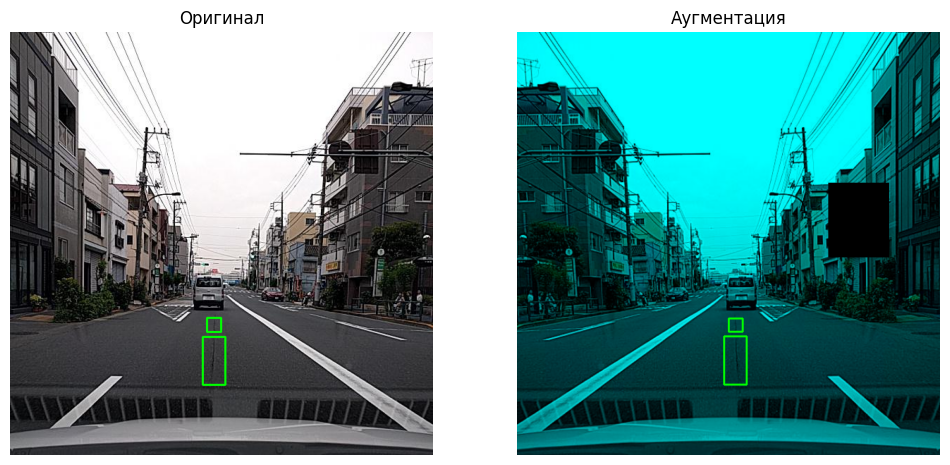

In [ ]:
show_aug_with_boxes("/content/data/RDD_SPLIT/val/images/Japan_008040.jpg", transform)

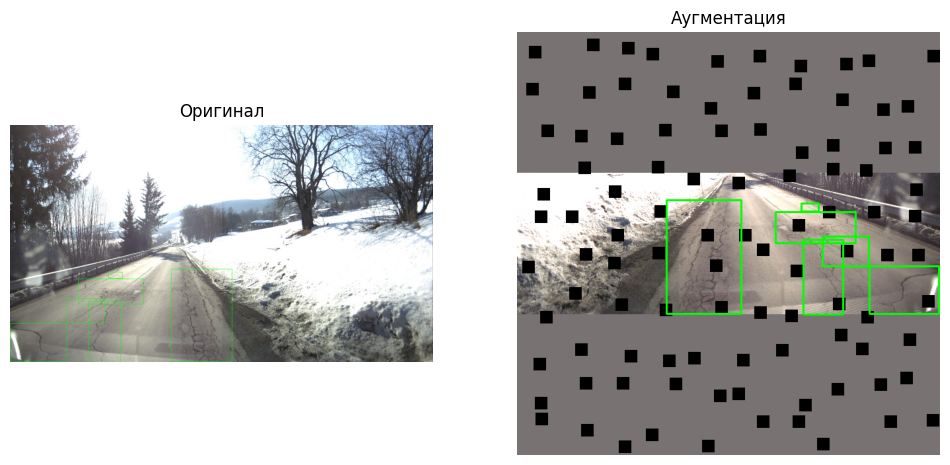

In [ ]:
show_aug_with_boxes("/content/data/RDD_SPLIT/val/images/Norway_000024.jpg", transform)

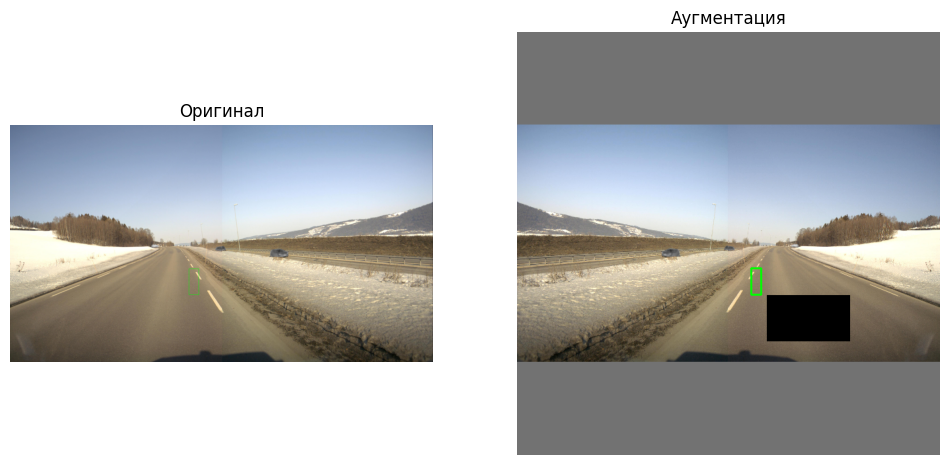

In [ ]:
show_aug_with_boxes("/content/data/RDD_SPLIT/val/images/Norway_000280.jpg", transform)

Все работает отлично, несколько аугментаций вместе появляются редко, а даже если появляются, то выглядят нормально.

### **Стадия 4**

Попробуем добавить интересные аугментации, такие как погодные условия.

При этом аугментация погодных условий вряд ли даст прирост по метрикам, но потенциально улучшит качество модели при выходе в прод.

*Важное замечание* --> по умолчанию YOLO создает мозайку в конце пайплайна трансформа, но реализовать ее с помощью Albumentations достаточно трудозатратная (и возможно лишняя) задача, поэтому в данной работе этот этап будет опущен.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        A.OneOf([
            A.ToGray(p=1.0),
            A.ChannelDropout(p=1.0)
        ], p=1.0),
        A.OneOf([
            A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=1.0),
            A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05, p=1.0),
            A.RandomGamma(gamma_limit=(85, 115), p=1.0),
            A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=10, p=1.0),
            A.PlanckianJitter(temperature_min=4000, temperature_max=9000, p=1.0),
        ], p=1.0)
    ], p=0.15),
    # ---
    A.OneOf([
        # солнечные блики
        A.RandomSunFlare(src_radius=200, num_flare_circles_lower=1, num_flare_circles_upper=3, p=1.0),
        # тень
        A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), num_shadows_lower=1, num_shadows_upper=2, p=1.0),
    ], p=0.2)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']), seed=MANUAL_SEED)

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

print("Аугментации, которые мы хотим применить:")
for aug in transform.transforms:
    print(f"   • {aug}")

model_stage_4 = YOLO('yolov8n.pt')
model_stage_4.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    batch=4,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='AugStage4',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms)
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/tmp/ipython-input-4029779218.py:30: UserWarning: Argument(s) 'temperature_min, temperature_max' are not valid for transform PlanckianJitter
  A.PlanckianJitter(temperature_min=4000, temperature_max=9000, p=1.0),
/tmp/ipython-input-4029779218.py:36: UserWarning: Argument(s) 'num_flare_circles_lower, num_flare_circles_upper' are not valid for transform RandomSunFlare
  A.RandomSunFlare(src_radius=200, num_flare_circles_lower=1, num_flare_circles_upper=3, p=1.0),
/tmp/ipython-input-4029779218.py:38: UserWarning: Argument(s) 'num_shadows_lower, num_shadows_upper' are not valid for transform RandomShadow
  A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), num_shadows_lower=1, num_shadows_upper=2, p=1.0),


Аугментации, которые мы хотим применить:
   • BBoxSafeRandomCrop(p=0.3, erosion_rate=0.0)
   • LongestMaxSize(p=1.0, area_for_downscale=None, interpolation=1, mask_interpolation=0, max_size=640, max_size_hw=None)
   • PadIfNeeded(p=1.0, border_mode=0, fill=(114.0, 114.0, 114.0), fill_mask=0.0, min_height=640, min_width=640, pad_height_divisor=None, pad_width_divisor=None, padding=0, position='center')
   • HorizontalFlip(p=0.5)
   • OneOf([
  CoarseDropout(p=1.0, fill=0.0, fill_mask=None, hole_height_range=(0.1, 0.2), hole_width_range=(0.1, 0.2), num_holes_range=(1, 2)),
  GridDropout(p=1.0, fill=0.0, fill_mask=None, holes_number_xy=None, random_offset=True, ratio=0.3, shift_xy=(0, 0), unit_size_range=None),
], p=0.2)
   • OneOf([
  OneOf([
    ToGray(p=1.0, method='weighted_average', num_output_channels=3),
    ChannelDropout(p=1.0, channel_drop_range=(1, 1), fill=0.0),
  ], p=1.0),
  OneOf([
    RandomBrightnessContrast(p=1.0, brightness_by_max=True, brightness_limit=(-0.15, 0.15), c

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x79f7734bb0b0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
src_dir = "/content/saves/AugStage4"
dst_zip = "/content/zip_saves/AugStage4"

shutil.make_archive(dst_zip, 'zip', src_dir)

'/content/zip_saves/AugStage4.zip'

In [ ]:
results_augstage4 = pd.read_csv("/content/saves/AugStage4/results.csv")
results_augstage4

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,196.534,2.07762,3.68721,1.90981,0.16553,0.09776,0.02624,0.01001,2.48260,5.45391,2.21166,0.000370,0.000370,0.000370
1,2,376.500,1.97468,3.09409,1.81671,0.12754,0.08688,0.04096,0.01528,2.44281,3.94673,2.16149,0.000635,0.000635,0.000635
2,3,551.499,1.90163,2.80891,1.76752,0.15358,0.10570,0.04257,0.01678,2.42897,5.28469,2.21816,0.000796,0.000796,0.000796
3,4,728.458,1.85391,2.62419,1.74668,0.18029,0.12687,0.06870,0.02749,2.35716,4.07539,2.10728,0.000640,0.000640,0.000640
4,5,903.293,1.76121,2.42022,1.67396,0.20212,0.14655,0.08345,0.03450,2.29953,4.03842,2.13075,0.000482,0.000482,0.000482
5,6,1078.560,1.69003,2.29366,1.61981,0.20381,0.15896,0.09593,0.04131,2.28779,3.84375,2.02537,0.000325,0.000325,0.000325
6,7,1249.600,1.61320,2.18832,1.56639,0.22439,0.15666,0.11244,0.04972,2.25281,4.31883,2.00746,0.000168,0.000168,0.000168


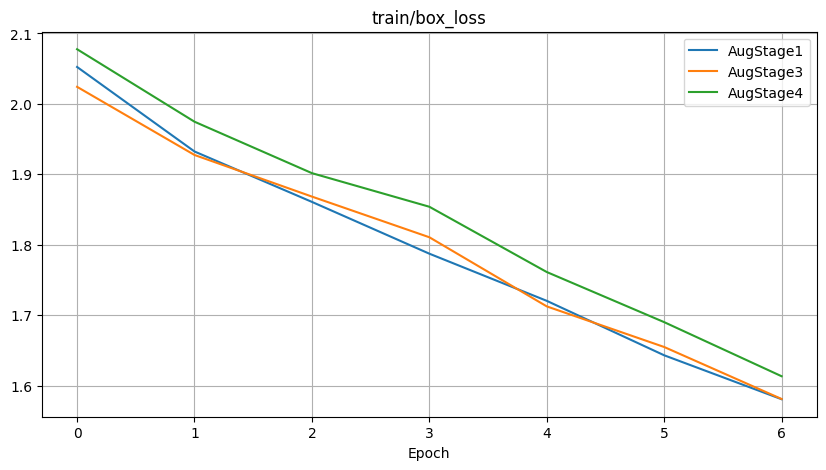

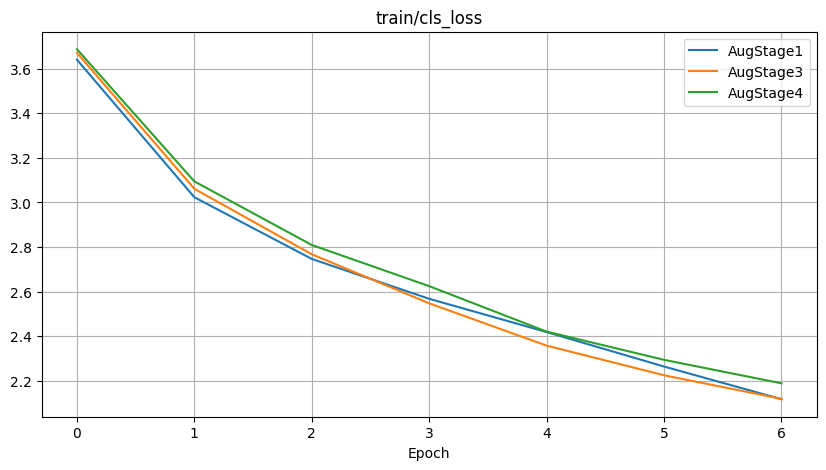

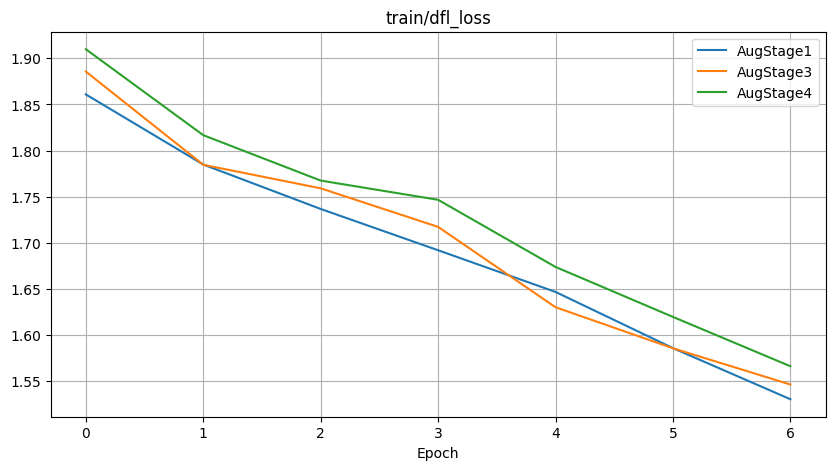

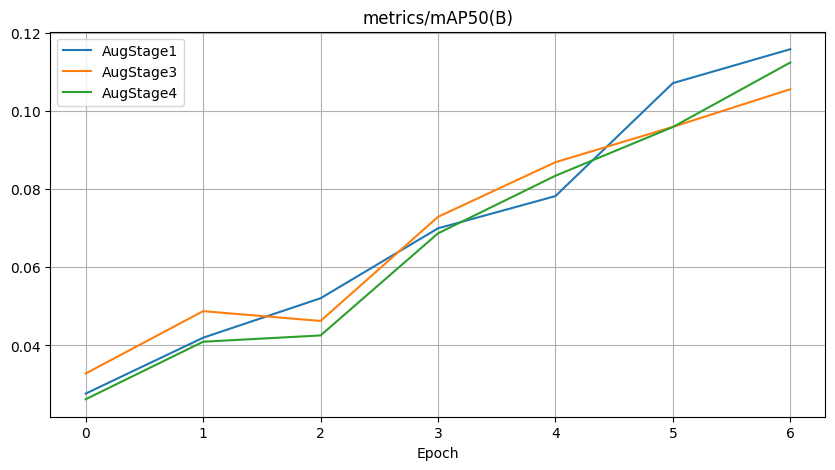

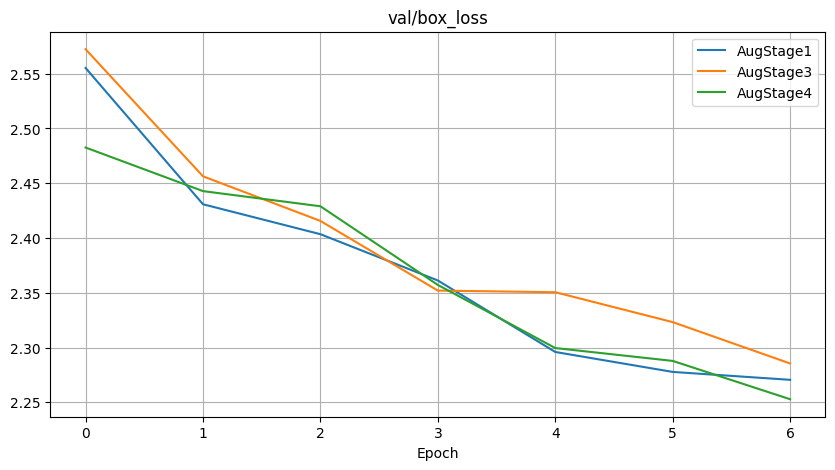

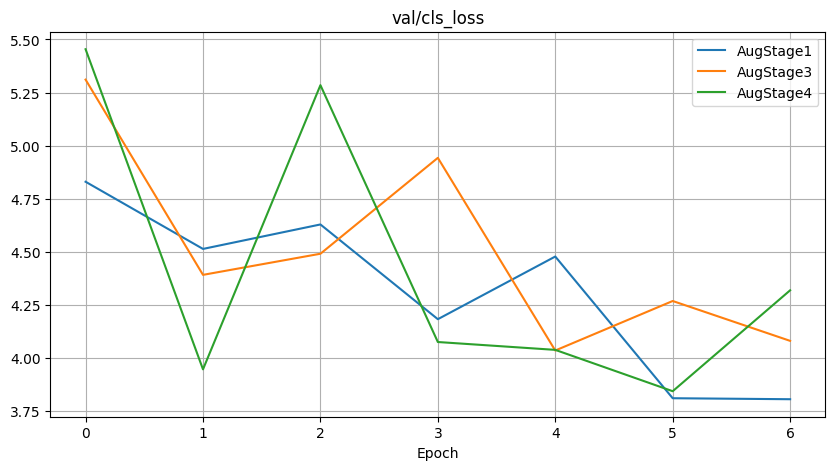

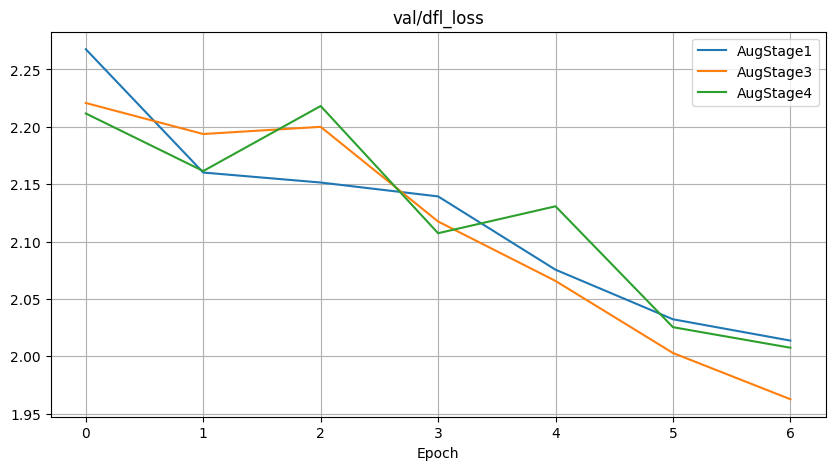

In [ ]:
results_augstage1 = pd.read_csv("/content/saves/AugStage1/AugStage1/results.csv")
results_augstage3 = pd.read_csv("/content/saves/AugStage3_Try3/results.csv")
plot_model_metrics([("AugStage1", results_augstage1),
                    ("AugStage3", results_augstage3),
                    ("AugStage4", results_augstage4)],
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

В целом очень неплохо: на трейне лосс выше, но при этом на валидации метрики совершенно не хуже. Можно попробовать еще одну настройку:

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        A.OneOf([
            A.ToGray(p=1.0),
            A.ChannelDropout(p=1.0)
        ], p=1.0),
        A.OneOf([
            A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=1.0),
            A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05, p=1.0),
            A.RandomGamma(gamma_limit=(85, 115), p=1.0),
            A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=10, p=1.0),
            A.PlanckianJitter(temperature_min=4000, temperature_max=9000, p=1.0),
        ], p=1.0)
    ], p=0.15),
    # ---
    A.OneOf([
        # солнечные блики
        A.RandomSunFlare(src_radius=200, num_flare_circles_lower=1, num_flare_circles_upper=4, p=1.0),
        # тень
        A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), num_shadows_lower=1, num_shadows_upper=2, p=1.0),
    ], p=0.25)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']), seed=MANUAL_SEED)

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

print("Аугментации, которые мы хотим применить:")
for aug in transform.transforms:
    print(f"   • {aug}")

model_stage_4_2 = YOLO('yolov8n.pt')
model_stage_4_2.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    batch=4,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='AugStage4_Try2',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms)
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/tmp/ipython-input-670077314.py:30: UserWarning: Argument(s) 'temperature_min, temperature_max' are not valid for transform PlanckianJitter
  A.PlanckianJitter(temperature_min=4000, temperature_max=9000, p=1.0),
/tmp/ipython-input-670077314.py:36: UserWarning: Argument(s) 'num_flare_circles_lower, num_flare_circles_upper' are not valid for transform RandomSunFlare
  A.RandomSunFlare(src_radius=200, num_flare_circles_lower=1, num_flare_circles_upper=4, p=1.0),
/tmp/ipython-input-670077314.py:38: UserWarning: Argument(s) 'num_shadows_lower, num_shadows_upper' are not valid for transform RandomShadow
  A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), num_shadows_lower=1, num_shadows_upper=2, p=1.0),


Аугментации, которые мы хотим применить:
   • BBoxSafeRandomCrop(p=0.3, erosion_rate=0.0)
   • LongestMaxSize(p=1.0, area_for_downscale=None, interpolation=1, mask_interpolation=0, max_size=640, max_size_hw=None)
   • PadIfNeeded(p=1.0, border_mode=0, fill=(114.0, 114.0, 114.0), fill_mask=0.0, min_height=640, min_width=640, pad_height_divisor=None, pad_width_divisor=None, padding=0, position='center')
   • HorizontalFlip(p=0.5)
   • OneOf([
  CoarseDropout(p=1.0, fill=0.0, fill_mask=None, hole_height_range=(0.1, 0.2), hole_width_range=(0.1, 0.2), num_holes_range=(1, 2)),
  GridDropout(p=1.0, fill=0.0, fill_mask=None, holes_number_xy=None, random_offset=True, ratio=0.3, shift_xy=(0, 0), unit_size_range=None),
], p=0.2)
   • OneOf([
  OneOf([
    ToGray(p=1.0, method='weighted_average', num_output_channels=3),
    ChannelDropout(p=1.0, channel_drop_range=(1, 1), fill=0.0),
  ], p=1.0),
  OneOf([
    RandomBrightnessContrast(p=1.0, brightness_by_max=True, brightness_limit=(-0.15, 0.15), c

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x79f770c796a0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
src_dir = "/content/saves/AugStage4_Try2"
dst_zip = "/content/zip_saves/AugStage4_Try2"

shutil.make_archive(dst_zip, 'zip', src_dir)

'/content/zip_saves/AugStage4_Try2.zip'

In [ ]:
results_augstage4_2 = pd.read_csv("/content/saves/AugStage4_Try2/results.csv")
results_augstage4_2

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,214.109,2.10670,3.69292,1.94405,0.11351,0.08909,0.03386,0.01260,2.41528,4.50590,2.17101,0.000370,0.000370,0.000370
1,2,401.524,1.97118,3.12365,1.80163,0.10367,0.09961,0.04010,0.01506,2.40432,5.08004,2.22133,0.000635,0.000635,0.000635
2,3,589.213,1.92312,2.85925,1.78688,0.33535,0.09517,0.05567,0.02063,2.43543,4.06346,2.20076,0.000796,0.000796,0.000796
3,4,775.775,1.85059,2.67504,1.74553,0.13083,0.12750,0.05916,0.02393,2.36807,4.42966,2.12149,0.000640,0.000640,0.000640
4,5,959.369,1.76528,2.53030,1.69139,0.19975,0.14692,0.09369,0.03928,2.34987,3.98442,2.07715,0.000482,0.000482,0.000482
5,6,1141.310,1.70070,2.39605,1.64240,0.24092,0.16060,0.10806,0.04682,2.31278,4.05244,2.08023,0.000325,0.000325,0.000325
6,7,1326.600,1.63621,2.25870,1.59640,0.28288,0.16220,0.12451,0.05508,2.28873,3.71614,2.04651,0.000168,0.000168,0.000168


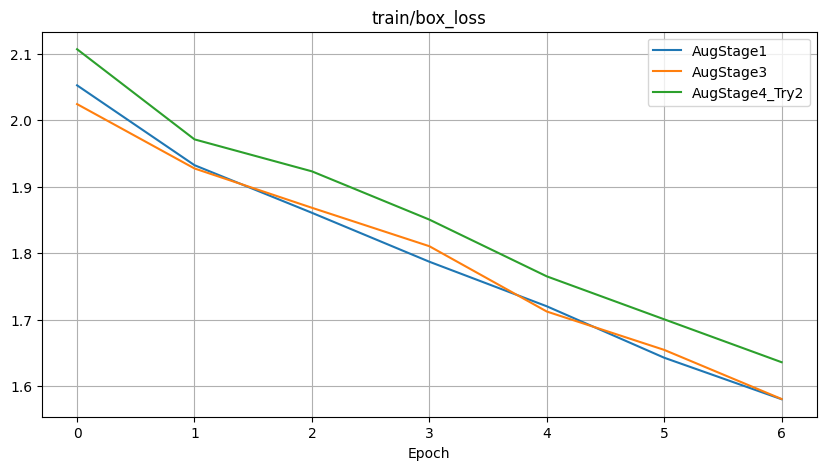

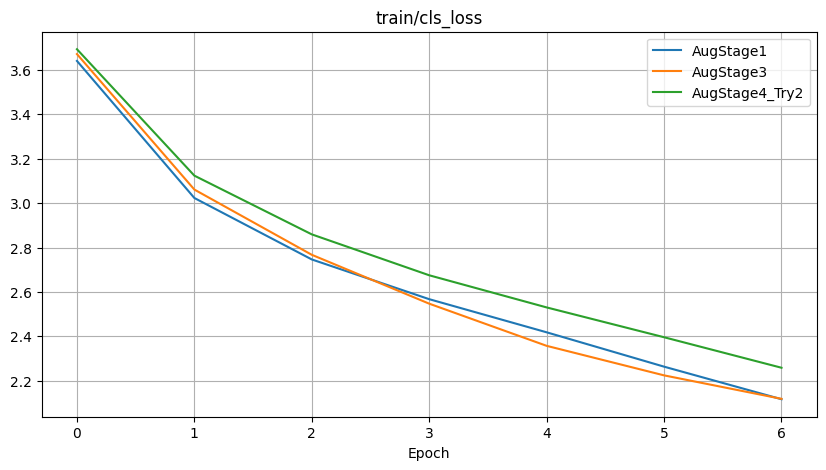

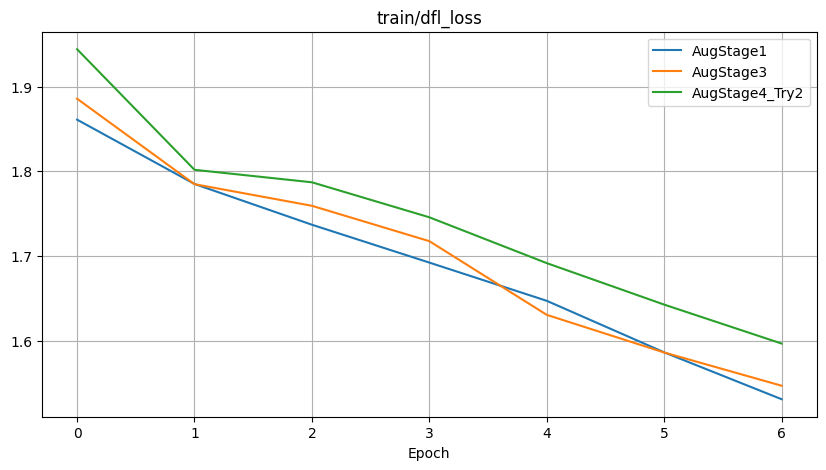

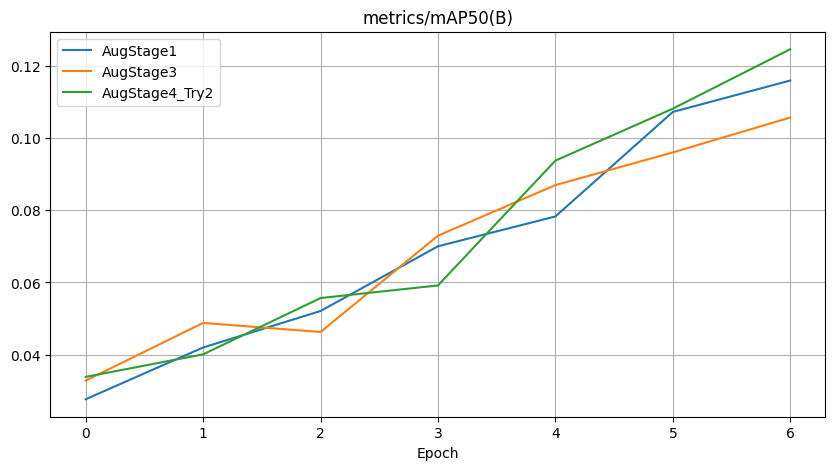

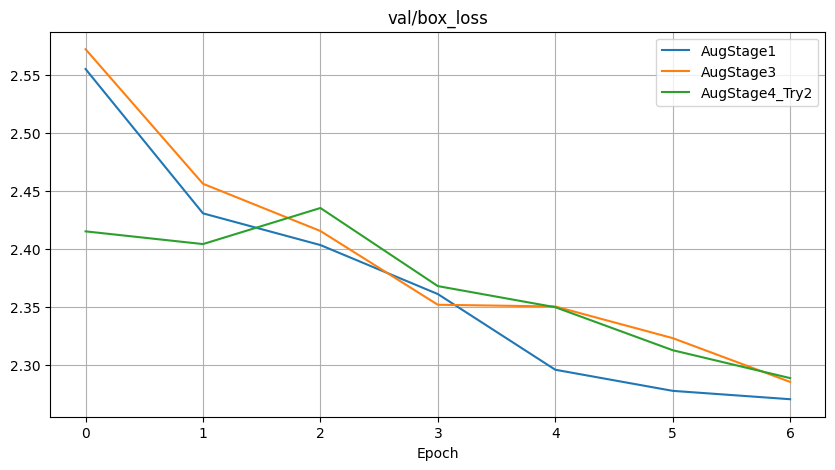

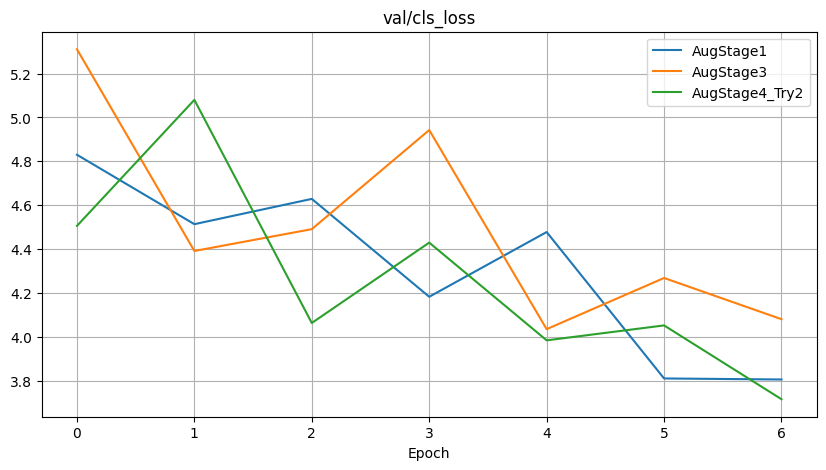

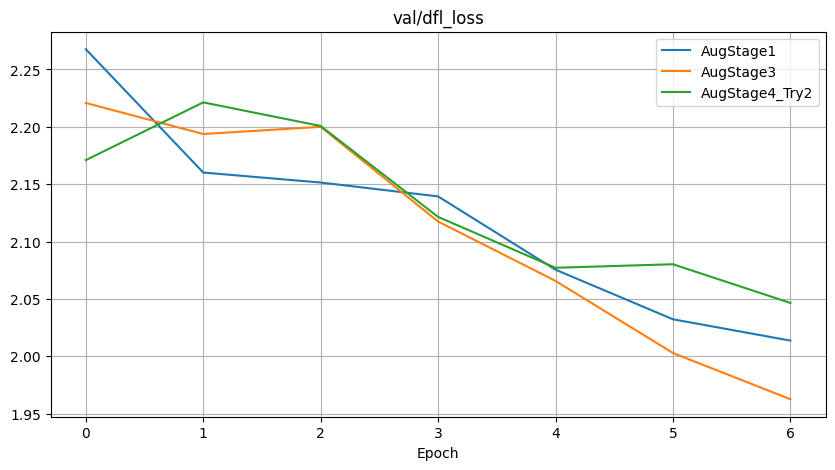

In [ ]:
results_augstage1 = pd.read_csv("/content/saves/AugStage1/AugStage1/results.csv")
results_augstage3 = pd.read_csv("/content/saves/AugStage3_Try3/results.csv")
results_augstage4 = pd.read_csv("/content/saves/AugStage4/results.csv")
plot_model_metrics([("AugStage1", results_augstage1),
                    ("AugStage3", results_augstage3),
                    # ("AugStage4", results_augstage4),
                    ("AugStage4_Try2", results_augstage4_2)],
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

Мы видим улучшение почти по всем пунктам на валидации. Это отличный результат.

Вот как это выглядит:

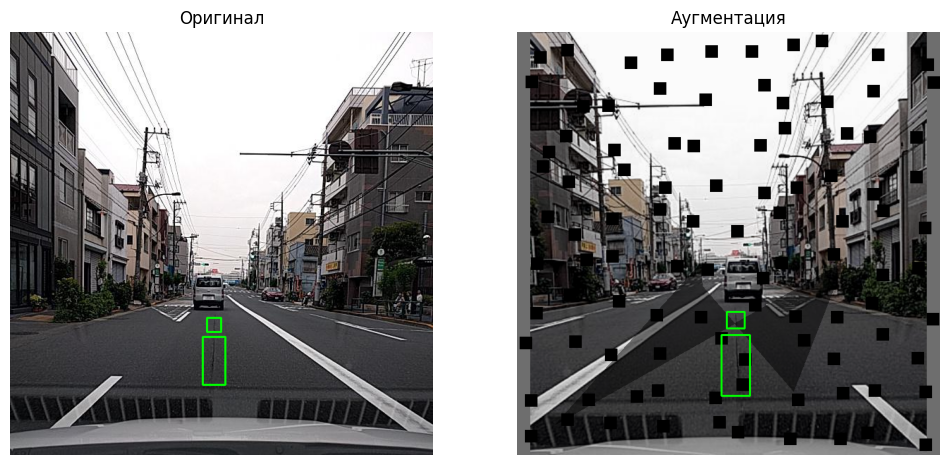

In [ ]:
show_aug_with_boxes("/content/data/RDD_SPLIT/val/images/Japan_008040.jpg", transform)

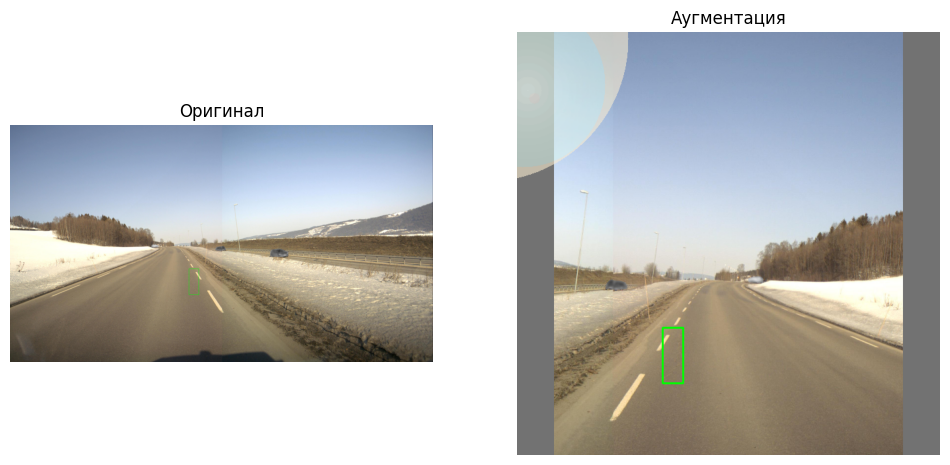

In [ ]:
show_aug_with_boxes("/content/data/RDD_SPLIT/val/images/Norway_000280.jpg", transform)

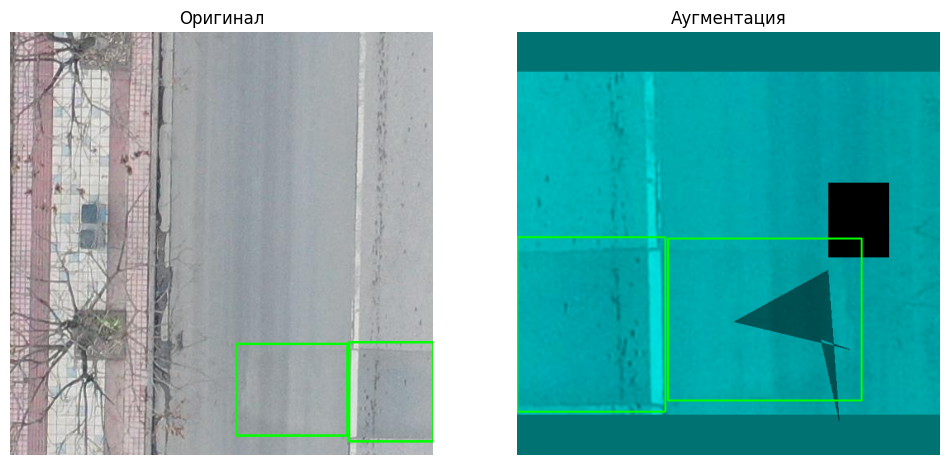

In [ ]:
# тут сразу 3 аугментации применилось)
show_aug_with_boxes("/content/data/RDD_SPLIT/val/images/China_Drone_000912.jpg", transform)

Посмотрим на итоговый результат применения аугментаций по сравнению с бейзлайном:

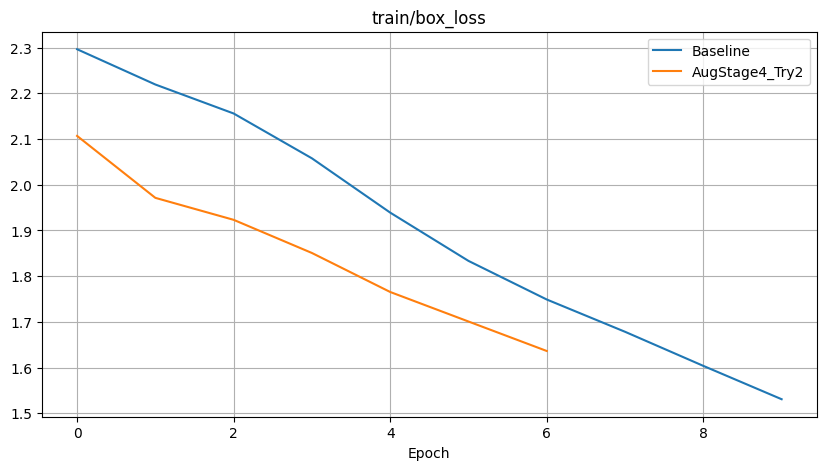

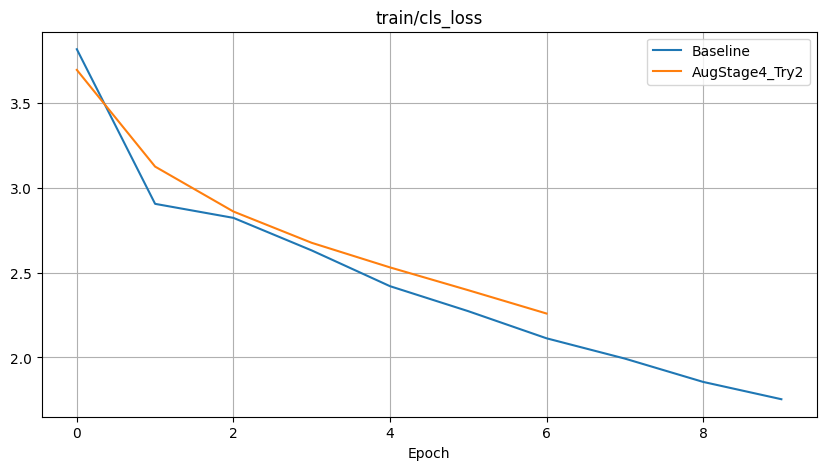

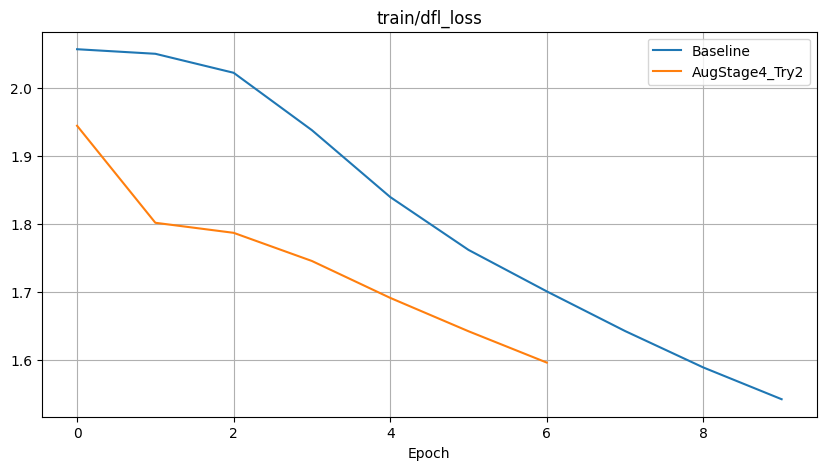

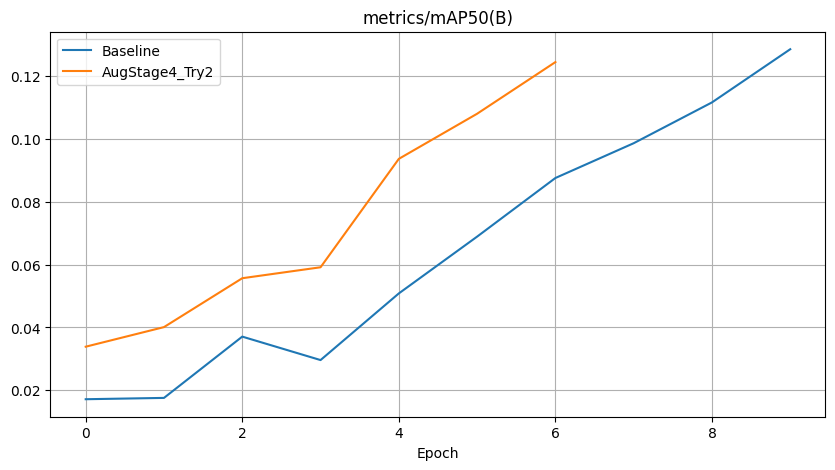

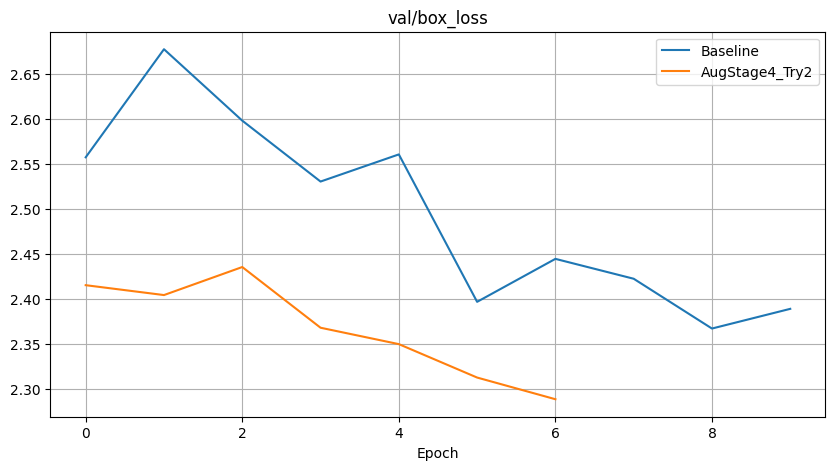

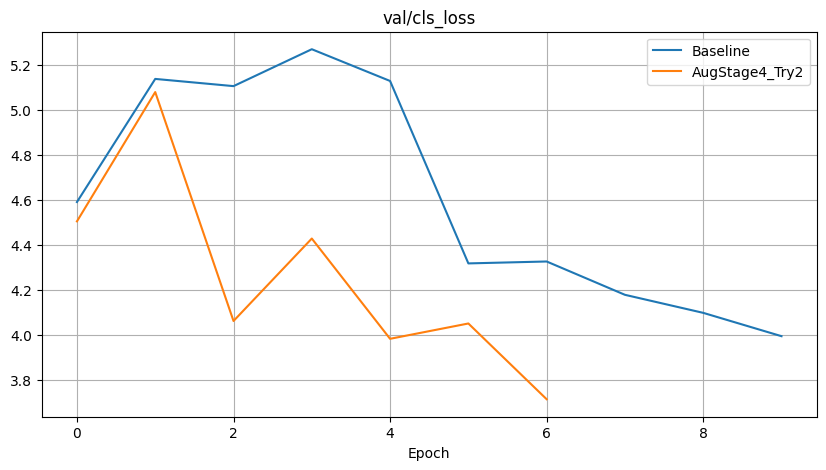

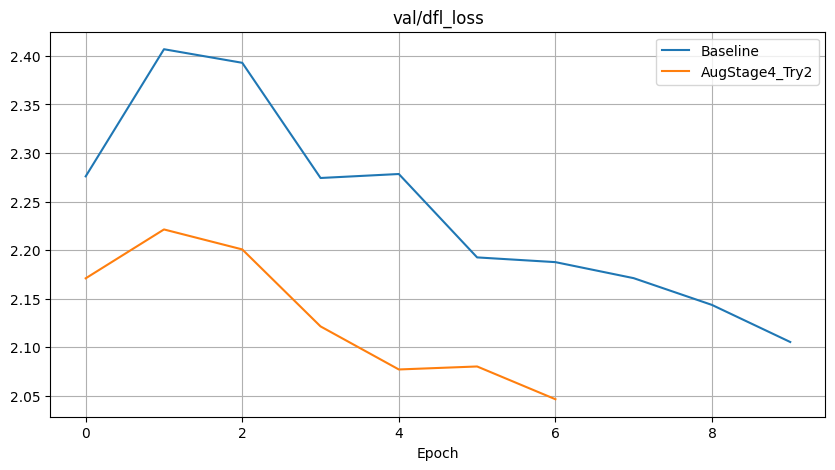

In [ ]:
results_baseline = pd.read_csv("/content/saves/Baseline/Baseline/results.csv")
plot_model_metrics([("Baseline", results_baseline),
                    ("AugStage4_Try2", results_augstage4_2)],
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

## Model customization

В этом разделе мы протестируем различные приемы, которые могут улучшить качество нашей модели, повысив метрику или оптимизировав ее.

Здесь мы будем уже обучаться на большем количестве батчей для лучшей репрезентативности.

### Optimizers

Рассмотрим, какой оптимизатор лучше всего сходится на наших данных. Такие параметры, как lr, weight_decay здесь не рассматриваем, т.к. они будут участвовать в дальнейшей настройке гиперпараметров.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        A.OneOf([
            A.ToGray(p=1.0),
            A.ChannelDropout(p=1.0)
        ], p=1.0),
        A.OneOf([
            A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=1.0),
            A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05, p=1.0),
            A.RandomGamma(gamma_limit=(85, 115), p=1.0),
            A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=10, p=1.0),
            A.PlanckianJitter(p=1.0),
        ], p=1.0)
    ], p=0.15),
    # ---
    A.OneOf([
        A.RandomSunFlare(src_radius=200, p=1.0),
        A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), p=1.0),
    ], p=0.25)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']), seed=MANUAL_SEED)

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


In [ ]:
model_adamw = YOLO('yolov8n.pt')
model_adamw.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    # увеличили размер батча
    batch=16,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='AdamW',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    # ---
    optimizer="AdamW"
)

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=7, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=AdamW, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x784fd8ee0b30>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
try:
    model_radam = YOLO('yolov8n.pt')
    model_radam.train(
        data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
        epochs=7,
        imgsz=TARGET_SIZE,
        # увеличили размер батча
        batch=16,
        device=0,
        save=True,
        cache=True,
        project='/content/saves',
        name='RAdam',
        exist_ok=True,
        pretrained=True,
        plots=True,
        fraction=0.1,
        trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
        half=True,
        # ---
        optimizer="RAdam"
    )
except: pass

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=7, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=RAdam, nbs=64, nms=False, opset=None, optimize=False, optimizer=RAdam, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose

In [ ]:
try:
    model_sgd = YOLO('yolov8n.pt')
    model_sgd.train(
        data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
        epochs=7,
        imgsz=TARGET_SIZE,
        # увеличили размер батча
        batch=16,
        device=0,
        save=True,
        cache=True,
        project='/content/saves',
        name='SGD',
        exist_ok=True,
        pretrained=True,
        plots=True,
        fraction=0.1,
        trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
        half=True,
        # ---
        optimizer="SGD", momentum=0.9
    )
except: pass

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=7, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.9, mosaic=1.0, multi_scale=False, name=SGD, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0,

In [ ]:
try:
    model_rmsprop = YOLO('yolov8n.pt')
    model_rmsprop.train(
        data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
        epochs=7,
        imgsz=TARGET_SIZE,
        # увеличили размер батча
        batch=16,
        device=0,
        save=True,
        cache=True,
        project='/content/saves',
        name='RMSProp',
        exist_ok=True,
        pretrained=True,
        plots=True,
        fraction=0.1,
        trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
        half=True,
        # ---
        optimizer="RMSProp"
    )
except: pass

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=7, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=RMSProp, nbs=64, nms=False, opset=None, optimize=False, optimizer=RMSProp, overlap_mask=True, patience=100, perspective=0.0, plots=True, 

In [ ]:
try:
    model_adam = YOLO('yolov8n.pt')
    model_adam.train(
        data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
        epochs=7,
        imgsz=TARGET_SIZE,
        # увеличили размер батча
        batch=16,
        device=0,
        save=True,
        cache=True,
        project='/content/saves',
        name='Adam',
        exist_ok=True,
        pretrained=True,
        plots=True,
        fraction=0.1,
        trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
        half=True,
        # ---
        optimizer="Adam"
    )
except: pass

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=7, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=Adam, nbs=64, nms=False, opset=None, optimize=False, optimizer=Adam, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=1

In [ ]:
try:
    model_nadam = YOLO('yolov8n.pt')
    model_nadam.train(
        data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
        epochs=7,
        imgsz=TARGET_SIZE,
        # увеличили размер батча
        batch=16,
        device=0,
        save=True,
        cache=True,
        project='/content/saves',
        name='NAdam',
        exist_ok=True,
        pretrained=True,
        plots=True,
        fraction=0.1,
        trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
        half=True,
        # ---
        optimizer="NAdam"
    )
except: pass

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=7, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=NAdam, nbs=64, nms=False, opset=None, optimize=False, optimizer=NAdam, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose

In [ ]:
try:
    model_adamax = YOLO('yolov8n.pt')
    model_adamax.train(
        data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
        epochs=7,
        imgsz=TARGET_SIZE,
        # увеличили размер батча
        batch=16,
        device=0,
        save=True,
        cache=True,
        project='/content/saves',
        name='AdaMax',
        exist_ok=True,
        pretrained=True,
        plots=True,
        fraction=0.1,
        trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
        half=True,
        # ---
        optimizer="AdaMax"
    )
except: pass

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=7, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=AdaMax, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdaMax, overlap_mask=True, patience=100, perspective=0.0, plots=True, po

In [ ]:
results = {}
for name in ["AdamW", "RAdam", "SGD", "RMSProp", "Adam", "NAdam", "AdaMax"]:
    try:
        zip_folder(name)
        results[name] = pd.read_csv(f"/content/saves/{name}/results.csv")
        print(name)
    except: pass

AdamW
RAdam
SGD
RMSProp
Adam
NAdam
AdaMax


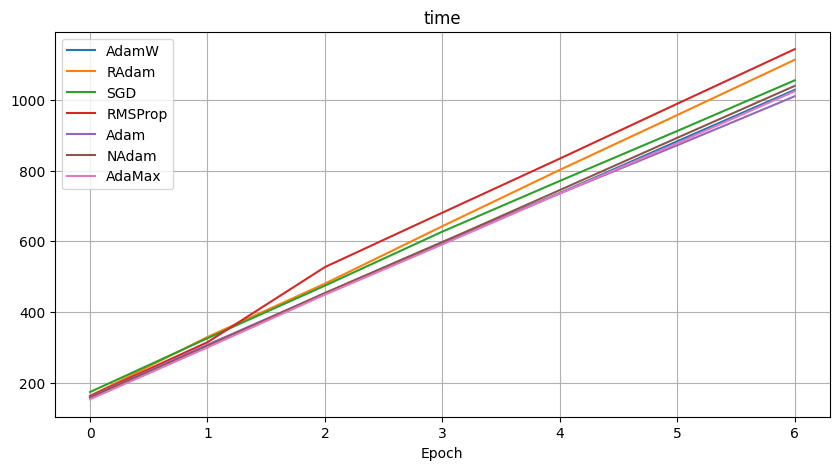

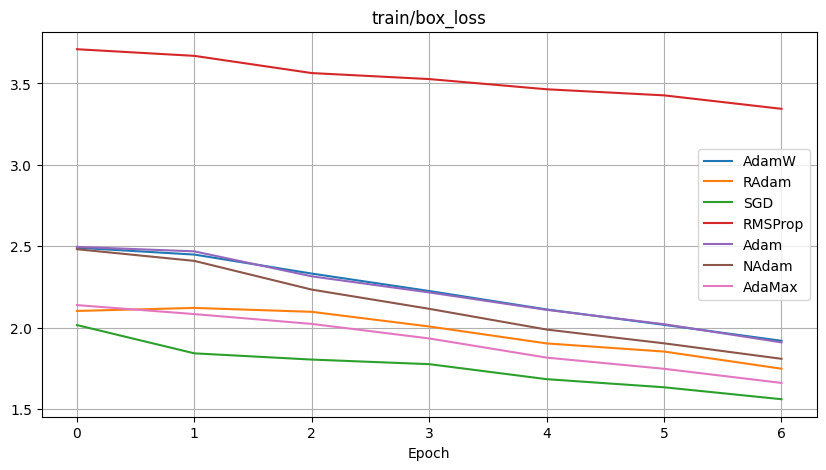

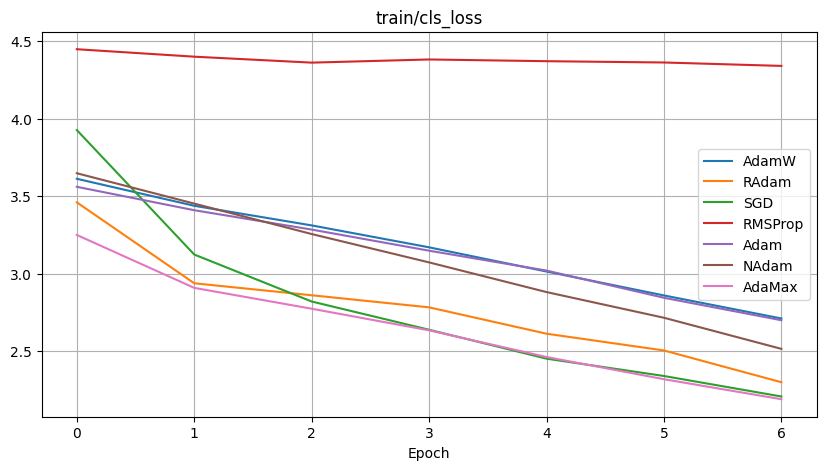

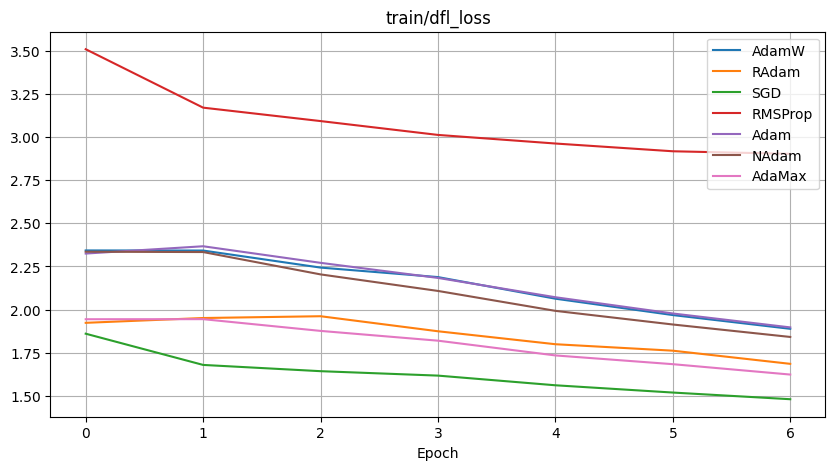

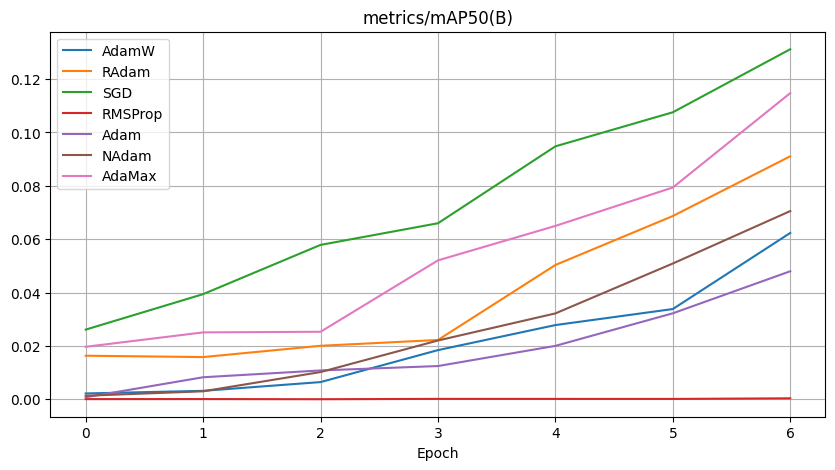

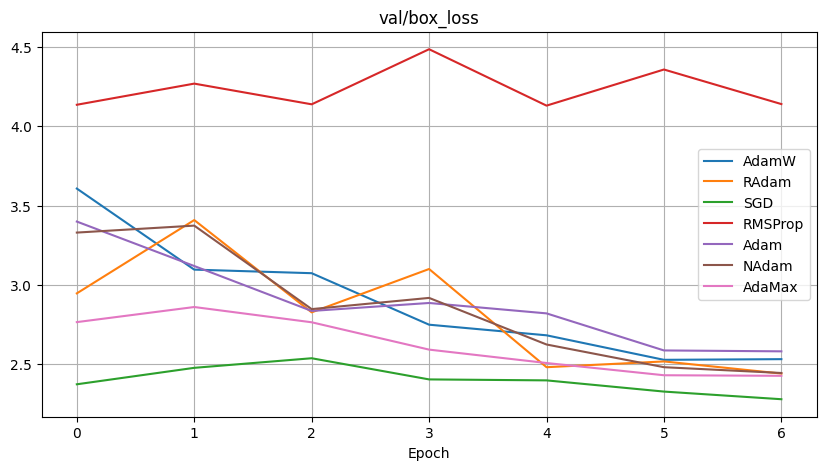

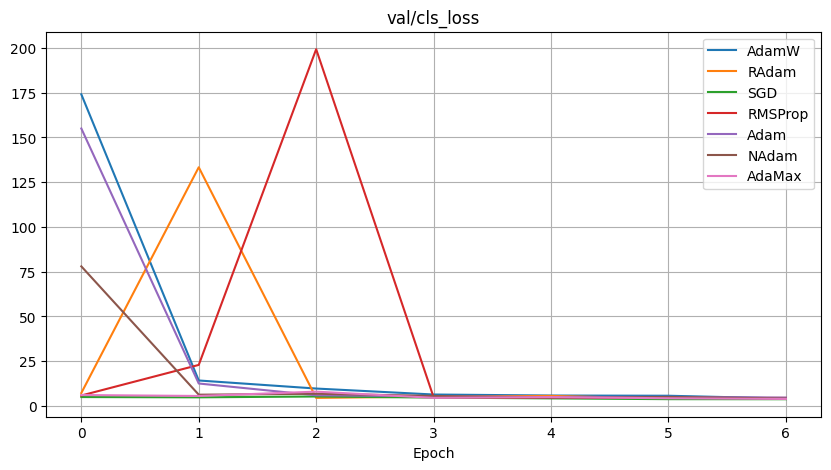

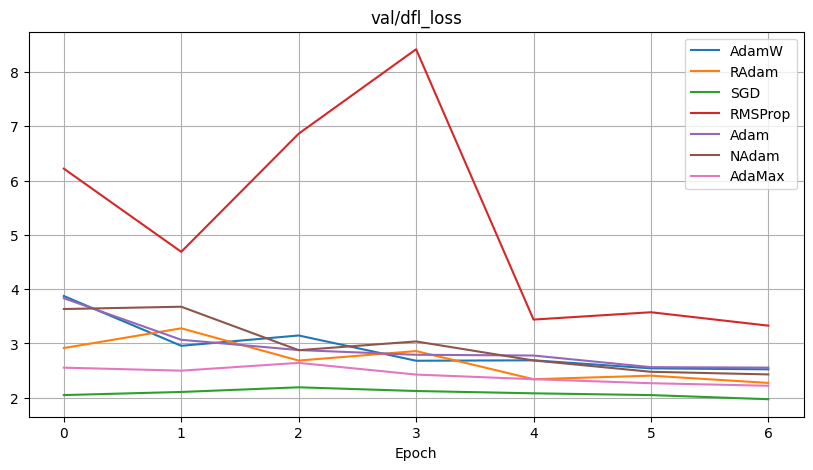

In [ ]:
plot_model_metrics(list(results.items()),
                   ['time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

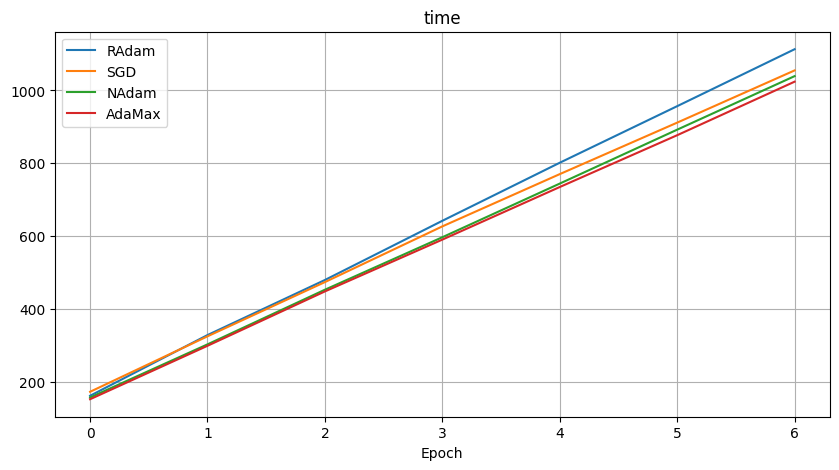

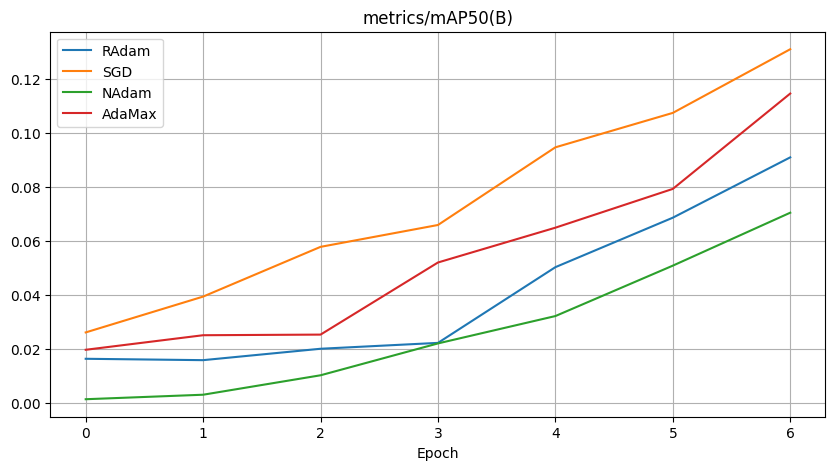

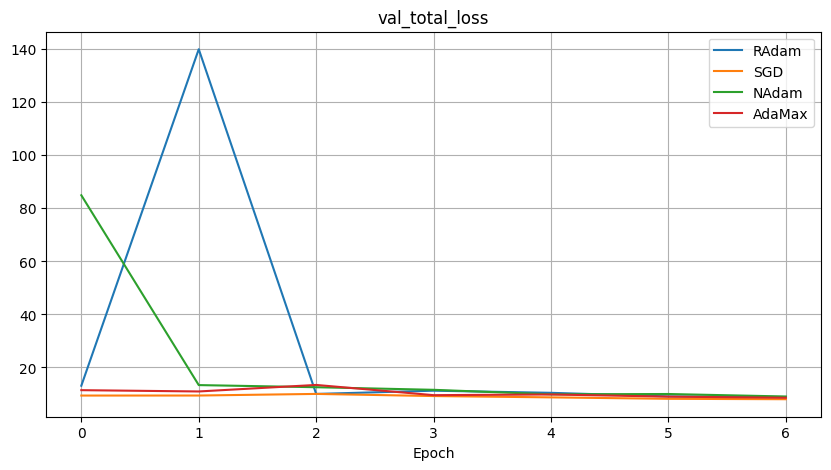

In [ ]:
results = {}
for name in ["RAdam", "SGD", "NAdam", "AdaMax"]:
    results[name] = pd.read_csv(f"/content/saves/{name}/results.csv")
    results[name]['val_total_loss'] = results[name]['val/box_loss'] + \
                                      results[name]['val/cls_loss'] + \
                                      results[name]['val/dfl_loss']
plot_model_metrics(list(results.items()),
                   ['time', 'metrics/mAP50(B)', 'val_total_loss'], figsize=(10,5))

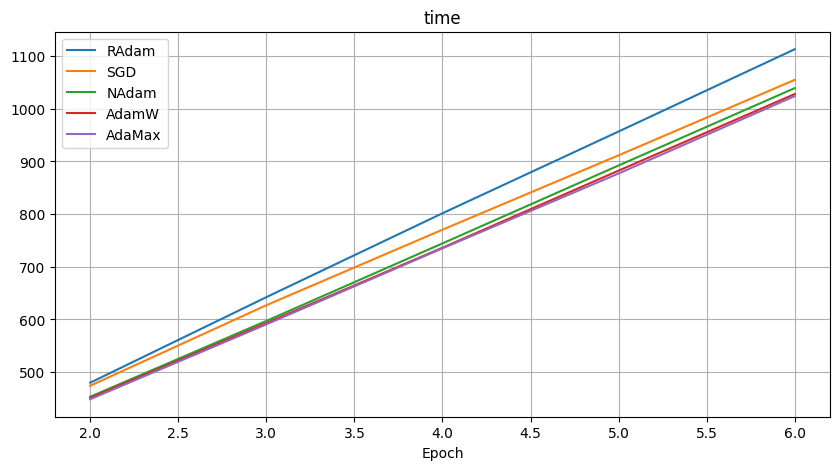

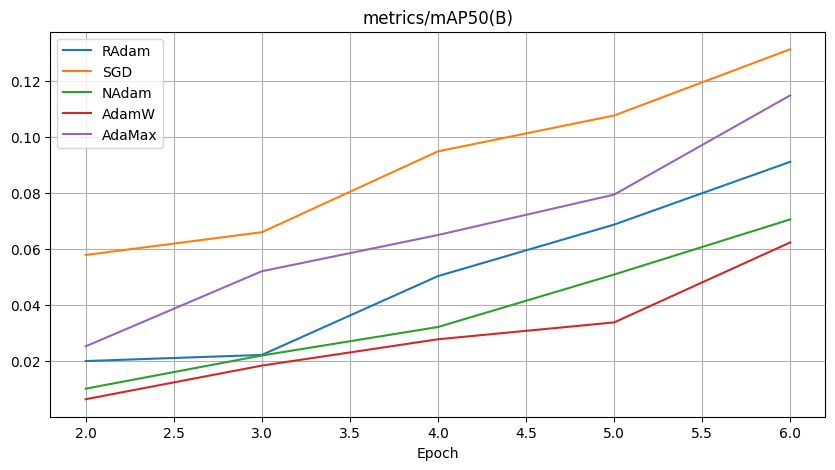

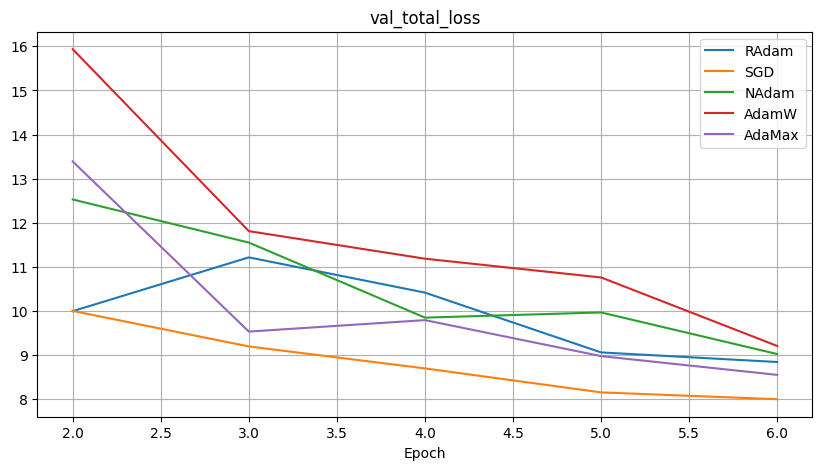

In [ ]:
results = {}
for name in ["RAdam", "SGD", "NAdam", "AdamW", "AdaMax"]:
    results[name] = pd.read_csv(f"/content/saves/{name}/results.csv")
    results[name]['val_total_loss'] = results[name]['val/box_loss'] + \
                                      results[name]['val/cls_loss'] + \
                                      results[name]['val/dfl_loss']
    results[name] = results[name].iloc[2:, :]
plot_model_metrics(list(results.items()),
                   ['time', 'metrics/mAP50(B)', 'val_total_loss'], figsize=(10,5))

In [ ]:
res = pd.concat((results['AdaMax']['metrics/mAP50(B)'] * 100, results['SGD']['metrics/mAP50(B)'] * 100, \
                (results['SGD']['metrics/mAP50(B)'] - results['AdaMax']['metrics/mAP50(B)']) * 100), axis=1)
res.columns = ['AdaMax (mAP@50)', 'SGD (mAP@50)', 'diff']
res

,AdaMax (mAP@50),SGD (mAP@50),diff
2,2.530,5.785,3.255
3,5.205,6.596,1.391
4,6.496,9.477,2.981
5,7.935,10.754,2.819
6,11.472,13.116,1.644


In [ ]:
res = pd.concat((results['AdamW']['metrics/mAP50(B)'] * 100, results['SGD']['metrics/mAP50(B)'] * 100, \
                (results['SGD']['metrics/mAP50(B)'] - results['AdamW']['metrics/mAP50(B)']) * 100), axis=1)
res.columns = ['AdamW (mAP@50)', 'SGD (mAP@50)', 'diff']
res

,AdamW (mAP@50),SGD (mAP@50),diff
2,0.645,5.785,5.140
3,1.843,6.596,4.753
4,2.781,9.477,6.696
5,3.382,10.754,7.372
6,6.233,13.116,6.883


SGD оказался, как ни странно, наиболее подходящим оптимизатором для YOLO на датасете RDD2022 (в условиях короткого обучения и остальных параметров конфигурации). Он стабильно превосходит AdamW и AdaMax на всех эпохах с разрывом 4–7 процентных пунктов в mAP@50. Адаптивные оптимизаторы демонстрируют более медленную сходимость и низкое качество.

При этом, результаты нельзя объяснить только параметрами конфигурации (например, маленькое количество эпох или подвыборка), а также плохим сидом --> можно наблюдать, что SGD системно превосходит по всем параметрам (кроме времени, но это более второстепенно).

Это можно объяснить следующими факторами:

- датасет чистый и структурированный
- классов не очень много
- сигнал в loss достаточно сильный
- адаптивные методы переобучаются и менее стабильны

### Learning Rate Scheduler
К сожалению, yolo официально поддерживает только 1 альтернативный scheduler (по умолчанию уже применяется linear) -> cosine schedule. Посмотрим, даст ли он нам прирост.

In [ ]:
model_cosine = YOLO('yolov8n.pt')
model_cosine.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=7,
    imgsz=TARGET_SIZE,
    batch=16,
    device=0,
    save=True,
    cache=True,
    project='/content/saves',
    name='CosineScheduler',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    momentum=0.9,
    # ---
    cos_lr=True
)

In [ ]:
results = {}

zip_folder('CosineScheduler')
results['CosineScheduler'] = pd.read_csv("/content/saves/CosineScheduler/results.csv")
results['LinearScheduler'] = pd.read_csv("/content/saves/SGD/results.csv")

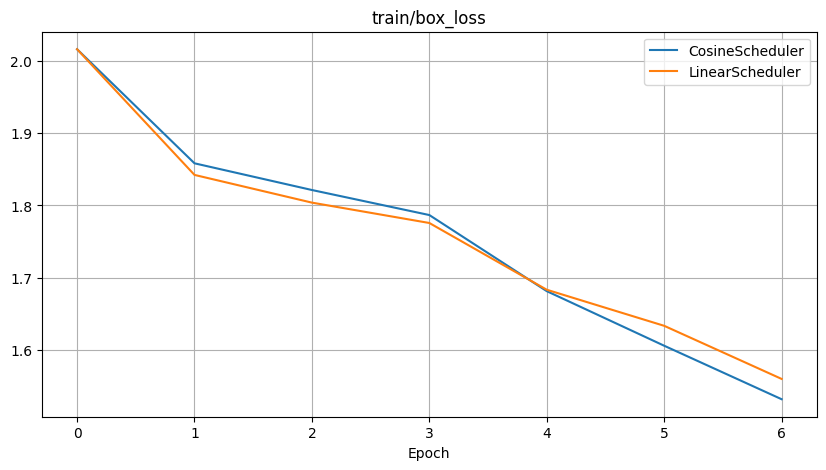

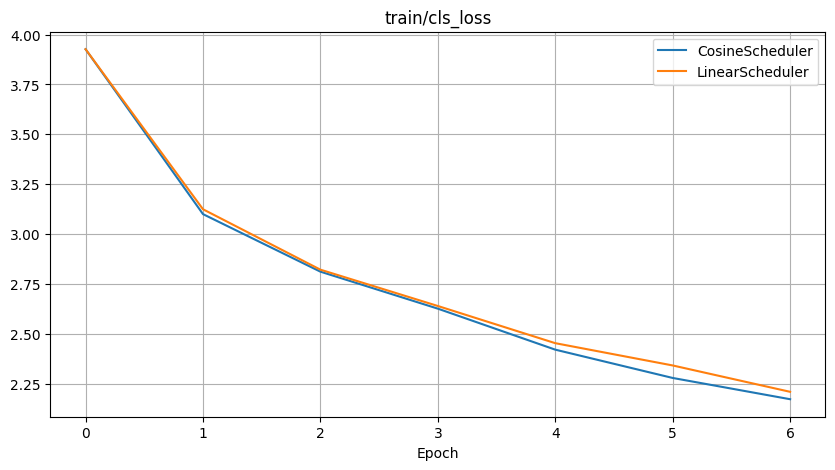

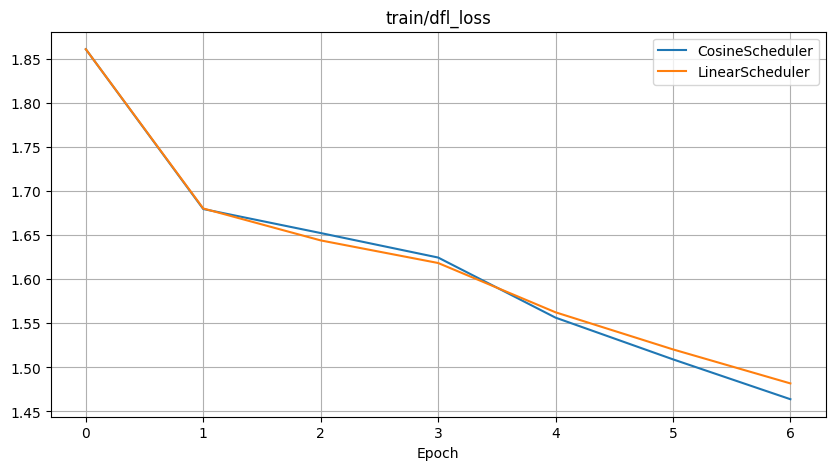

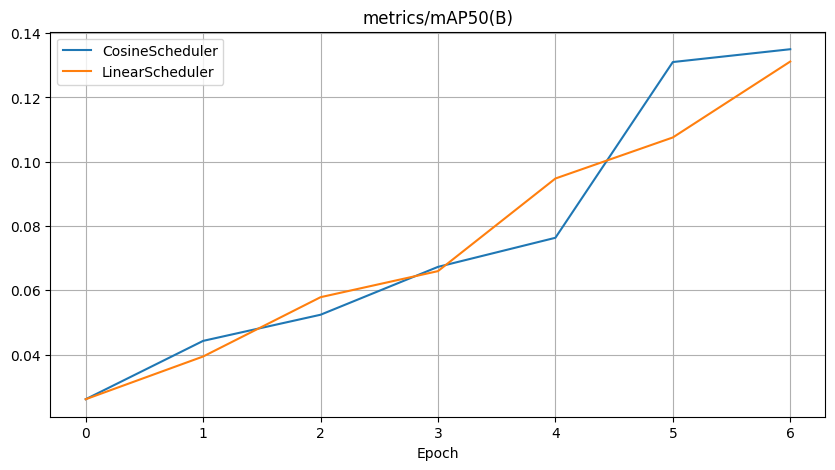

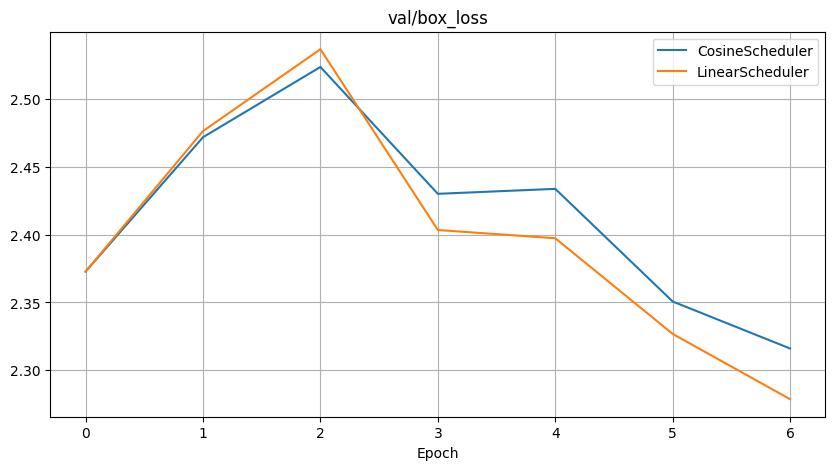

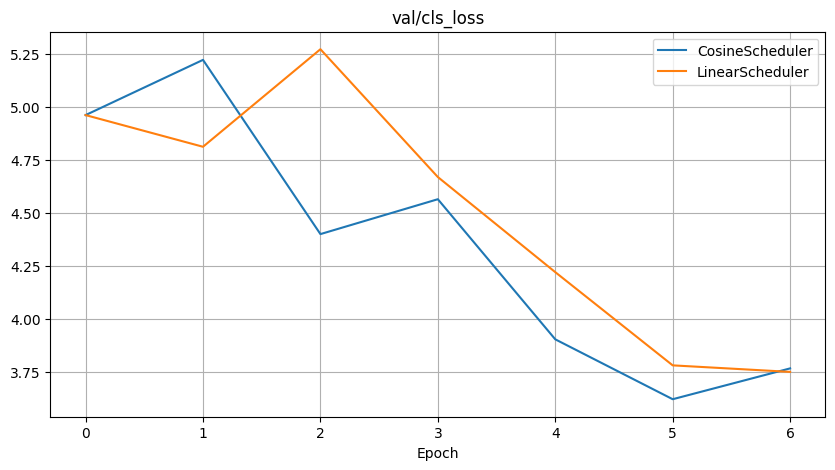

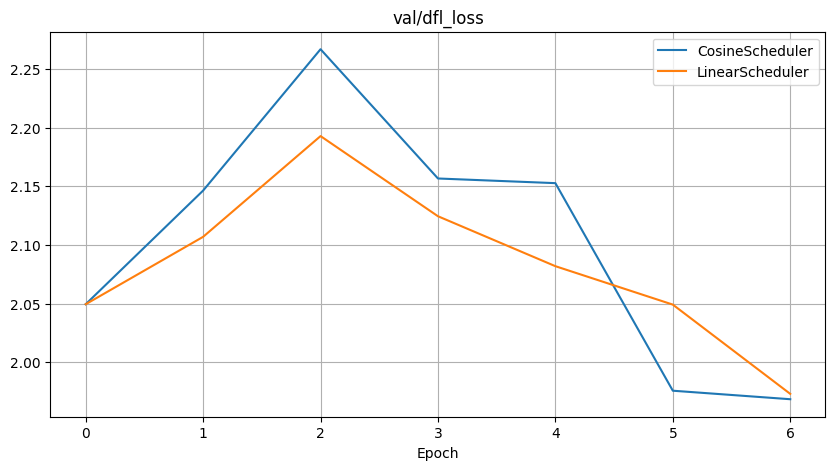

In [ ]:
plot_model_metrics(list(results.items()),
                   ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

Cosine Scheduler показывает чуть более плавное обучение на трейне и слегка лучше по метрике, поэтому оставим его.

### Batch size

Посмотрим как влияет batch size на итоговую метрику.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        A.OneOf([
            A.ToGray(p=1.0),
            A.ChannelDropout(p=1.0)
        ], p=1.0),
        A.OneOf([
            A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=1.0),
            A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05, p=1.0),
            A.RandomGamma(gamma_limit=(85, 115), p=1.0),
            A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=10, p=1.0),
            A.PlanckianJitter(p=1.0),
        ], p=1.0)
    ], p=0.15),
    # ---
    A.OneOf([
        A.RandomSunFlare(src_radius=200, p=1.0),
        A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), p=1.0),
    ], p=0.25)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']), seed=MANUAL_SEED)

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


In [ ]:
model_bs32 = YOLO('yolov8n.pt')
model_bs32.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=10,
    imgsz=TARGET_SIZE,
    batch=32,
    device=0,
    save=True,
    # отключаем кэш, чтобы не тратить RAM
    cache=False,
    project='/content/saves',
    name='BS32',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    momentum=0.9,
    cos_lr=True
)

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.9, mosaic=1.0, multi_scale=False, name=BS32, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ec824fac8c0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
model_bs64 = YOLO('yolov8n.pt')
model_bs64.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=10,
    imgsz=TARGET_SIZE,
    batch=64,
    device=0,
    save=True,
    # отключаем кэш, чтобы не тратить RAM
    cache=False,
    project='/content/saves',
    name='BS64',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    momentum=0.9,
    cos_lr=True
)

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=64, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.9, mosaic=1.0, multi_scale=False, name=BS64, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ec8257c9580>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
results = {}

zip_folder('BS32')
zip_folder('BS64')
results['BS32'] = pd.read_csv("/content/saves/BS32/results.csv")
results['BS64'] = pd.read_csv("/content/saves/BS64/results.csv")

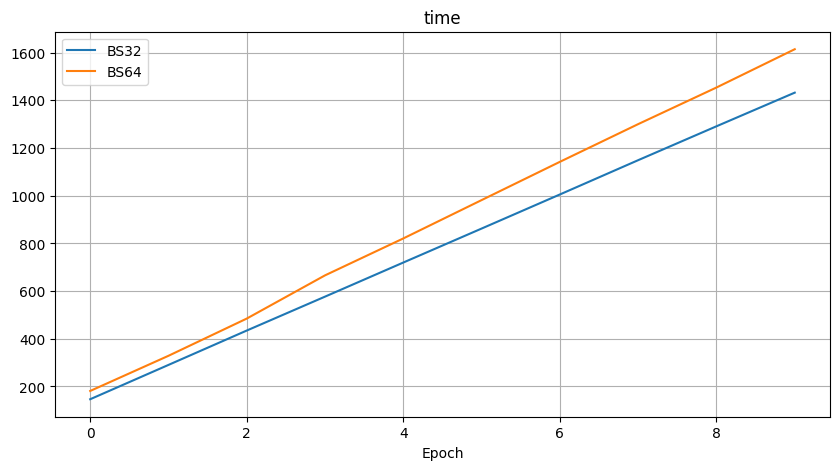

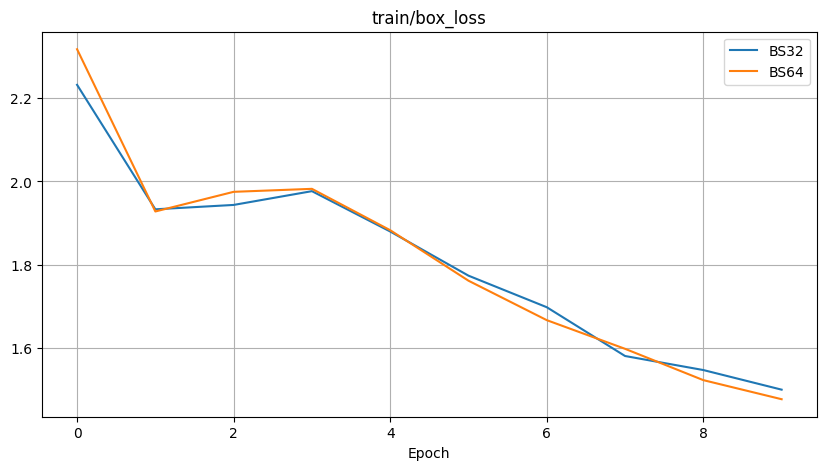

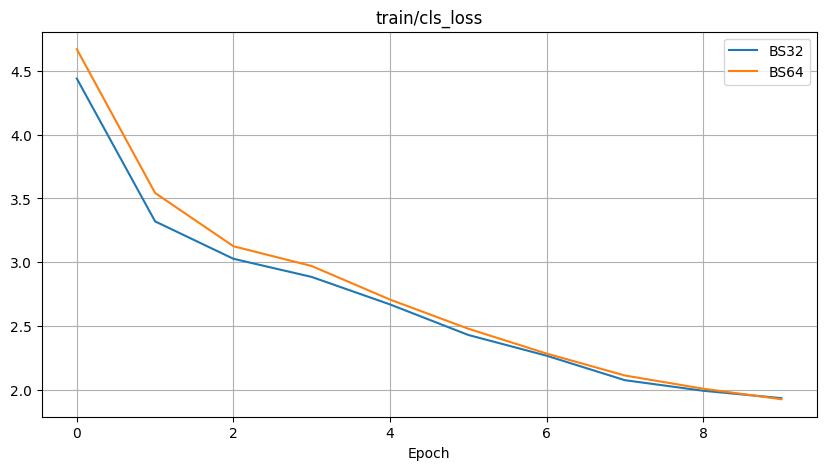

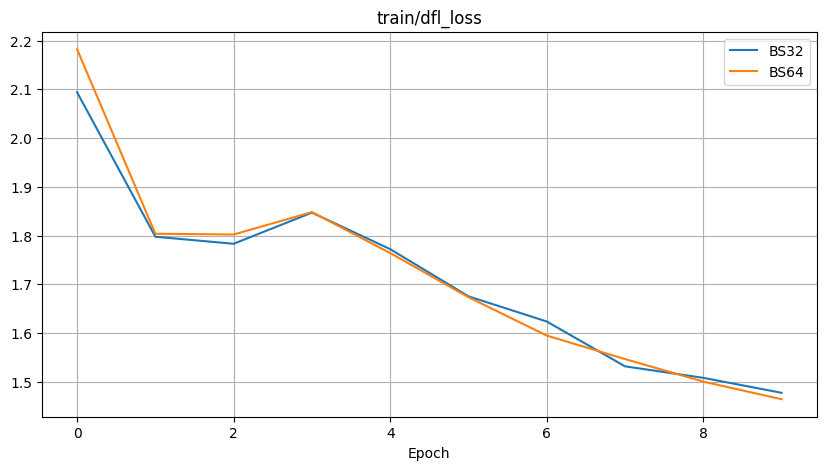

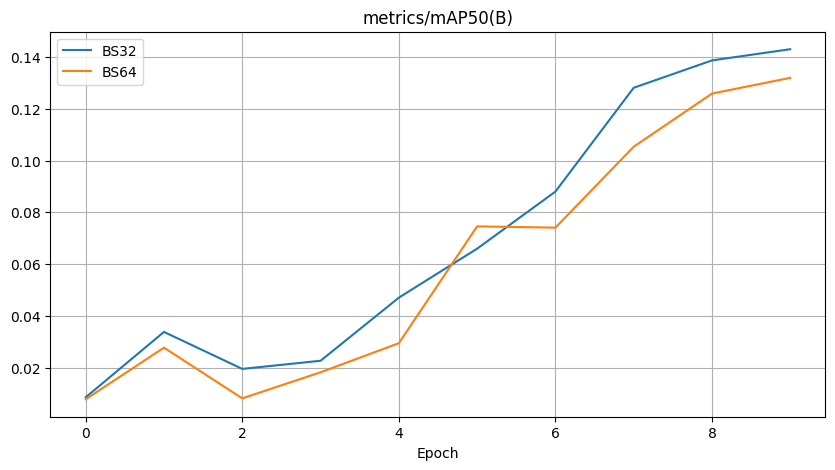

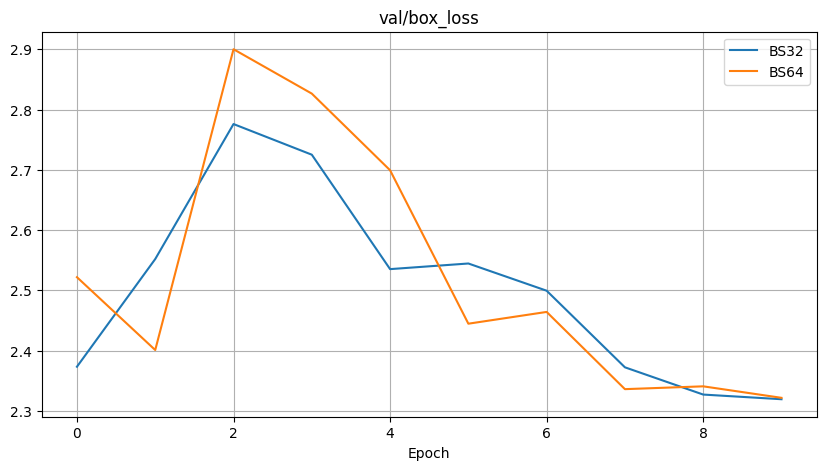

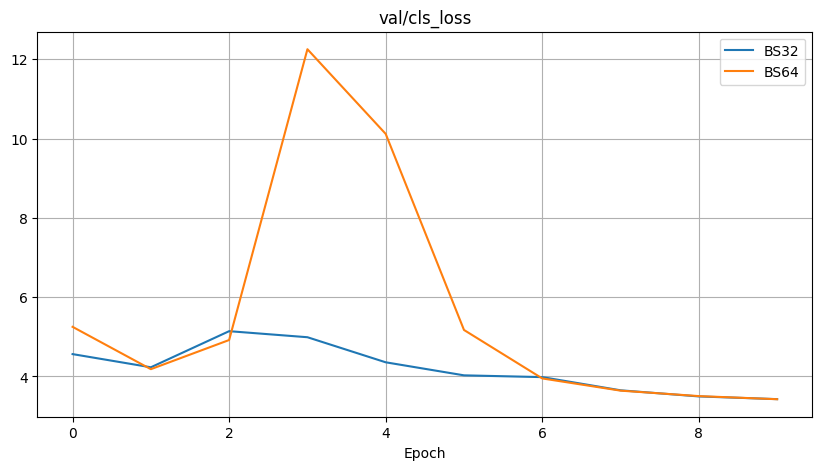

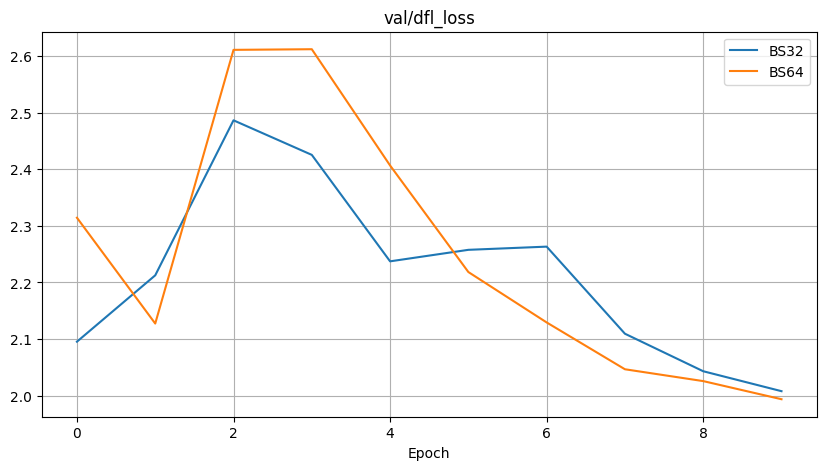

In [ ]:
plot_model_metrics(list(results.items()),
                   ['time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

В целом, разница между лоссами для batch sizes 64 и 32 не большая, а вот метрика даже хуже (нужен тюнинг гиперпараметров под больший батч). Но так как больший batch size увеличивает время обучения, и в целом учитывая все факторы комплексно, batch size = 32 нас устраивает.

### Multi-scale Training

Настройка этого параметра позволяет модели работать с изображениями различных масштабов и улучшать свои возможности обнаружения объектов разных размеров и в разных сценариях.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        A.OneOf([
            A.ToGray(p=1.0),
            A.ChannelDropout(p=1.0)
        ], p=1.0),
        A.OneOf([
            A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=1.0),
            A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05, p=1.0),
            A.RandomGamma(gamma_limit=(85, 115), p=1.0),
            A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=10, p=1.0),
            A.PlanckianJitter(p=1.0),
        ], p=1.0)
    ], p=0.15),
    # ---
    A.OneOf([
        A.RandomSunFlare(src_radius=200, p=1.0),
        A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), p=1.0),
    ], p=0.25)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']), seed=MANUAL_SEED)

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


In [ ]:
model_ms25 = YOLO('yolov8n.pt')
model_ms25.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=10,
    imgsz=TARGET_SIZE,
    batch=32,
    device=0,
    save=True,
    cache=False,
    project='/content/saves',
    name='MS25',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    momentum=0.9,
    cos_lr=True,
    # ---
    scale=0.25
)

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.9, mosaic=1.0, multi_scale=False, name=MS25, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x788d0cc04c50>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
model_ms50 = YOLO('yolov8n.pt')
model_ms50.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=10,
    imgsz=TARGET_SIZE,
    batch=32,
    device=0,
    save=True,
    cache=False,
    project='/content/saves',
    name='MS50',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    momentum=0.9,
    cos_lr=True,
    # ---
    scale=0.50
)

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.9, mosaic=1.0, multi_scale=False, name=MS50, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x788d0ef8fda0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
model_ms75 = YOLO('yolov8n.pt')
model_ms75.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=10,
    imgsz=TARGET_SIZE,
    batch=32,
    device=0,
    save=True,
    cache=False,
    project='/content/saves',
    name='MS75',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    momentum=0.9,
    cos_lr=True,
    # ---
    scale=0.75
)

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.9, mosaic=1.0, multi_scale=False, name=MS75, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78e47c34a390>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
results = {}

# zip_folder('MS25')
# zip_folder('MS50')
zip_folder('MS75')
results['MS25'] = pd.read_csv("/content/saves/MS25/results.csv")
results['MS50'] = pd.read_csv("/content/saves/MS50/results.csv")
results['MS75'] = pd.read_csv("/content/saves/MS75/results.csv")

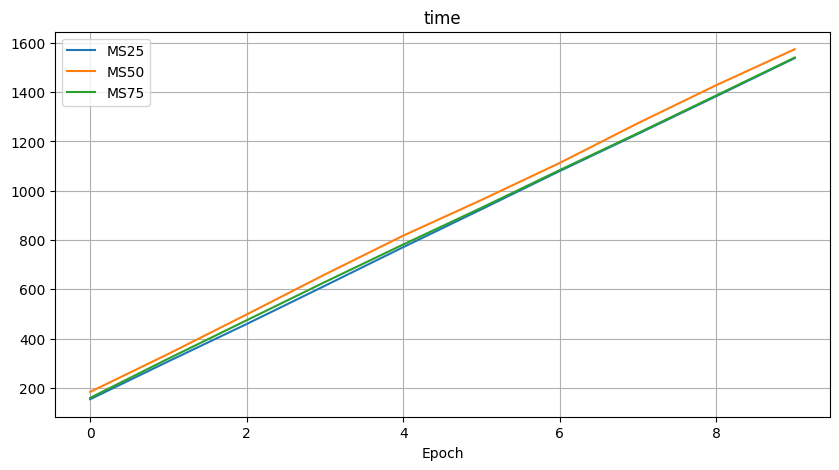

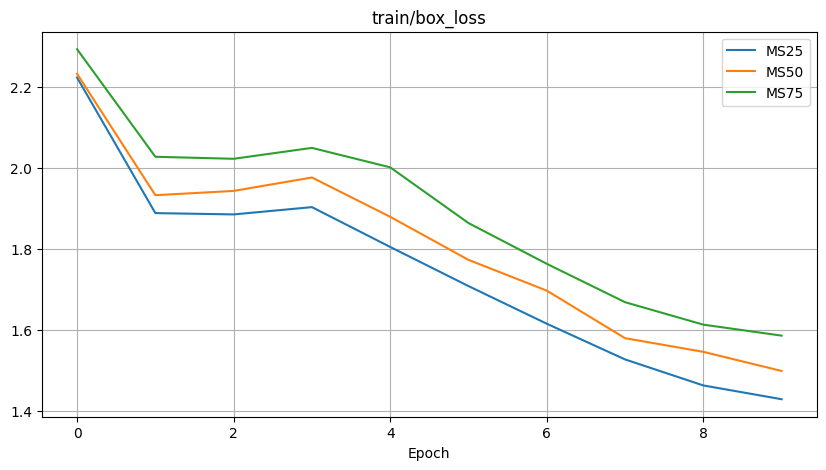

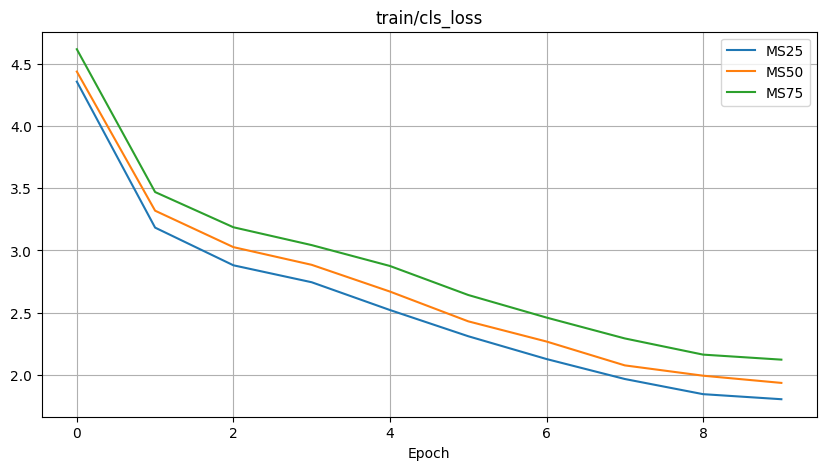

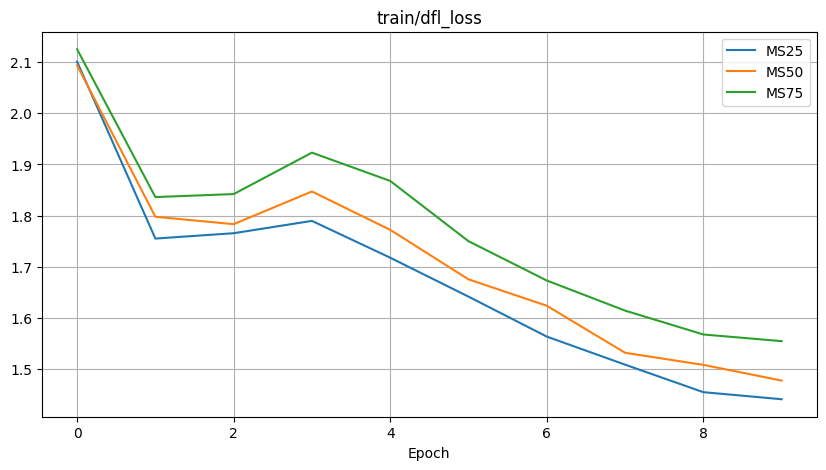

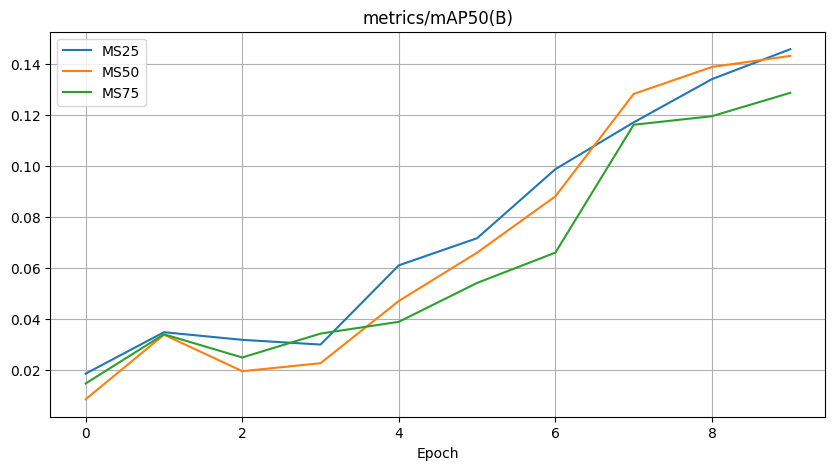

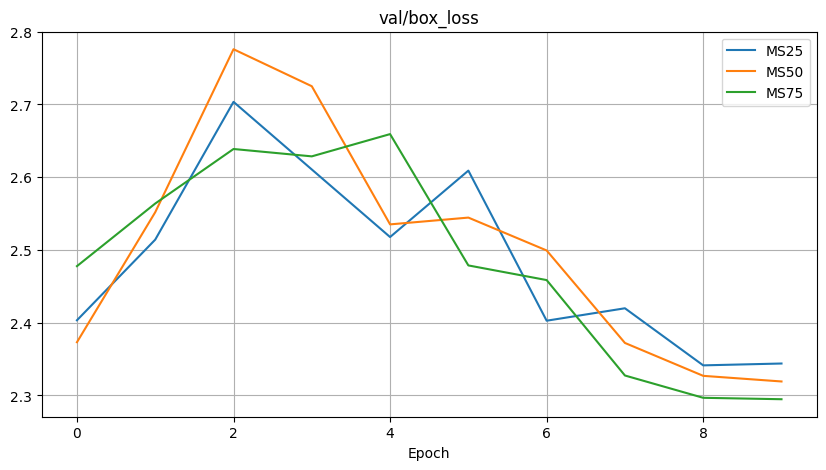

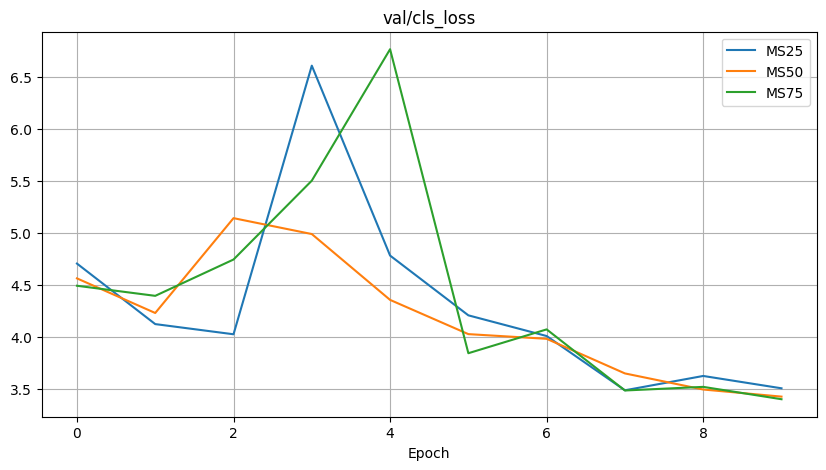

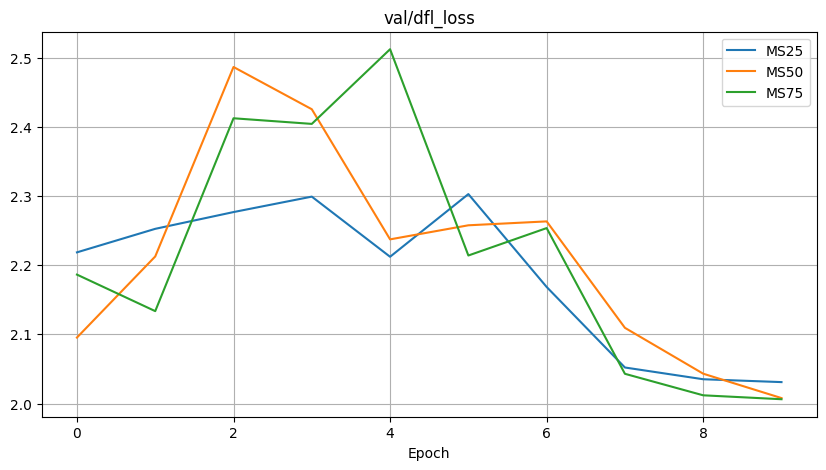

In [ ]:
plot_model_metrics(list(results.items()),
                   ['time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

Стандартный scale=0.5 показывает наиболее стабильный результат. Возможно применим multi-scale training на более поздних этапах обучения, но сейчас это не дает никакого прироста метрики.

### Выбираем размер модели

Рассмотрим 3 размера модели (n, s, m) и оценим их как по основной метрике/лоссу, так и по времени - для этого будем использовать метрику FPS.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        A.OneOf([
            A.ToGray(p=1.0),
            A.ChannelDropout(p=1.0)
        ], p=1.0),
        A.OneOf([
            A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=1.0),
            A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05, p=1.0),
            A.RandomGamma(gamma_limit=(85, 115), p=1.0),
            A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=10, p=1.0),
            A.PlanckianJitter(p=1.0),
        ], p=1.0)
    ], p=0.15),
    # ---
    A.OneOf([
        A.RandomSunFlare(src_radius=200, p=1.0),
        A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), p=1.0),
    ], p=0.25)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']), seed=MANUAL_SEED)

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


In [ ]:
model_yolo8s = YOLO('yolov8s.pt')
model_yolo8s.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=10,
    imgsz=TARGET_SIZE,
    batch=32,
    device=0,
    save=True,
    cache=False,
    project='/content/saves',
    name='YOLO8s',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    momentum=0.9,
    cos_lr=True,
    scale=0.50
)

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.9, mosaic=1.0, multi_scale=False, name=YOLO8s, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=1

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ebce81a2f90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
model_yolo8m = YOLO('yolov8m.pt')
model_yolo8m.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=10,
    imgsz=TARGET_SIZE,
    batch=32,
    device=0,
    save=True,
    cache=False,
    project='/content/saves',
    name='YOLO8m',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    momentum=0.9,
    cos_lr=True,
    scale=0.50
)

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8m.pt, momentum=0.9, mosaic=1.0, multi_scale=False, name=YOLO8m, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=1

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ebce816e870>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
model_yolo8n = YOLO("/content/saves/MS50/weights/last.pt")

results = {}

zip_folder('YOLO8s')
zip_folder('YOLO8m')
results['YOLO8n'] = pd.read_csv("/content/saves/MS50/results.csv")
results['YOLO8s'] = pd.read_csv("/content/saves/YOLO8s/results.csv")
results['YOLO8m'] = pd.read_csv("/content/saves/YOLO8m/results.csv")

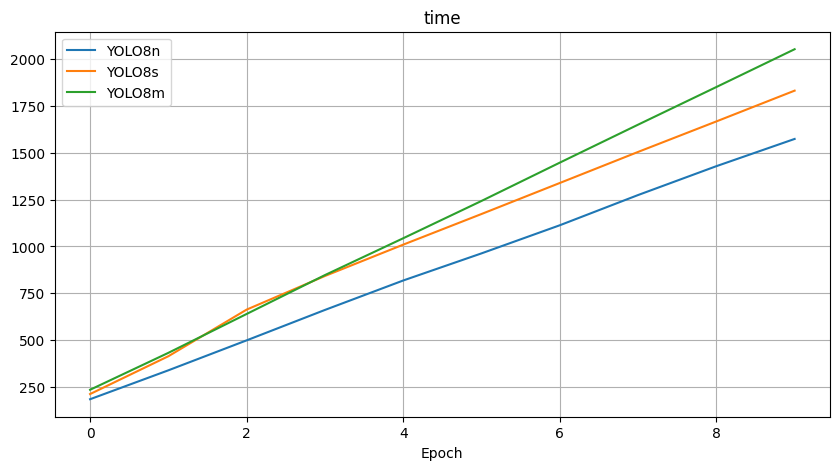

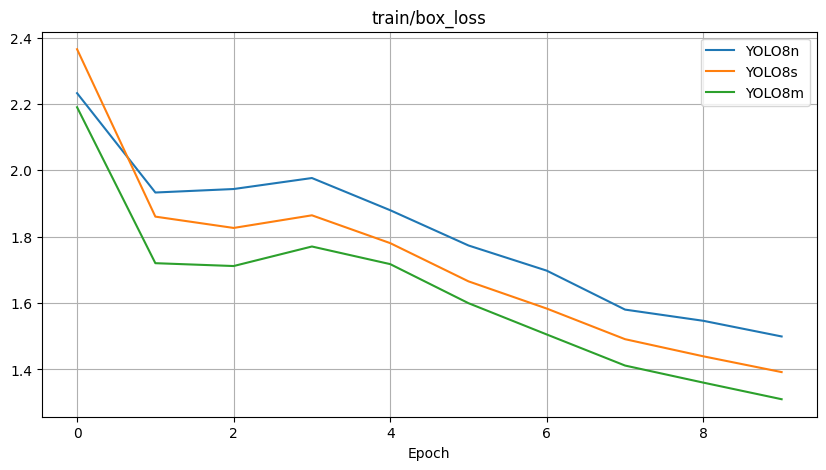

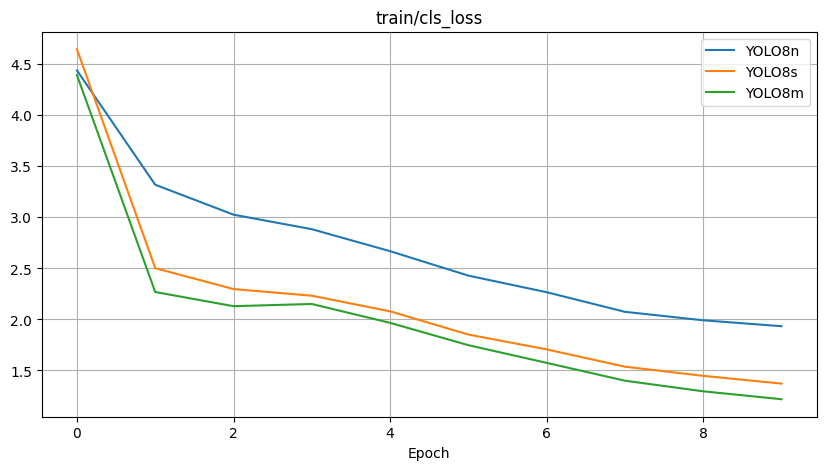

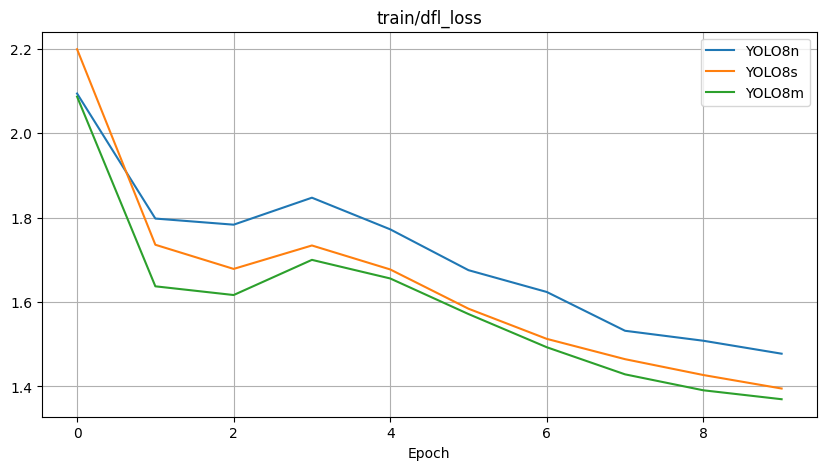

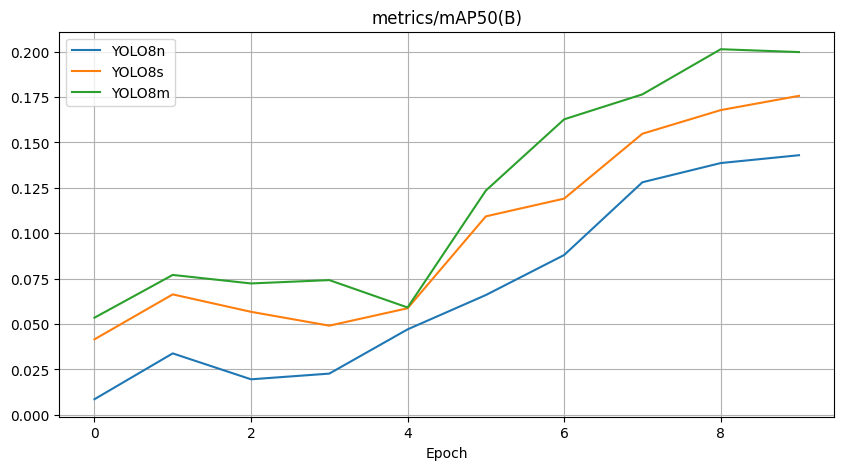

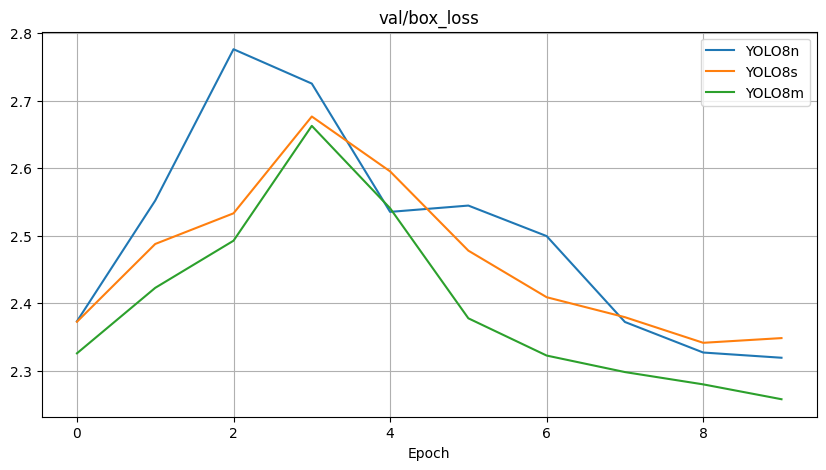

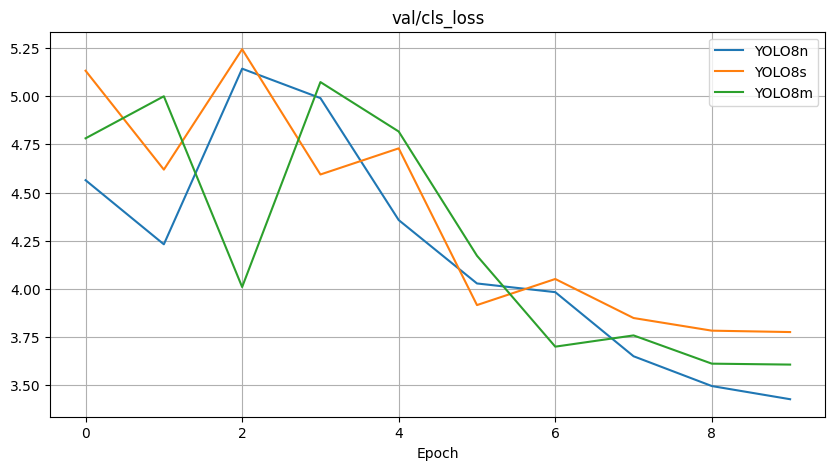

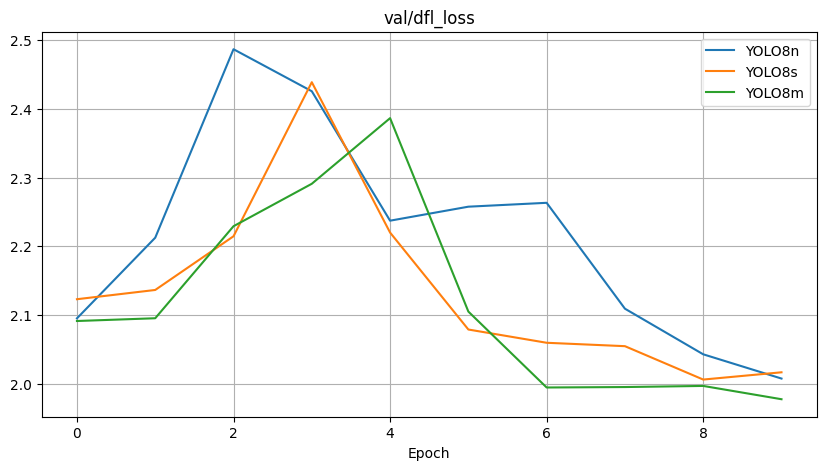

In [ ]:
plot_model_metrics(list(results.items()),
                   ['time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

In [ ]:
pic = TEST_DIRECTORY / "images/China_Drone_000040.jpg"

for model, name in [(model_yolo8n, "YOLO8n"),
                    (model_yolo8s, "YOLO8s"),
                    (model_yolo8m, "YOLO8m")]:
    sum = 0
    n = 100
    for i in range(n):
        temp = model.predict(pic, imgsz=640, device=0, half=True)
        s = temp[0].speed["inference"]
        sum += s
    res[name] = 1000 / (sum / n)


image 1/1 /content/data/RDD_SPLIT/test/images/China_Drone_000040.jpg: 640x640 1 longitudinal crack, 20.4ms
Speed: 14.4ms preprocess, 20.4ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/data/RDD_SPLIT/test/images/China_Drone_000040.jpg: 640x640 1 longitudinal crack, 16.5ms
Speed: 4.6ms preprocess, 16.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/data/RDD_SPLIT/test/images/China_Drone_000040.jpg: 640x640 1 longitudinal crack, 23.0ms
Speed: 4.4ms preprocess, 23.0ms inference, 7.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/data/RDD_SPLIT/test/images/China_Drone_000040.jpg: 640x640 1 longitudinal crack, 18.1ms
Speed: 4.9ms preprocess, 18.1ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/data/RDD_SPLIT/test/images/China_Drone_000040.jpg: 640x640 1 longitudinal crack, 27.9ms
Speed: 11.6ms preprocess, 27.9ms inference, 2.2ms postprocess per image

In [ ]:
print(f"\nFPS YOLO8n: {res["YOLO8n"]:.2f}")
print(f"FPS YOLO8s: {res["YOLO8s"]:.2f}")
print(f"FPS YOLO8m: {res["YOLO8m"]:.2f}")


FPS YOLO8n: 61.86
FPS YOLO8s: 66.39
FPS YOLO8m: 44.60


Как мы можем наблюдать, версия S работает даже быстрее на инференсе чем версия N, при этом превосходя ее по метрикам. Однако, почти по всем показателям версия M лучше (лосс, метрика), что было ожидаемо.

При этом, если рассматривать FPS и учитывать специфику нашей задачи, нам достаточно FPS~30, поэтому даже при использовании большей модели у нас есть запас.

Учитывая эти умозаключения, можно сделать вывод, что модель размера M нам подходит идеально.

### Выбираем версию модели

YOLOv8m vs YOLO11m.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        A.OneOf([
            A.ToGray(p=1.0),
            A.ChannelDropout(p=1.0)
        ], p=1.0),
        A.OneOf([
            A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=1.0),
            A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05, p=1.0),
            A.RandomGamma(gamma_limit=(85, 115), p=1.0),
            A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=10, p=1.0),
            A.PlanckianJitter(p=1.0),
        ], p=1.0)
    ], p=0.15),
    # ---
    A.OneOf([
        A.RandomSunFlare(src_radius=200, p=1.0),
        A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), p=1.0),
    ], p=0.25)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']), seed=MANUAL_SEED)

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


In [ ]:
model_yolo11m = YOLO('yolo11m.pt')
model_yolo11m.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=10,
    imgsz=TARGET_SIZE,
    device=0,
    save=True,
    cache=False,
    project='/content/saves',
    name='YOLO11m',
    exist_ok=True,
    pretrained=True,
    plots=True,
    fraction=0.1,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    momentum=0.9,
    cos_lr=True,
    scale=0.50,
    # не хватает VRAM, поэтому пришлось уменьшить размер батча
    batch=16
)

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=0.1, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.9, mosaic=1.0, multi_scale=False, name=YOLO11m, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ec9461c8ce0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
model_yolo8n = YOLO("/content/saves/YOLO8m/weights/last.pt")

results = {}

zip_folder('YOLO11m')
results['YOLO11m'] = pd.read_csv("/content/saves/YOLO11m/results.csv")
results['YOLO8m'] = pd.read_csv("/content/saves/YOLO8m/results.csv")

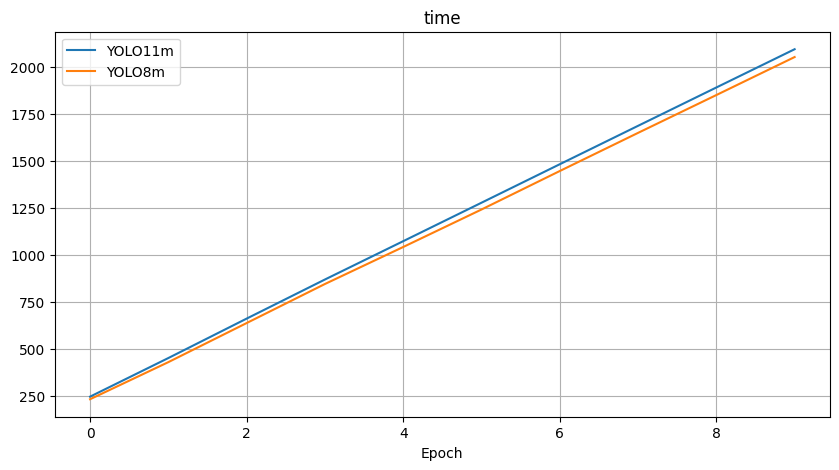

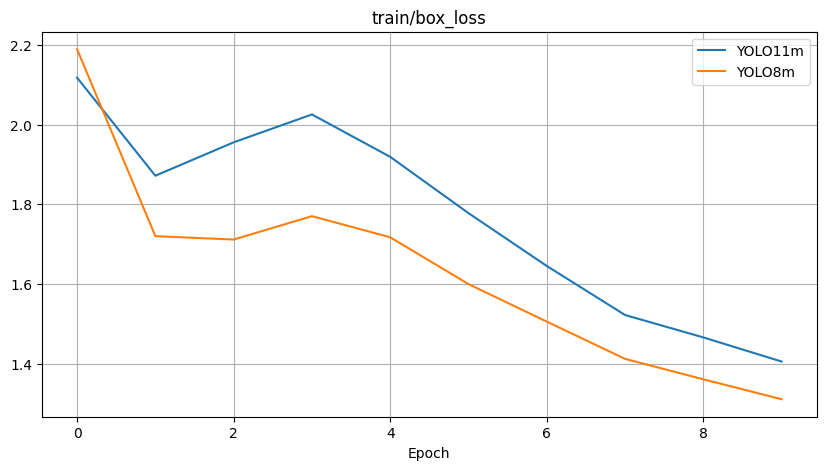

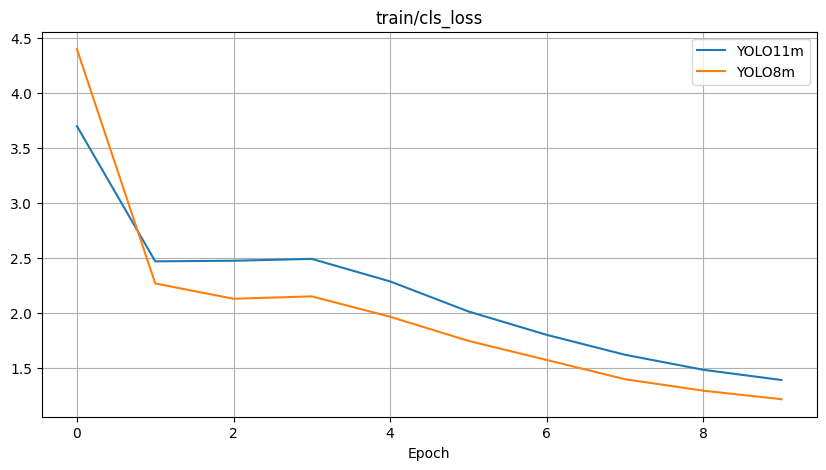

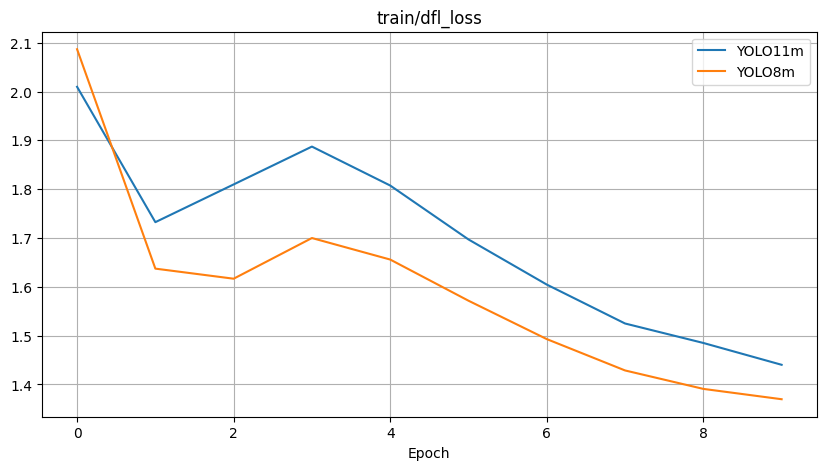

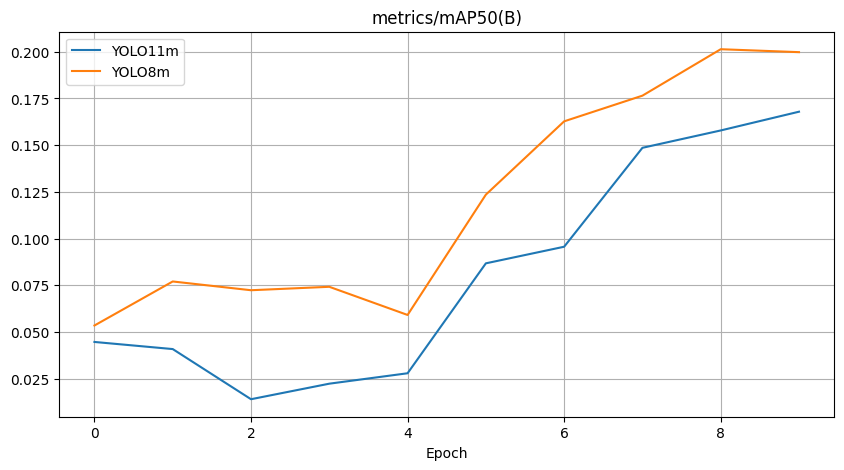

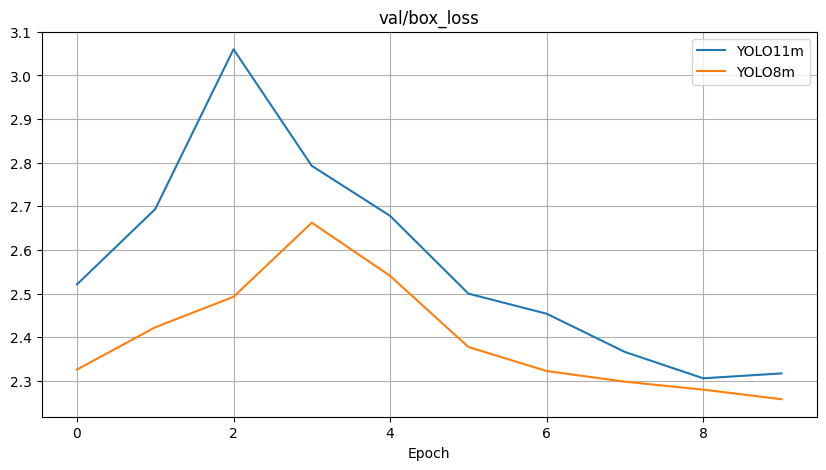

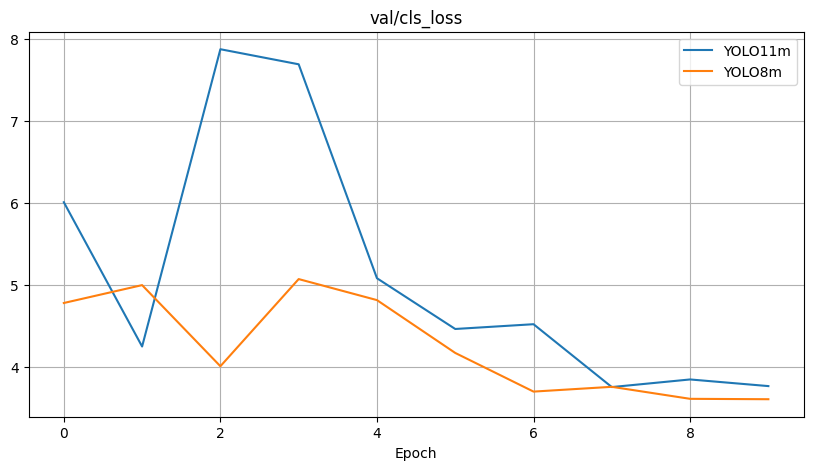

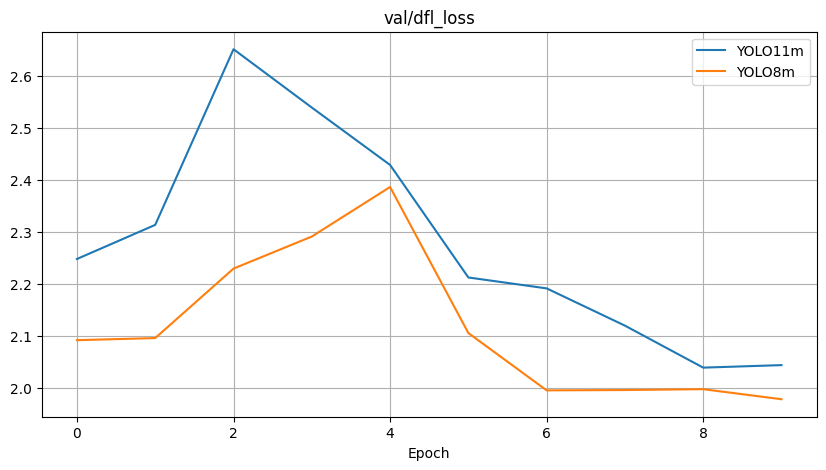

In [ ]:
plot_model_metrics(list(results.items()),
                   ['time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

Мы видим результаты для версии 11 хуже по всем параметрам. Это могло произойти по следующим вероятным причинам:

- Изначально настройки подбирались для 8 версии;
- Обучение на подвыборке --> более легкая модель лучше обобщает;
- Также сама структура 8ой версии может больше подходить под данные.

В любом случае, т.к. мы не видим более хороших результатов для 11 версии, а также она потребляет гораздо больше ресурсов (так что batch size приходится уменьшать) чем 8 версия, то решено оставить последнюю.

### Tuning

Подбираем гиперпараметры.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        A.OneOf([
            A.ToGray(p=1.0),
            A.ChannelDropout(p=1.0)
        ], p=1.0),
        A.OneOf([
            A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=1.0),
            A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05, p=1.0),
            A.RandomGamma(gamma_limit=(85, 115), p=1.0),
            A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=10, p=1.0),
            A.PlanckianJitter(p=1.0),
        ], p=1.0)
    ], p=0.15),
    # ---
    A.OneOf([
        A.RandomSunFlare(src_radius=200, p=1.0),
        A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), p=1.0),
    ], p=0.25)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']), seed=MANUAL_SEED)

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


In [ ]:
hyp_yaml = "/content/hyp_seed.yaml"

# гиперпараметры взяты из тех, которые YOLO установила для уже обучавшейся модели 8m
args = '''
lr0: 0.01
lrf: 0.01
momentum: 0.9
weight_decay: 0.0005
warmup_epochs: 3.0
warmup_momentum: 0.8
warmup_bias_lr: 0.1
box: 7.5
cls: 0.5
dfl: 1.5'''

with open(hyp_yaml, "w") as f:
    f.write(args)

In [ ]:
model_yolo8m = YOLO('yolov8m.pt')

model_yolo8m.tune(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=3,
    imgsz=TARGET_SIZE,
    batch=32,
    device=0,
    project='/content/saves',
    name='Tuning',
    fraction=0.1,
    half=True,
    optimizer="SGD",
    cos_lr=True,
    scale=0.50,
    # ---
    iterations=8,
    verbose=True
)

Tuner: Initialized Tuner instance with 'tune_dir=/content/saves/Tuning2'
Tuner: 💡 Learn about tuning at https://docs.ultralytics.com/guides/hyperparameter-tuning
Tuner: Starting iteration 1/8 with hyperparameters: {'lr0': 0.01, 'lrf': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'box': 7.5, 'cls': 0.5, 'dfl': 1.5, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, 'degrees': 0.0, 'translate': 0.1, 'scale': 0.5, 'shear': 0.0, 'perspective': 0.0, 'flipud': 0.0, 'fliplr': 0.5, 'bgr': 0.0, 'mosaic': 1.0, 'mixup': 0.0, 'cutmix': 0.0, 'copy_paste': 0.0, 'close_mosaic': 10}
Saved /content/saves/Tuning2/tune_scatter_plots.png
Saved /content/saves/Tuning2/tune_fitness.png

Tuner: 1/8 iterations complete ✅ (982.61s)
Tuner: Results saved to /content/saves/Tuning2
Tuner: Best fitness=0.05013 observed at iteration 1
Tuner: Best fitness metrics are {'metrics/precision(B)': 0.24088, 'metrics/recall(B)': 0.14143, 'metrics/mAP50(B)': 0.10476, 'metrics/mAP50-95

lr0: 0.00843  
lrf: 0.00731  
momentum: 0.937  
weight_decay: 0.00034  
warmup_epochs: 4.45013  
warmup_momentum: 0.87311  
box: 12.87368  
cls: 0.56969  
dfl: 1.63508

## Model training

Финальное обучение модели на полном датасете.

In [ ]:
TARGET_SIZE = 640

transform = A.Compose([
    A.BBoxSafeRandomCrop(p=0.3),
    A.LongestMaxSize(max_size=TARGET_SIZE, interpolation=cv2.INTER_LINEAR, p=1.0),
    A.PadIfNeeded(
        min_height=TARGET_SIZE,
        min_width=TARGET_SIZE,
        border_mode=cv2.BORDER_CONSTANT,
        p=1.0,
        fill=(114, 114, 114)
    ),
    A.HorizontalFlip(p=0.5),
    # ---
    A.OneOf([
        A.CoarseDropout(num_holes_range=(1, 2), fill=0, p=1.0),
        A.GridDropout(ratio=0.3, p=1.0),
    ], p=0.2),
    # ---
    A.OneOf([
        A.OneOf([
            A.ToGray(p=1.0),
            A.ChannelDropout(p=1.0)
        ], p=1.0),
        A.OneOf([
            A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=1.0),
            A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05, p=1.0),
            A.RandomGamma(gamma_limit=(85, 115), p=1.0),
            A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=10, p=1.0),
            A.PlanckianJitter(p=1.0),
        ], p=1.0)
    ], p=0.15),
    # ---
    A.OneOf([
        A.RandomSunFlare(src_radius=200, p=1.0),
        A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), p=1.0),
    ], p=0.25)
],
bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']), seed=MANUAL_SEED)

custom_albumentations_transforms = CustomAlbumentations(
    transform,
    contains_spatial=True
)

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
path_to_results = "/content/drive/MyDrive/Results"
model_yolo8m_full = YOLO('yolov8m.pt')
model_yolo8m_full.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=10,
    imgsz=TARGET_SIZE,
    device=0,
    save=True,
    cache=False,
    project=path_to_results,
    name='YOLO8m_Full',
    exist_ok=False,
    pretrained=True,
    plots=True,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    cos_lr=True,
    scale=0.50,
    batch=32,
    # ---
    lr0=0.00843,
    lrf=0.00731,
    momentum=0.937,
    weight_decay=0.00034,
    warmup_epochs=4.45013,
    warmup_momentum=0.87311,
    box=12.87368,
    cls=0.56969,
    dfl=1.63508
)

Ultralytics 8.3.236 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=12.87368, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.56969, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.63508, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.00843, lrf=0.00731, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=YOLO8m_Full, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=100, perspect

In [ ]:
path_to_results = "/content/drive/MyDrive/Results"
model_yolo8m_full = YOLO(path_to_results + '/YOLO8m_Full/weights/last.pt')
model_yolo8m_full.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=10,
    imgsz=TARGET_SIZE,
    device=0,
    save=True,
    cache=False,
    project=path_to_results,
    name='YOLO8m_Full',
    exist_ok=False,
    pretrained=True,
    plots=True,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    cos_lr=True,
    scale=0.50,
    batch=32,
    # ---
    lr0=0.00843,
    lrf=0.00731,
    momentum=0.937,
    weight_decay=0.00034,
    warmup_epochs=4.45013,
    warmup_momentum=0.87311,
    box=12.87368,
    cls=0.56969,
    dfl=1.63508,
    # ---
    resume=True
)

Ultralytics 8.3.237 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=12.87368, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.56969, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.63508, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.00843, lrf=0.00731, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/drive/MyDrive/Results/YOLO8m_Full/weights/last.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=YOLO8m_Full, nbs=64, nms=False, opset=None, optimize=False, optimize

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7844114d9970>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

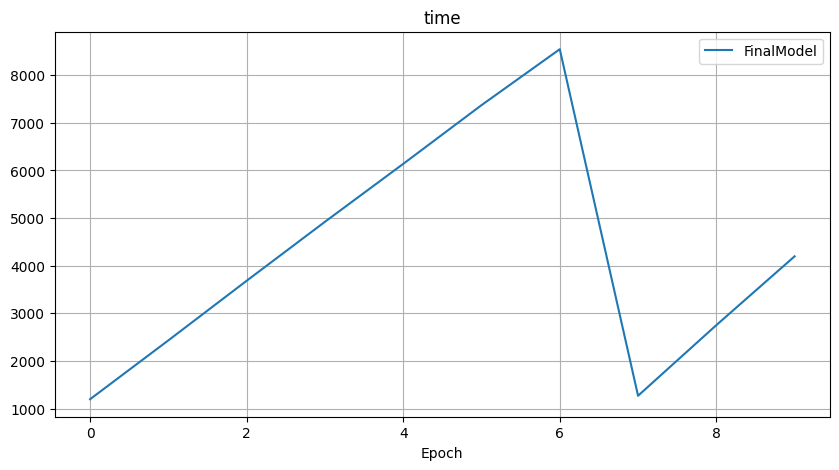

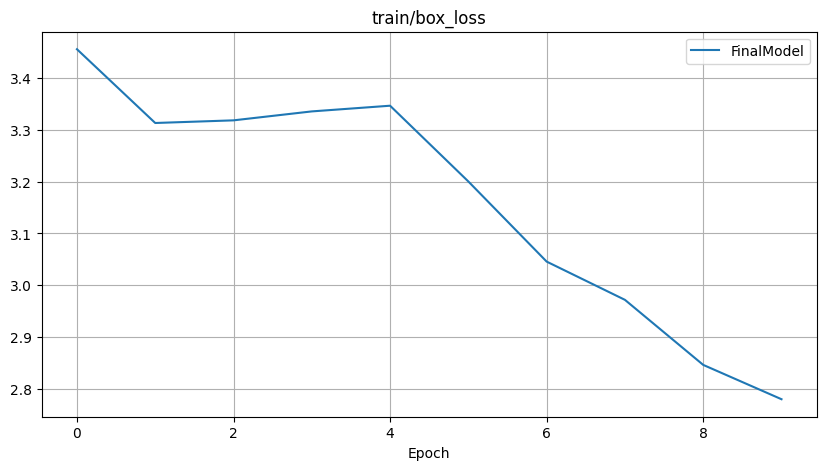

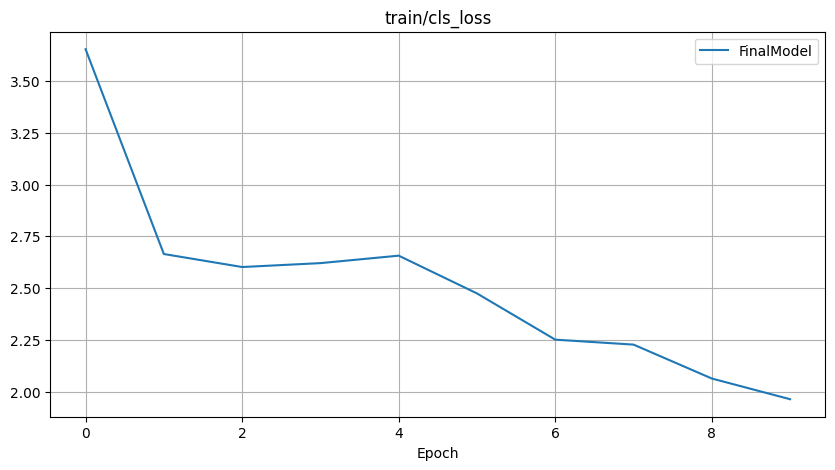

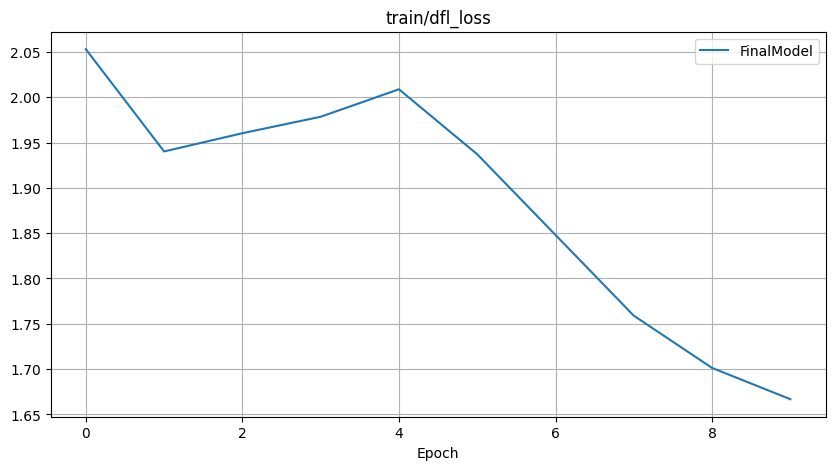

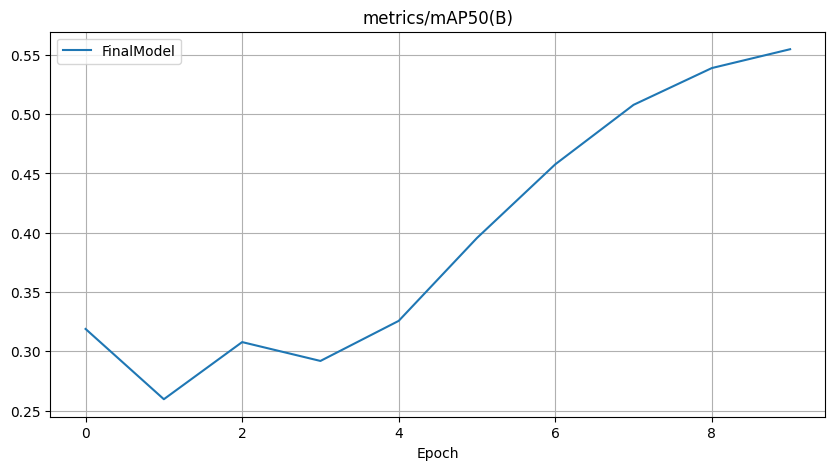

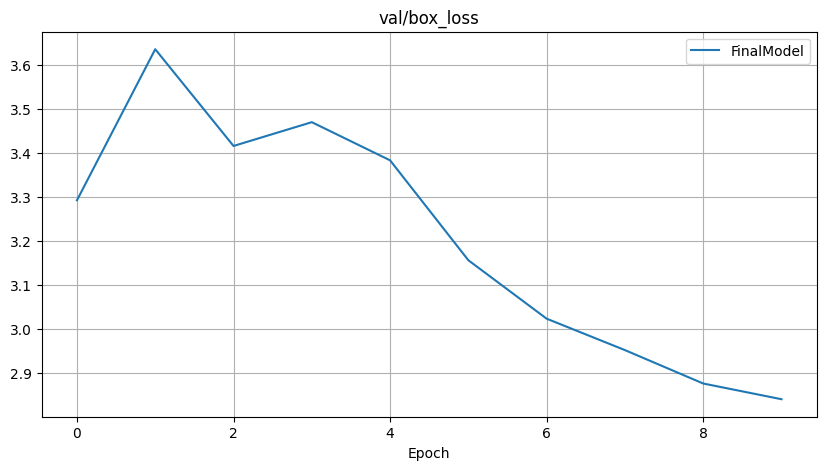

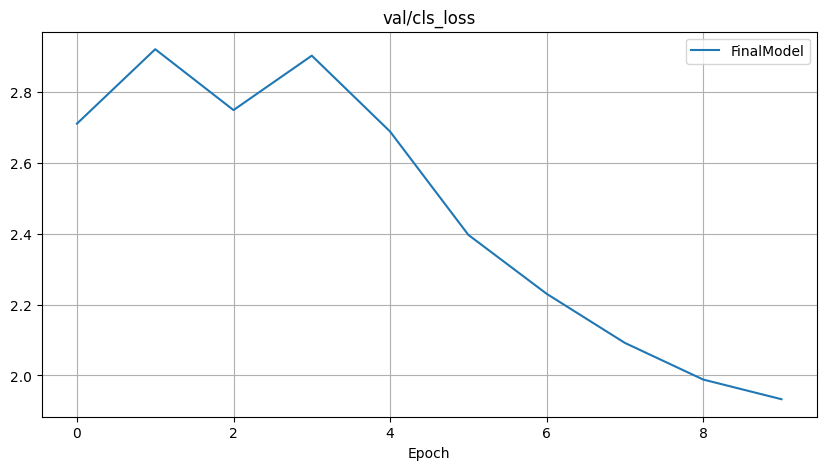

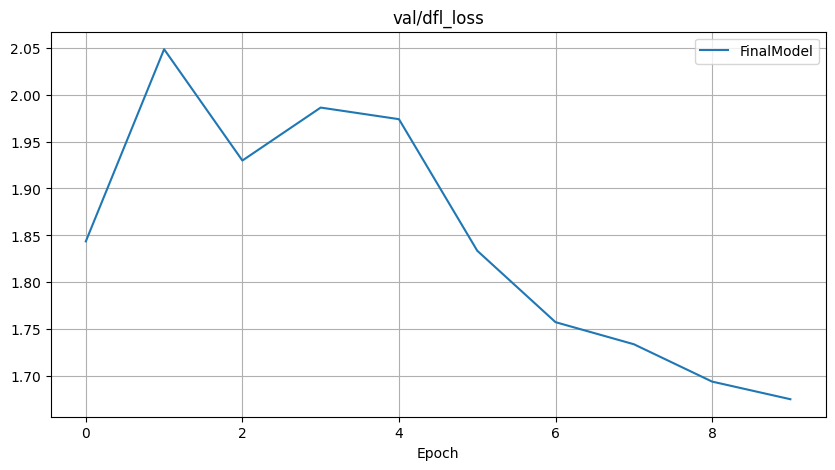

In [ ]:
results = pd.read_csv(path_to_results + "/YOLO8m_Full/results.csv")
plot_model_metrics([('FinalModel', results)],
                   ['time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

In [ ]:
model_yolo8m_full.val(data=MAIN_DIRECTORY / "rdd2022.yaml", imgsz=TARGET_SIZE, split="test")

Ultralytics 8.3.237 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,842,655 parameters, 0 gradients, 78.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 36.9±30.6 MB/s, size: 387.3 KB)
val: Scanning /content/data/RDD_SPLIT/test/labels... 5758 images, 1790 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 5758/5758 463.0it/s 12.4s
val: New cache created: /content/data/RDD_SPLIT/test/labels.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 360/360 2.1it/s 2:52
                   all       5758       9675       0.59       0.53      0.547       0.29
    longitudinal crack       2080       3925      0.581      0.486       0.51      0.277
      transverse crack       1118       1675      0.521      0.525      0.507      0.243
       alligator crack       1214       1537      0.644      0.558      0.607      0.315
      other corruption       1100       1587      0.592      0.

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x784428bee5a0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

Пока метрика слишком низкая, продолжим обучение модели. Также исходя из графиков, потенциал присутствует.

In [ ]:
path_to_results = "/content/drive/MyDrive/Results"
model_yolo8m_full = YOLO(path_to_results + '/YOLO8m_Full/weights/last.pt')
model_yolo8m_full.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=30,
    imgsz=TARGET_SIZE,
    device=0,
    save=True,
    cache=False,
    project=path_to_results,
    name='YOLO8m_Full',
    exist_ok=False,
    pretrained=True,
    plots=True,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    cos_lr=True,
    scale=0.50,
    batch=32,
    # ---
    lr0=0.00843,
    lrf=0.00731,
    momentum=0.937,
    weight_decay=0.00034,
    warmup_epochs=4.45013,
    warmup_momentum=0.87311,
    box=12.87368,
    cls=0.56969,
    dfl=1.63508,
)

Ultralytics 8.3.237 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=12.87368, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.56969, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.63508, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.00843, lrf=0.00731, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/drive/MyDrive/Results/YOLO8m_Full/weights/last.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=YOLO8m_Full3, nbs=64, nms=False, opset=None, optimize=False, optimiz

In [ ]:
path_to_results = "/content/drive/MyDrive/Results"
model_yolo8m_full = YOLO(path_to_results + '/YOLO8m_Full/weights/last.pt')
model_yolo8m_full.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=30,
    imgsz=TARGET_SIZE,
    device=0,
    save=True,
    cache=False,
    project=path_to_results,
    name='YOLO8m_Full',
    exist_ok=False,
    pretrained=True,
    plots=True,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    cos_lr=True,
    scale=0.50,
    batch=32,
    # ---
    lr0=0.00843,
    lrf=0.00731,
    momentum=0.937,
    weight_decay=0.00034,
    warmup_epochs=4.45013,
    warmup_momentum=0.87311,
    box=12.87368,
    cls=0.56969,
    dfl=1.63508,
    # ---
    resume=True
)

Ultralytics 8.3.237 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=12.87368, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.56969, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.63508, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.00843, lrf=0.00731, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/drive/MyDrive/Results/YOLO8m_Full/weights/last.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=YOLO8m_Full3, nbs=64, nms=False, opset=None, optimize=False, optimiz

In [ ]:
path_to_results = "/content/drive/MyDrive/Results"
model_yolo8m_full = YOLO(path_to_results + '/YOLO8m_Full/weights/last.pt')
model_yolo8m_full.train(
    data=f'{MAIN_DIRECTORY}/rdd2022.yaml',
    epochs=30,
    imgsz=TARGET_SIZE,
    device=0,
    save=True,
    cache=False,
    project=path_to_results,
    name='YOLO8m_Full',
    exist_ok=False,
    pretrained=True,
    plots=True,
    trainer=partial(CustomTrainer, custom_albumentations_transforms=custom_albumentations_transforms),
    half=True,
    optimizer="SGD",
    cos_lr=True,
    scale=0.50,
    batch=32,
    # ---
    lr0=0.00843,
    lrf=0.00731,
    momentum=0.937,
    weight_decay=0.00034,
    warmup_epochs=4.45013,
    warmup_momentum=0.87311,
    box=12.87368,
    cls=0.56969,
    dfl=1.63508,
    # ---
    resume=True
)

Ultralytics 8.3.237 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=12.87368, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.56969, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/data/RDD_SPLIT/rdd2022.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.63508, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=True, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.00843, lrf=0.00731, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/drive/MyDrive/Results/YOLO8m_Full/weights/last.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=YOLO8m_Full3, nbs=64, nms=False, opset=None, optimize=False, optimiz

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7eccb3fff020>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
model_yolo8m_full.val(data=MAIN_DIRECTORY / "rdd2022.yaml", imgsz=TARGET_SIZE, split="test")

Ultralytics 8.3.237 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,842,655 parameters, 0 gradients, 78.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 37.7±37.0 MB/s, size: 389.8 KB)
val: Scanning /content/data/RDD_SPLIT/test/labels... 5758 images, 1790 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 5758/5758 294.1it/s 19.6s
val: New cache created: /content/data/RDD_SPLIT/test/labels.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 360/360 1.7it/s 3:26
                   all       5758       9675      0.658      0.578      0.621      0.339
    longitudinal crack       2080       3925      0.668      0.535      0.587      0.331
      transverse crack       1118       1675      0.624      0.548      0.579      0.296
       alligator crack       1214       1537      0.681      0.621      0.678      0.361
      other corruption       1100       1587      0.672      0.

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ecd35465940>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
results_1_10 = pd.read_csv("/content/results_1_1_10.csv")
results_11_23 = pd.read_csv("/content/results_2_1_13.csv")
results_24_37 = pd.read_csv("/content/results_2_14_27.csv")
results_38_40 = pd.read_csv("/content/results_2_28_30.csv")
results_11_23['epoch'] += 10
results_24_37['epoch'] += 10
results_38_40['epoch'] += 10
results = pd.concat((results_1_10, results_11_23, results_24_37, results_38_40))
results.reset_index(drop=True, inplace=True)
results

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,1195.78,3.45621,3.65334,2.05301,0.42596,0.35065,0.31891,0.14926,3.29262,2.71154,1.84365,0.079447,0.001892,0.001892
1,2,2431.81,3.31359,2.66446,1.94018,0.37516,0.30390,0.25966,0.11419,3.63602,2.92181,2.04830,0.058778,0.003695,0.003695
2,3,3683.65,3.31871,2.60161,1.96032,0.43259,0.33337,0.30783,0.13797,3.41612,2.74987,1.92973,0.037753,0.005142,0.005142
3,4,4921.83,3.33600,2.62047,1.97848,0.40266,0.33603,0.29193,0.13393,3.47020,2.90362,1.98614,0.016164,0.006025,0.006025
4,5,6138.76,3.34700,2.65650,2.00881,0.43142,0.35788,0.32572,0.14779,3.38346,2.68924,1.97379,0.005539,0.005539,0.005539
5,6,7371.97,3.20050,2.47415,1.93706,0.49344,0.41147,0.39562,0.19564,3.15635,2.39725,1.83369,0.004246,0.004246,0.004246
6,7,8546.93,3.04564,2.25096,1.84802,0.53281,0.45559,0.45771,0.23188,3.02351,2.23082,1.75758,0.002953,0.002953,0.002953
7,8,1268.67,2.97170,2.22700,1.75896,0.57764,0.48119,0.50785,0.26090,2.95212,2.09195,1.73409,0.001786,0.001786,0.001786
8,9,2751.82,2.84595,2.06324,1.70130,0.58520,0.51455,0.53886,0.28151,2.87618,1.98848,1.69429,0.000861,0.000861,0.000861
9,10,4197.22,2.77958,1.96330,1.66677,0.60894,0.52605,0.55474,0.29470,2.84047,1.93292,1.67551,0.000266,0.000266,0.000266


In [ ]:
results.to_csv("results_40_epochs.csv")

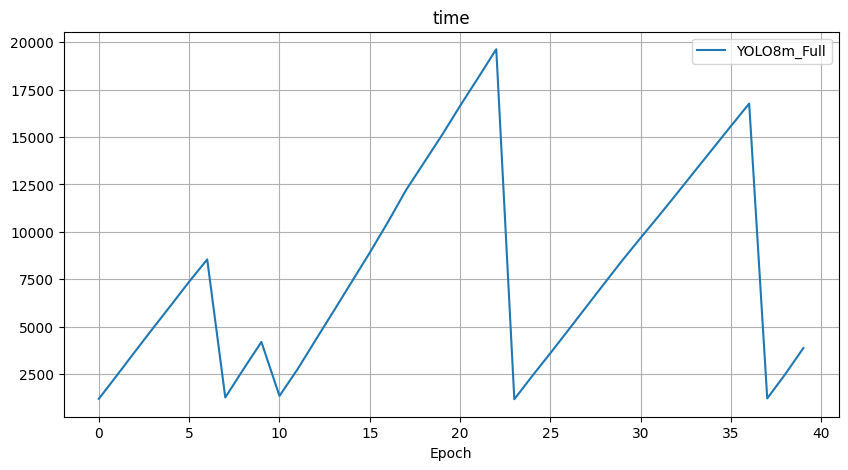

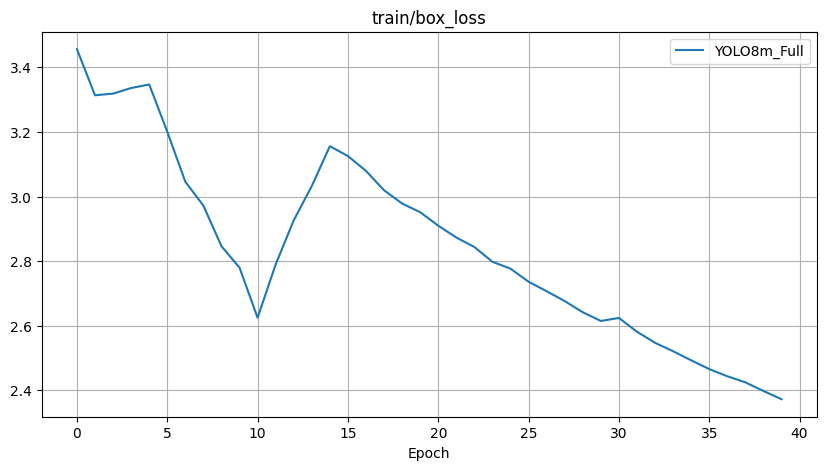

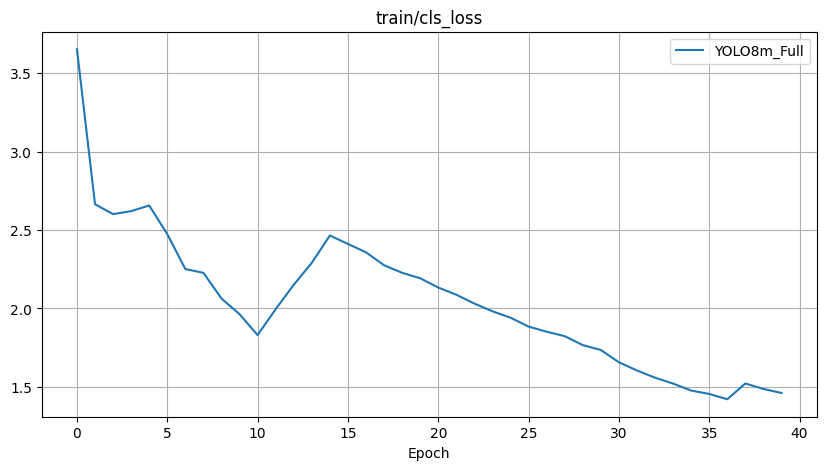

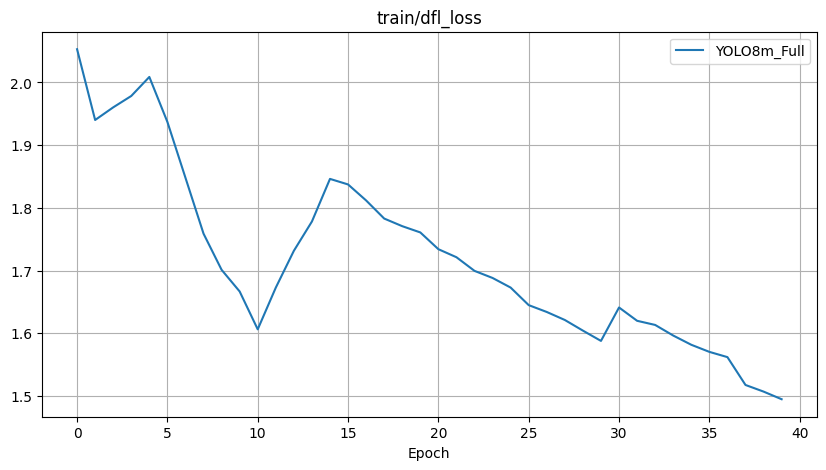

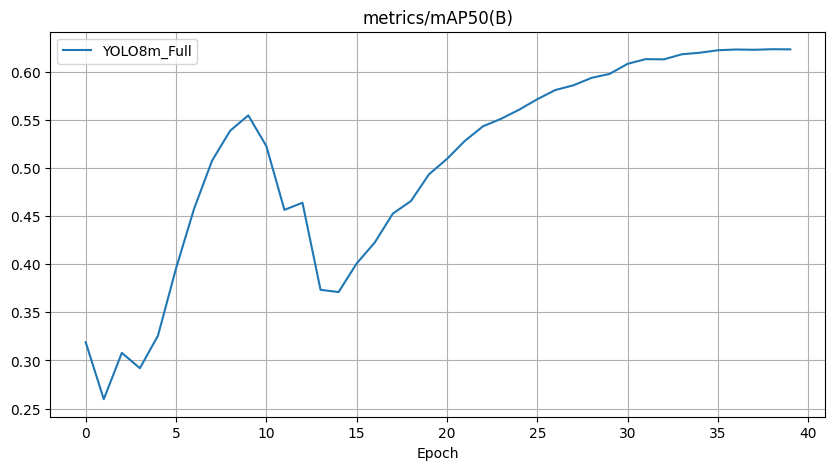

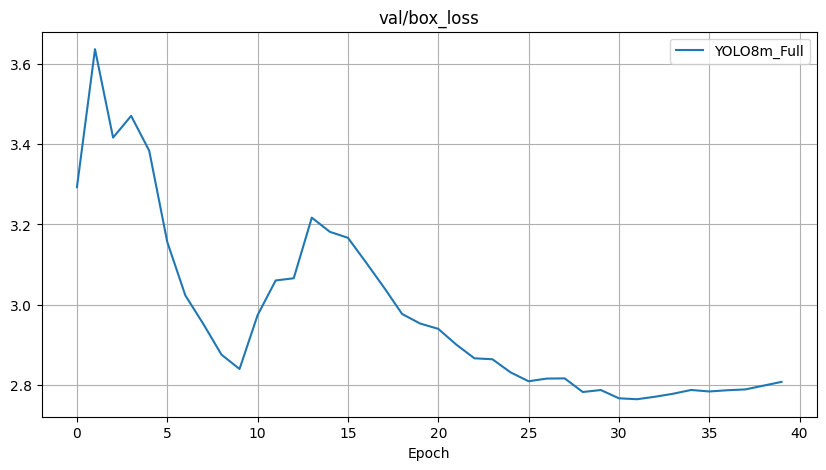

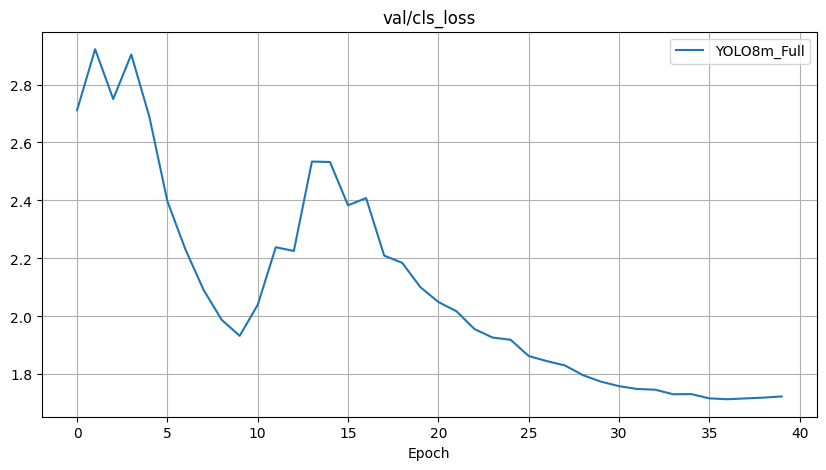

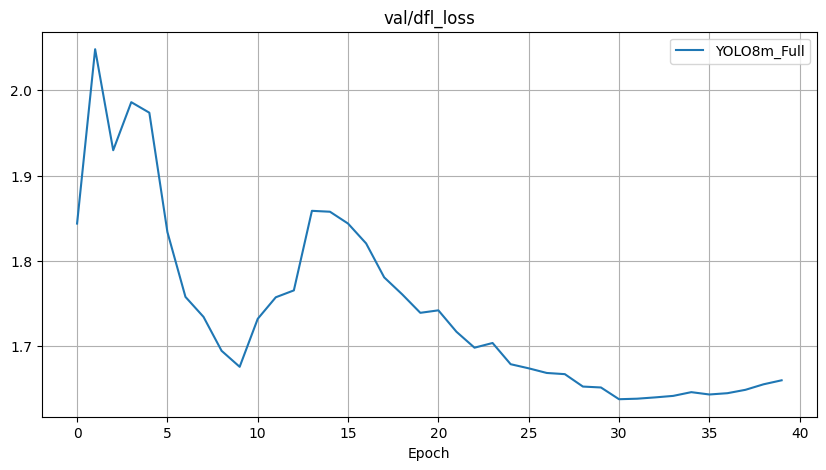

In [ ]:
plot_model_metrics([('YOLO8m_Full', results)],
                   ['time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                    'metrics/mAP50(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss'], figsize=(10,5))

In [ ]:
path_to_results = "/content/drive/MyDrive/Results"
model_final = YOLO(path_to_results + '/YOLO8m_Full3/weights/last.pt')

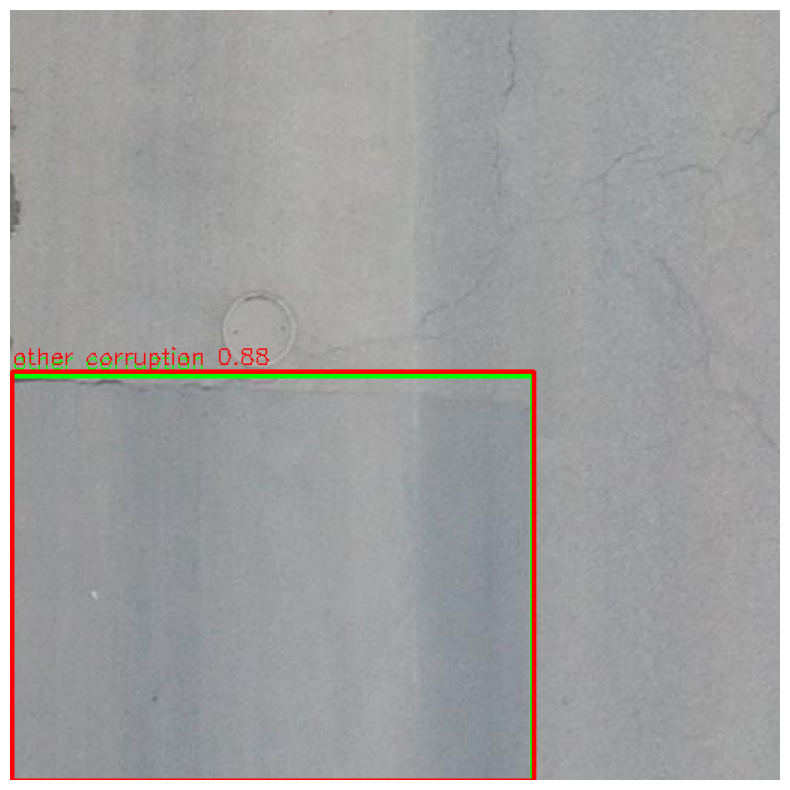

In [ ]:
show_yolo_predictions(model_final, img_path=TRAIN_DIRECTORY / "images/China_Drone_000049.jpg",
                      class_names=names, conf=0.4, show_gt=True)

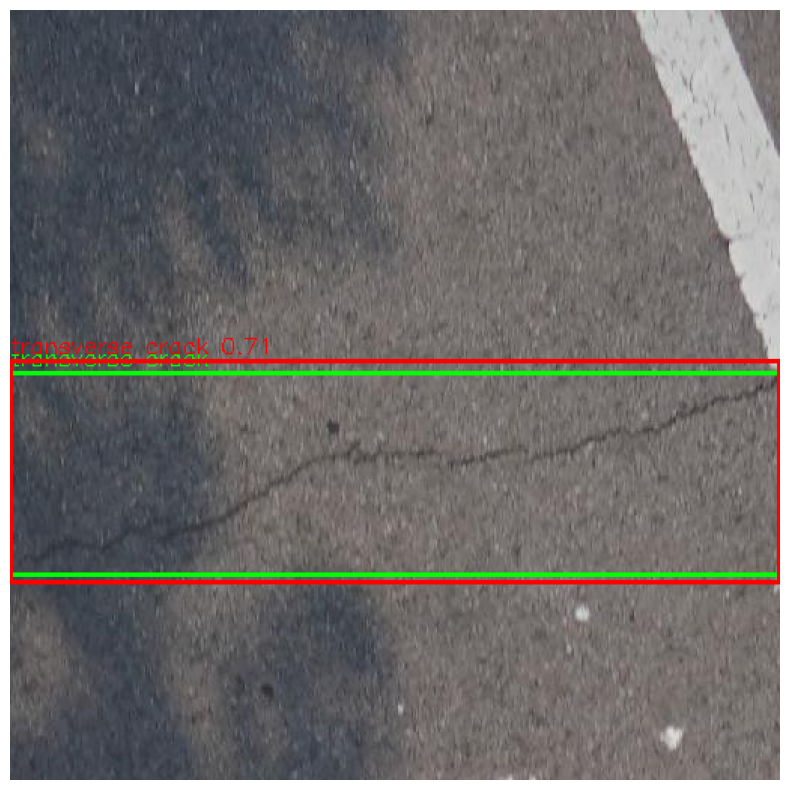

In [ ]:
show_yolo_predictions(model_final, img_path=TRAIN_DIRECTORY / "images/China_Drone_001257.jpg",
                      class_names=names, conf=0.4, show_gt=True)

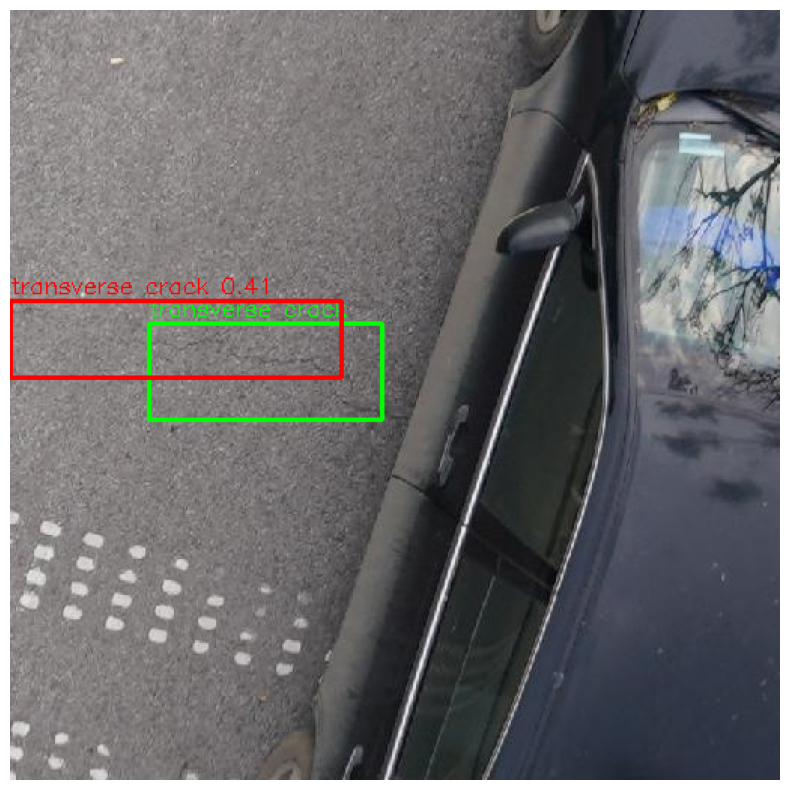

In [ ]:
show_yolo_predictions(model_final, img_path=VAL_DIRECTORY / "images/China_Drone_002362.jpg",
                      class_names=names, conf=0.4, show_gt=True)

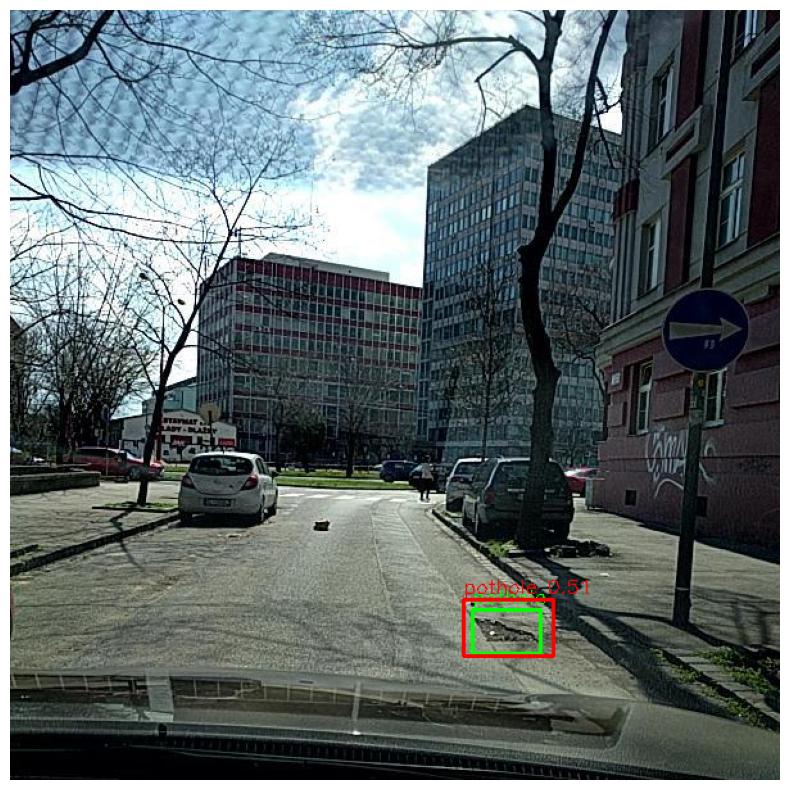

In [ ]:
show_yolo_predictions(model_final, img_path=TEST_DIRECTORY / "images/Czech_000881.jpg",
                      class_names=names, conf=0.4, show_gt=True)

In [ ]:
img = TEST_DIRECTORY / "images/Czech_000881.jpg"

# прогрев
for _ in range(10):
    model_final(img, verbose=False)

# замер
n = 100
start = time.time()

for _ in range(n):
    model_final(img, verbose=False)

end = time.time()

fps = n / (end - start)
print(f"FPS: {fps:.2f}")

FPS: 36.48


## Итог

1. С учетом технических ограничений по обучению модели, цель по метрике mAP@50 выполнена. Но при обучении на большем количество эпох (50-80) можно получить гораздо более хороший результат.
2. Цель по FPS также выполнена - наша модель способна работать в реальном времени, что подходит для задачи системы мониторинга.

**Возможные улучшения:**

1. Подобрать подходящие аугментации и параметры для других моделей (например, yolo11 / rt-detr) и обучить их.
2. Обучать на большем количестве эпох.